In [1]:
import pandas as pd
import matplotlib.pyplot as plt
plt.close('all')

/Users/khw/.pyenv/versions/3.9.1/envs/assembly/lib/python3.9/site-packages/pandas/compat/__init__.py:97: UserWarning: Could not import the lzma module. Your installed Python is incomplete. Attempting to use lzma compression will result in a RuntimeError.
  warnings.warn(msg)


In [35]:
query_201019 = pd.read_csv('./anonym_SDSNEWS_query/query_201019.csv', header=None, names=["timestamp", "employeeId", "searchType", "query"])
query_201104 = pd.read_csv('./anonym_SDSNEWS_query/query_201104.csv', header=None, names=["timestamp", "employeeId", "searchType", "query"])
query_201124 = pd.read_csv('./anonym_SDSNEWS_query/query_201124.csv', header=None, names=["timestamp", "employeeId", "searchType", "query"])
query_201218 = pd.read_csv('./anonym_SDSNEWS_query/query_201218.csv', header=None, names=["timestamp", "employeeId", "searchType", "query"])
query_201228 = pd.read_csv('./anonym_SDSNEWS_query/query_201228.csv', header=None, names=["timestamp", "employeeId", "searchType", "query"])
query_210115 = pd.read_csv('./anonym_SDSNEWS_query/query_210115.csv', header=None, names=["timestamp", "employeeId", "searchType", "query"])
query_210316 = pd.read_csv('./anonym_SDSNEWS_query/query_210316.csv', header=None, names=["timestamp", "employeeId", "searchType", "query"])
query_210329 = pd.read_csv('./anonym_SDSNEWS_query/query_210329.csv', header=None, names=["timestamp", "employeeId", "searchType", "query"])
query_210406 = pd.read_csv('./anonym_SDSNEWS_query/query_210406.csv', header=None, names=["timestamp", "employeeId", "searchType", "query"])
query_210427 = pd.read_csv('./anonym_SDSNEWS_query/query_210427.csv', header=None, names=["timestamp", "employeeId", "searchType", "query"])
query_210512 = pd.read_csv('./anonym_SDSNEWS_query/query_210512.csv', header=None, names=["timestamp", "employeeId", "searchType", "query"])
query_210531 = pd.read_csv('./anonym_SDSNEWS_query/query_210531.csv', header=None, names=["timestamp", "employeeId", "searchType", "query"])

In [200]:
query = pd.concat([query_201019, query_201104, query_201124, query_201218, query_201228, query_210115, query_210316, query_210329, query_210406, query_210427, query_210512, query_210531])
query['timestamp'] = pd.to_datetime(query['timestamp'])
# query = query.set_index('timestamp')


In [174]:
unique_ids = pd.unique(query['employeeId'])

In [201]:

gaps = pd.Series()


query.insert(4, 'gap', 0)
query.insert(5, 'cum_gap', 0)

print(query)


                timestamp employeeId searchType      query  gap  cum_gap
0     2020-10-19 00:00:10     ID3869    SCH_ALL     오늘의아이돌    0        0
1     2020-10-19 00:00:18     ID3869    SCH_TTL     오늘의아이돌    0        0
2     2020-10-19 00:00:21     ID1236    SCH_ALL        adv    0        0
3     2020-10-19 00:00:44     ID1705    SCH_ALL        월주차    0        0
4     2020-10-19 00:00:48     ID1366    SCH_ALL  Brightics    0        0
...                   ...        ...        ...        ...  ...      ...
26119 2021-05-31 05:29:06     ID5958    SCH_ALL        노트북    0        0
26120 2021-05-31 05:29:10     ID7250    SCH_ALL      결혼도움방    0        0
26121 2021-05-31 05:29:54     ID5133    SCH_ALL      신라스테이    0        0
26122 2021-05-31 05:29:57     ID5133    SCH_ALL       신화호텔    0        0
26123 2021-05-31 05:30:00     ID5133    SCH_ALL         신화    0        0

[398501 rows x 6 columns]


<ipython-input-201-5c22994d4ee2>:3: DeprecationWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  gaps = pd.Series()


In [230]:
# query['gap'] = 0
# query['cum_gap'] = False

sessions = []

for id in unique_ids:
    all_sessions = query[query['employeeId'] == id]
#     print(all_sessions['gap'])
    query.loc[query['employeeId'] == id, 'gap'] = all_sessions['timestamp'].diff()
#     print(all_sessions['gap'])
    query.loc[query['employeeId'] == id, 'cum_gap'] = query.loc[query['employeeId'] == id, 'gap'] > pd.Timedelta(minutes = 30)
    query.loc[query['employeeId'] == id, 'cum_gap'] = query.loc[query['employeeId'] == id, 'cum_gap'].apply(lambda x: 1 if x else 0).cumsum()
    grouped = all_sessions.groupby('cum_gap')     
    
    gaps = pd.concat([gaps, all_sessions['gap']])
    current_sessions = [group for group in grouped] # split all_sessions into sessions
    sessions.extend(current_sessions)
    
print(sessions[0])
print(sessions[1])
print(sessions[2])
print(sessions[-1])
print(sessions[-2])
print(sessions[-3])

(0,              timestamp employeeId searchType   query              gap cum_gap
0  2020-10-19 00:00:10     ID3869    SCH_ALL  오늘의아이돌              NaT       0
1  2020-10-19 00:00:18     ID3869    SCH_TTL  오늘의아이돌  0 days 00:00:08       0
6  2020-10-19 00:00:51     ID3869    SCH_TTL  오늘의아이돌  0 days 00:00:33       0
29 2020-10-19 00:01:40     ID3869    SCH_TTL  오늘의아이돌  0 days 00:00:49       0)
(1,                 timestamp employeeId searchType   query               gap  \
44091 2020-11-02 04:07:19     ID3869    SCH_ALL  opic등급  14 days 04:05:39   

      cum_gap  
44091       1  )
(2,                 timestamp employeeId searchType  query               gap  \
10959 2020-12-22 08:02:30     ID3869    SCH_TTL     승격  50 days 03:55:11   
10972 2020-12-22 08:03:02     ID3869    SCH_TTL     승격   0 days 00:00:32   
10979 2020-12-22 08:03:17     ID3869    SCH_ALL  승격 점수   0 days 00:00:15   
10990 2020-12-22 08:05:09     ID3869    SCH_ALL  승격 점수   0 days 00:01:52   

      cum_gap  
10959       

In [231]:
# cur_session = sessions[2]
print(len(sessions))
print(len(unique_ids))
# cur_session.groupby(cur_session["timestamp"].dt.date).size().plot()


97656
10555


In [240]:
grouped = query.groupby('employeeId')

for id, group in grouped:
    print(group)
    group.sort_values('cum_gap')
    employeeId = id
    
    filename = './s/%s.csv' % (employeeId)
    group.to_csv(filename, encoding='utf-8')
    

               timestamp employeeId searchType query  gap cum_gap
8271 2020-12-22 01:49:38        ID0    SCH_ALL    원격  NaT       0
                timestamp employeeId searchType query                gap  \
28592 2021-01-14 09:07:48        ID1    SCH_ALL   txp                NaT   
13654 2021-05-10 08:22:23        ID1    SCH_TTL  efss  115 days 23:14:35   

      cum_gap  
28592       0  
13654       1  
                timestamp employeeId searchType  query               gap  \
32171 2020-12-17 09:39:52       ID10    SCH_ALL  회사 실비               NaT   
32173 2020-12-17 09:42:38       ID10    SCH_ALL     실비   0 days 00:02:46   
32174 2020-12-17 09:43:14       ID10    SCH_ALL     실비   0 days 00:00:36   
32175 2020-12-17 09:43:46       ID10    SCH_ALL     실비   0 days 00:00:32   
746   2021-01-08 02:19:03       ID10    SCH_ALL     가방  21 days 16:35:17   
755   2021-01-08 02:20:16       ID10    SCH_ALL     가방   0 days 00:01:13   
757   2021-01-08 02:20:37       ID10    SCH_ALL     가방   0 

                timestamp employeeId searchType query              gap cum_gap
16352 2020-12-23 09:14:46    ID10101    SCH_CNT   파라솔              NaT       0
16383 2020-12-23 09:20:47    ID10101    SCH_TTL   파라솔  0 days 00:06:01       0
16385 2020-12-23 09:22:06    ID10101    SCH_TTL   파라솔  0 days 00:01:19       0
16388 2020-12-23 09:22:51    ID10101    SCH_TTL   파라솔  0 days 00:00:45       0
16390 2020-12-23 09:23:06    ID10101    SCH_TTL   파라솔  0 days 00:00:15       0
16393 2020-12-23 09:23:19    ID10101    SCH_CNT   파라솔  0 days 00:00:13       0
                timestamp employeeId searchType           query  \
11439 2021-03-24 07:49:01    ID10102    SCH_ALL            필수인력   
11445 2021-03-24 07:50:18    ID10102    SCH_CNT     사내인재공모 필수인려   
11448 2021-03-24 07:50:29    ID10102    SCH_CNT     사내인재공모 필수인력   
11450 2021-03-24 07:50:33    ID10102    SCH_TTL     사내인재공모 필수인력   
11454 2021-03-24 07:50:37    ID10102    SCH_ALL          사내인재공모   
11461 2021-03-24 07:51:38    ID10102    SCH_A

                timestamp employeeId searchType  query               gap  \
28137 2020-10-22 23:59:07    ID10193    SCH_TTL  모바일문진               NaT   
16615 2020-11-18 06:40:47    ID10193    SCH_TTL     PI  26 days 06:41:40   
50092 2020-11-23 09:09:57    ID10193    SCH_TTL     PI   5 days 02:29:10   
50099 2020-11-23 09:10:12    ID10193    SCH_TTL     PS   0 days 00:00:15   
9275  2020-12-12 00:26:06    ID10193    SCH_TTL     야구  18 days 15:15:54   
15289 2020-12-14 07:36:16    ID10193    SCH_TTL   네트워크   2 days 07:10:10   
15290 2020-12-14 07:36:29    ID10193    SCH_TTL      팀   0 days 00:00:13   
18452 2020-12-15 01:00:20    ID10193    SCH_TTL   블라인드   0 days 17:23:51   
18454 2020-12-15 01:00:44    ID10193    SCH_TTL  blind   0 days 00:00:24   
32558 2020-12-17 14:15:00    ID10193    SCH_ALL    cl4   2 days 13:14:16   
32562 2020-12-17 14:17:23    ID10193    SCH_ALL    고성과   0 days 00:02:23   
21814 2020-12-27 10:10:20    ID10193    SCH_ALL     ps   9 days 19:52:57   
21815 2020-1

               timestamp employeeId searchType  query              gap cum_gap
4423 2021-05-06 08:49:17    ID10280    SCH_ALL     자산              NaT       0
4426 2021-05-06 08:49:38    ID10280    SCH_ALL  자산 신청  0 days 00:00:21       0
4429 2021-05-06 08:49:57    ID10280    SCH_ALL    ECC  0 days 00:00:19       0
4463 2021-05-06 08:58:16    ID10280    SCH_ALL    ECC  0 days 00:08:19       0
4464 2021-05-06 08:58:18    ID10280    SCH_ALL    ECC  0 days 00:00:02       0
4465 2021-05-06 08:58:19    ID10280    SCH_ALL    ECC  0 days 00:00:01       0
4466 2021-05-06 08:58:32    ID10280    SCH_ALL    ECC  0 days 00:00:13       0
                timestamp employeeId searchType query  gap cum_gap
15188 2021-03-12 07:36:26    ID10281    SCH_ALL   장호수  NaT       0
                timestamp employeeId searchType    query               gap  \
5787  2020-10-28 07:30:29    ID10282    SCH_ALL    prods               NaT   
25000 2021-01-14 00:49:02    ID10282    SCH_ALL      end  77 days 17:18:33   


                timestamp employeeId searchType query               gap  \
26253 2020-10-30 04:32:45    ID10382    SCH_TTL    알뜰               NaT   
29443 2021-01-14 23:47:50    ID10382    SCH_ALL    통증  76 days 19:15:05   
29570 2021-01-15 00:01:06    ID10382    SCH_ALL    통증   0 days 00:13:16   
29593 2021-01-15 00:03:00    ID10382    SCH_ALL  정형외과   0 days 00:01:54   
29600 2021-01-15 00:03:28    ID10382    SCH_CNT  정형외과   0 days 00:00:28   
29606 2021-01-15 00:04:05    ID10382    SCH_CNT  정형외과   0 days 00:00:37   
29611 2021-01-15 00:04:44    ID10382    SCH_CNT  정형외과   0 days 00:00:39   
29614 2021-01-15 00:04:55    ID10382    SCH_CNT  정형외과   0 days 00:00:11   
29618 2021-01-15 00:05:11    ID10382    SCH_CNT  정형외과   0 days 00:00:16   
13392 2021-04-22 01:03:47    ID10382    SCH_ALL   시그마  97 days 00:58:36   
13963 2021-04-22 02:19:56    ID10382    SCH_TTL   시그마   0 days 01:16:09   
13965 2021-04-22 02:20:05    ID10382    SCH_TTL   횡전개   0 days 00:00:09   

      cum_gap  
26253   

                timestamp employeeId searchType        query  \
5308  2020-10-19 06:20:31    ID10479    SCH_ALL          sgp   
9018  2020-10-19 23:16:15    ID10479    SCH_ALL           이민   
24283 2020-10-22 04:01:56    ID10479    SCH_ALL         pisa   
41136 2020-10-25 23:36:11    ID10479    SCH_ALL           법원   
13228 2020-10-29 01:34:37    ID10479    SCH_ALL           수원   
41780 2020-11-02 01:18:54    ID10479    SCH_ALL          ob형   
44114 2020-11-02 04:09:06    ID10479    SCH_ALL      rethink   
44115 2020-11-02 04:09:13    ID10479    SCH_ALL  rethinkmall   
17141 2020-12-14 21:56:24    ID10479    SCH_ALL           oa   
22779 2020-12-15 08:22:21    ID10479    SCH_ALL         자산이관   
571   2020-12-21 01:03:07    ID10479    SCH_ALL           미싱   
4011  2020-12-21 06:20:26    ID10479    SCH_ALL         인센티브   
4064  2020-12-21 06:23:47    ID10479    SCH_ALL    원가절감 인센티브   
1483  2021-01-08 04:49:29    ID10479    SCH_ALL          crb   
9447  2021-01-11 00:01:40    ID10479    

                timestamp employeeId searchType   query               gap  \
1529  2021-03-09 04:05:30     ID1073    SCH_ALL      연차               NaT   
7285  2021-03-10 07:46:36     ID1073    SCH_ALL     scp   1 days 03:41:06   
7287  2021-03-10 07:47:03     ID1073    SCH_ALL     scp   0 days 00:00:27   
7289  2021-03-10 07:47:10     ID1073    SCH_ALL     scp   0 days 00:00:07   
7290  2021-03-10 07:47:12     ID1073    SCH_ALL     scp   0 days 00:00:02   
7291  2021-03-10 07:47:13     ID1073    SCH_ALL     scp   0 days 00:00:01   
7292  2021-03-10 07:47:14     ID1073    SCH_ALL     scp   0 days 00:00:01   
18795 2021-03-26 06:04:37     ID1073    SCH_ALL      폰트  15 days 22:17:23   
10402 2021-05-10 00:45:18     ID1073    SCH_ALL      도서  44 days 18:40:41   
10412 2021-05-10 00:46:48     ID1073    SCH_ALL   glims   0 days 00:01:30   
10626 2021-05-10 01:11:14     ID1073    SCH_ALL   단말 등록   0 days 00:24:26   
10644 2021-05-10 01:13:46     ID1073    SCH_ALL  e-book   0 days 00:02:32   

                timestamp employeeId searchType   query                gap  \
41684 2020-10-26 00:23:20     ID1149    SCH_ALL     사원증                NaT   
41700 2020-10-26 00:24:13     ID1149    SCH_TTL     사원증    0 days 00:00:53   
25688 2020-10-30 03:49:18     ID1149    SCH_ALL      멘토    4 days 03:25:05   
5780  2021-03-10 04:25:29     ID1149    SCH_ALL    dart  131 days 00:36:11   
13016 2021-03-12 01:08:09     ID1149    SCH_RGT     벽보고    1 days 20:42:40   
22859 2021-03-16 04:27:52     ID1149    SCH_ALL     이마트    4 days 03:19:43   
22865 2021-03-16 04:28:18     ID1149    SCH_CNT     b2e    0 days 00:00:26   
22945 2021-03-16 04:42:05     ID1149    SCH_ALL  dlakxm    0 days 00:13:47   
22946 2021-03-16 04:42:09     ID1149    SCH_ALL     이마트    0 days 00:00:04   
22948 2021-03-16 04:42:12     ID1149    SCH_ALL     이마트    0 days 00:00:03   
22950 2021-03-16 04:42:20     ID1149    SCH_ALL     이마트    0 days 00:00:08   
12566 2021-03-24 23:26:43     ID1149    SCH_ALL     변동비    8 day

                timestamp employeeId searchType      query               gap  \
20244 2020-10-21 07:16:32     ID1244    SCH_ALL        베이글               NaT   
20246 2020-10-21 07:16:52     ID1244    SCH_ALL        베이글   0 days 00:00:20   
59290 2020-11-24 05:03:48     ID1244    SCH_ALL         히터  33 days 21:46:56   
10097 2020-12-13 16:23:02     ID1244    SCH_ALL        농수로  19 days 11:19:14   
12063 2020-12-14 02:38:28     ID1244    SCH_ALL    서초사옥 주차   0 days 10:15:26   
...                   ...        ...        ...        ...               ...   
5591  2021-05-07 00:32:57     ID1244    SCH_ALL    dev-PAC   0 days 22:18:51   
5592  2021-05-07 00:33:15     ID1244    SCH_ALL    dev-PAC   0 days 00:00:18   
5642  2021-05-07 00:48:55     ID1244    SCH_ALL  녹스드라이브 설치   0 days 00:15:40   
5649  2021-05-07 00:50:41     ID1244    SCH_ALL  녹스드라이브 설치   0 days 00:01:46   
5686  2021-05-07 00:55:25     ID1244    SCH_ALL     VDI 종류   0 days 00:04:44   

      cum_gap  
20244       0  
20246  

                timestamp employeeId searchType   query               gap  \
781   2020-12-11 01:28:12     ID1334    SCH_ALL      dc               NaT   
805   2020-12-11 01:30:48     ID1334    SCH_ALL      dc   0 days 00:02:36   
807   2020-12-11 01:31:05     ID1334    SCH_ALL   dc 연금   0 days 00:00:17   
812   2020-12-11 01:32:11     ID1334    SCH_ALL   dc 연금   0 days 00:01:06   
3040  2020-12-11 06:24:25     ID1334    SCH_ALL      소검   0 days 04:52:14   
3052  2020-12-11 06:25:45     ID1334    SCH_ALL      프로   0 days 00:01:20   
3054  2020-12-11 06:26:05     ID1334    SCH_ALL      나올   0 days 00:00:20   
19187 2020-12-15 01:51:01     ID1334    SCH_ALL  senior   3 days 19:24:56   
19188 2020-12-15 01:51:04     ID1334    SCH_ALL  senior   0 days 00:00:03   
19192 2020-12-15 01:51:11     ID1334    SCH_TTL     이것만   0 days 00:00:07   
19193 2020-12-15 01:51:13     ID1334    SCH_TTL     이것만   0 days 00:00:02   
19440 2020-12-24 05:48:37     ID1334    SCH_ALL      이의   9 days 03:57:24   

                timestamp employeeId searchType   query                gap  \
24355 2020-12-16 01:36:01     ID1420    SCH_TTL     재배치                NaT   
29447 2020-12-17 04:18:15     ID1420    SCH_TTL     재배치    1 days 02:42:14   
29451 2020-12-17 04:18:28     ID1420    SCH_TTL     재배치    0 days 00:00:13   
29458 2020-12-17 04:18:50     ID1420    SCH_TTL     재배치    0 days 00:00:22   
29459 2020-12-17 04:18:56     ID1420    SCH_TTL     재배치    0 days 00:00:06   
29462 2020-12-17 04:19:00     ID1420    SCH_ALL     재배치    0 days 00:00:04   
29463 2020-12-17 04:19:03     ID1420    SCH_TTL     재배치    0 days 00:00:03   
4865  2021-03-31 02:13:25     ID1420    SCH_TTL     도어락  103 days 21:54:22   
4869  2021-03-31 02:13:58     ID1420    SCH_TTL     도어락    0 days 00:00:33   
21675 2021-04-25 23:01:30     ID1420    SCH_RGT   유머전문가   25 days 20:47:32   
21678 2021-04-25 23:01:48     ID1420    SCH_TTL   유머전문가    0 days 00:00:18   
21681 2021-04-25 23:01:58     ID1420    SCH_ALL     유전가    0 day

                timestamp employeeId searchType              query  \
17673 2020-10-21 01:00:41     ID1514    SCH_ALL               24만원   
17676 2020-10-21 01:00:50     ID1514    SCH_ALL             회사에서 돈   
17692 2020-10-21 01:02:09     ID1514    SCH_ALL               원가혁신   
17693 2020-10-21 01:02:18     ID1514    SCH_ALL               인센티브   
17702 2020-10-21 01:02:54     ID1514    SCH_ALL              회사 입금   
17704 2020-10-21 01:03:12     ID1514    SCH_ALL                 회사   
45721 2020-10-26 05:24:32     ID1514    SCH_ALL                 소검   
2659  2020-10-28 03:33:39     ID1514    SCH_ALL  version 1.8.0_192   
15062 2020-10-29 05:37:46     ID1514    SCH_ALL                사파리   
15064 2020-10-29 05:37:55     ID1514    SCH_ALL             safari   
15067 2020-10-29 05:38:11     ID1514    SCH_ALL                사파리   
15070 2020-10-29 05:38:31     ID1514    SCH_ALL             사파리 설치   
4250  2020-11-17 05:44:20     ID1514    SCH_ALL                PPL   
4253  2020-11-17 05:

                timestamp employeeId searchType    query                gap  \
8845  2020-10-19 16:02:12     ID1604    SCH_ALL      BMW                NaT   
31405 2020-10-23 06:27:44     ID1604    SCH_ALL      소개ㅓ    3 days 14:25:32   
31447 2020-10-23 06:30:38     ID1604    SCH_ALL   회사 소개서    0 days 00:02:54   
31455 2020-10-23 06:30:56     ID1604    SCH_ALL      소개서    0 days 00:00:18   
1907  2020-12-21 03:16:08     ID1604    SCH_ALL      BMW   58 days 20:45:12   
1910  2020-12-21 03:16:20     ID1604    SCH_ALL      BMW    0 days 00:00:12   
15019 2020-12-23 05:49:34     ID1604    SCH_ALL       PI    2 days 02:33:14   
15725 2021-05-11 02:39:32     ID1604    SCH_ALL  사업자등록번호  138 days 20:49:58   
8087  2021-05-25 05:23:42     ID1604    SCH_ALL       스캔   14 days 02:44:10   
8089  2021-05-25 05:23:47     ID1604    SCH_ALL       스캔    0 days 00:00:05   
8090  2021-05-25 05:23:49     ID1604    SCH_ALL       스캔    0 days 00:00:02   
8104  2021-05-25 05:26:27     ID1604    SCH_ALL   PC

                timestamp employeeId searchType         query  \
52556 2020-11-03 02:57:28     ID1689    SCH_ALL           용철이   
29152 2020-11-19 08:45:52     ID1689    SCH_ALL          전지젃점   
29155 2020-11-19 08:45:56     ID1689    SCH_ALL         전지wjr   
29156 2020-11-19 08:46:02     ID1689    SCH_ALL           전지적   
7839  2021-03-23 09:41:39     ID1689    SCH_ALL          야근수당   
7840  2021-03-23 09:41:49     ID1689    SCH_ALL       연장근무 수장   
7841  2021-03-23 09:41:54     ID1689    SCH_ALL       연장근무 수당   
23245 2021-04-26 02:30:07     ID1689    SCH_ALL          에버랜드   
23248 2021-04-26 02:30:46     ID1689    SCH_ALL          에버랜드   
23255 2021-04-26 02:31:49     ID1689    SCH_ALL          에버랜드   
23260 2021-04-26 02:33:04     ID1689    SCH_ALL          에버랜드   
23271 2021-04-26 02:34:57     ID1689    SCH_ALL          에버랜드   
23272 2021-04-26 02:35:07     ID1689    SCH_ALL          에버랜드   
2134  2021-05-06 02:28:16     ID1689    SCH_ALL    복지몰 보안프로그램   
2137  2021-05-06 02:28:36

                timestamp employeeId searchType              query  \
9683  2020-10-20 00:22:30     ID1776    SCH_RGT                오늘의   
20108 2020-10-21 07:03:54     ID1776    SCH_ALL        워드 파일 읽기 전용   
20219 2020-10-21 07:14:17     ID1776    SCH_ALL        워드 파일 읽기 전용   
20220 2020-10-21 07:14:19     ID1776    SCH_ALL        워드 파일 읽기 전용   
20221 2020-10-21 07:14:29     ID1776    SCH_ALL           워드 파일 읽기   
20224 2020-10-21 07:14:44     ID1776    SCH_ALL              워드 파일   
3296  2020-11-17 04:33:43     ID1776    SCH_ALL                 판교   
29235 2020-11-19 08:53:19     ID1776    SCH_ALL  endpoint security   
30149 2020-11-19 11:00:10     ID1776    SCH_ALL              12cmd   
30150 2020-11-19 11:00:13     ID1776    SCH_ALL                12층   
46874 2020-11-23 04:54:50     ID1776    SCH_ALL                 판교   
27049 2020-12-16 11:28:49     ID1776    SCH_ALL                GDC   
9701  2020-12-22 05:15:43     ID1776    SCH_ALL                 고모   
362   2021-03-09 01:

                timestamp employeeId searchType query              gap cum_gap
529   2021-04-20 01:25:56     ID1865    SCH_ALL  누리마루              NaT       0
590   2021-04-20 01:34:01     ID1865    SCH_ALL  누리마루  0 days 00:08:05       0
1308  2021-04-20 03:23:02     ID1865    SCH_ALL  누리마루  0 days 01:49:01       1
15368 2021-04-22 06:19:21     ID1865    SCH_ALL   ios  2 days 02:56:19       2
15377 2021-04-22 06:20:52     ID1865    SCH_ALL   ios  0 days 00:01:31       2
15379 2021-04-22 06:21:02     ID1865    SCH_ALL   ios  0 days 00:00:10       2
15380 2021-04-22 06:21:03     ID1865    SCH_ALL   ios  0 days 00:00:01       2
15381 2021-04-22 06:21:05     ID1865    SCH_ALL   ios  0 days 00:00:02       2
15387 2021-04-22 06:21:53     ID1865    SCH_ALL   ios  0 days 00:00:48       2
15389 2021-04-22 06:22:05     ID1865    SCH_ALL  ios용  0 days 00:00:12       2
                timestamp employeeId searchType            query  \
8487  2020-12-22 02:15:18     ID1866    SCH_TTL               O

                timestamp employeeId searchType   query                gap  \
13291 2020-10-29 01:38:24     ID1955    SCH_ALL      내과                NaT   
13298 2020-10-29 01:38:52     ID1955    SCH_ALL    소화불량    0 days 00:00:28   
2343  2021-01-08 07:23:38     ID1955    SCH_ALL    아이즈원   71 days 05:44:46   
10175 2021-05-25 23:14:21     ID1955    SCH_ALL     월패드  137 days 15:50:43   
10180 2021-05-25 23:14:55     ID1955    SCH_ALL  bestin    0 days 00:00:34   

      cum_gap  
13291       0  
13298       0  
2343        1  
10175       2  
10180       2  
                timestamp employeeId searchType            query  \
6022  2020-10-19 07:15:45     ID1956    SCH_ALL              빅히트   
14202 2020-10-29 03:37:57     ID1956    SCH_ALL             에버랜드   
44877 2020-11-02 05:06:27     ID1956    SCH_ALL              읍니다   
57018 2020-11-03 08:39:29     ID1956    SCH_ALL              읍니다   
4190  2020-11-17 05:38:27     ID1956    SCH_ALL              사이드   
4193  2020-11-17 05:38:43  

                timestamp employeeId searchType         query  \
7867  2020-12-22 00:53:12     ID2035    SCH_TTL            어학   
7872  2020-12-22 00:53:43     ID2035    SCH_TTL            어학   
7876  2020-12-22 00:54:04     ID2035    SCH_TTL            어학   
7881  2020-12-22 00:54:21     ID2035    SCH_TTL            어학   
7883  2020-12-22 00:54:32     ID2035    SCH_TTL          어학검정   
7884  2020-12-22 00:54:38     ID2035    SCH_ALL         어학 검정   
7887  2020-12-22 00:55:00     ID2035    SCH_TTL         어학 평가   
2597  2021-03-09 06:48:39     ID2035    SCH_CNT          secu   
2600  2021-03-09 06:48:56     ID2035    SCH_CNT  secuprint 삭제   
18664 2021-03-26 05:45:22     ID2035    SCH_TTL            자산   
18671 2021-03-26 05:45:38     ID2035    SCH_CNT         자산 등록   

                    gap cum_gap  
7867                NaT       0  
7872    0 days 00:00:31       0  
7876    0 days 00:00:21       0  
7881    0 days 00:00:17       0  
7883    0 days 00:00:11       0  
7884    0 days 

                timestamp employeeId searchType        query  \
26697 2020-10-22 08:28:54     ID2127    SCH_ALL           독감   
26698 2020-10-22 08:28:58     ID2127    SCH_ALL           독감   
26699 2020-10-22 08:29:12     ID2127    SCH_ALL           독감   
2812  2021-01-08 09:12:01     ID2127    SCH_ALL           원격   
2813  2021-01-08 09:12:17     ID2127    SCH_ALL           원격   
2866  2021-01-08 09:27:58     ID2127    SCH_ALL           원격   
2867  2021-01-08 09:29:08     ID2127    SCH_ALL           원격   
2870  2021-01-08 09:35:17     ID2127    SCH_ALL           원ㄱ   
2871  2021-01-08 09:35:22     ID2127    SCH_ALL           원격   
2773  2021-03-09 07:22:44     ID2127    SCH_ALL           연봉   
7320  2021-03-31 11:20:05     ID2127    SCH_ALL           병원   
7322  2021-03-31 11:20:21     ID2127    SCH_ALL         삼성병원   
7348  2021-03-31 11:32:53     ID2127    SCH_ALL           치과   
7354  2021-03-31 11:36:21     ID2127    SCH_ALL         삼성병원   
14856 2021-05-11 00:17:52     ID2127    

                timestamp employeeId searchType   query                gap  \
26145 2021-01-14 03:38:35     ID2219    SCH_ALL    넷플릭스                NaT   
4292  2021-05-06 08:26:51     ID2219    SCH_ALL  청약 퇴직금  112 days 04:48:16   
8555  2021-05-25 06:47:21     ID2219    SCH_ALL  ppl 금리   18 days 22:20:30   

      cum_gap  
26145       0  
4292        1  
8555        2  
               timestamp employeeId searchType query  gap cum_gap
2437 2020-12-11 05:21:49      ID222    SCH_TTL   스드스  NaT       0
                timestamp employeeId searchType         query  \
13198 2020-10-20 06:50:38     ID2220    SCH_ALL          퇴직연금   
13200 2020-10-20 06:50:47     ID2220    SCH_ALL     퇴직연금 피부양자   
13201 2020-10-20 06:50:50     ID2220    SCH_ALL          피부양자   
13204 2020-10-20 06:51:03     ID2220    SCH_ALL     퇴직연금 인적공제   
13205 2020-10-20 06:51:07     ID2220    SCH_ALL          퇴직연금   
13209 2020-10-20 06:51:21     ID2220    SCH_ALL      퇴직금 부양가족   
13215 2020-10-20 06:51:35     ID2220

                timestamp employeeId searchType    query               gap  \
50894 2020-11-23 10:58:16     ID2312    SCH_ALL     주거안정               NaT   
50896 2020-11-23 10:58:48     ID2312    SCH_ALL     주거안정   0 days 00:00:32   
50897 2020-11-23 10:59:21     ID2312    SCH_ALL     주거안정   0 days 00:00:33   
50898 2020-11-23 11:00:45     ID2312    SCH_ALL     주거안정   0 days 00:01:24   
50900 2020-11-23 11:00:52     ID2312    SCH_ALL       대출   0 days 00:00:07   
50904 2020-11-23 11:01:23     ID2312    SCH_ALL       대출   0 days 00:00:31   
50919 2020-11-23 11:02:23     ID2312    SCH_ALL       대출   0 days 00:01:00   
50922 2020-11-23 11:02:33     ID2312    SCH_ALL       대출   0 days 00:00:10   
50939 2020-11-23 11:03:31     ID2312    SCH_ALL       대출   0 days 00:00:58   
50940 2020-11-23 11:04:01     ID2312    SCH_ALL       대출   0 days 00:00:30   
50941 2020-11-23 11:04:23     ID2312    SCH_ALL       대출   0 days 00:00:22   
50942 2020-11-23 11:04:42     ID2312    SCH_ALL       연금   0 day

                timestamp employeeId searchType query              gap cum_gap
18553 2021-05-27 23:43:51     ID2402    SCH_ALL  재택근무              NaT       0
18560 2021-05-27 23:45:25     ID2402    SCH_ALL  재택근무  0 days 00:01:34       0
                timestamp employeeId searchType     query               gap  \
13310 2020-12-14 04:42:33     ID2403    SCH_ALL     k드라이브               NaT   
13313 2020-12-14 04:43:16     ID2403    SCH_ALL  k드라이브 다운   0 days 00:00:43   
23410 2020-12-15 14:29:12     ID2403    SCH_ALL      수주사업   1 days 09:45:56   
23411 2020-12-15 14:29:25     ID2403    SCH_ALL      수주소식   0 days 00:00:13   
23412 2020-12-15 14:30:25     ID2403    SCH_ALL      수주소식   0 days 00:01:00   
23413 2020-12-15 14:30:44     ID2403    SCH_ALL        수주   0 days 00:00:19   
23414 2020-12-15 14:30:50     ID2403    SCH_ALL        수주   0 days 00:00:06   
26288 2020-12-16 07:23:51     ID2403    SCH_ALL      고과계산   0 days 16:53:01   
3036  2021-01-08 12:47:34     ID2403    SCH_ALL     

                timestamp employeeId searchType      query               gap  \
34256 2020-10-31 01:10:36     ID2506    SCH_ALL     ds시험정보               NaT   
1640  2020-12-11 03:53:50     ID2506    SCH_ALL       조직개편  41 days 02:43:14   
30563 2020-12-17 06:14:59     ID2506    SCH_ALL         특가   6 days 02:21:09   
30634 2020-12-17 06:22:18     ID2506    SCH_ALL        도어락   0 days 00:07:19   
14855 2020-12-23 05:23:18     ID2506    SCH_ALL  SDS Award   5 days 23:01:00   
16477 2020-12-23 10:10:13     ID2506    SCH_ALL      정상어학워   0 days 04:46:55   
12298 2021-01-11 05:40:12     ID2506    SCH_ALL       시험신청  18 days 19:29:59   
1632  2021-03-30 04:41:10     ID2506    SCH_ALL      마이크로앱  77 days 23:00:58   
8109  2021-04-01 00:14:52     ID2506    SCH_ALL        MBA   1 days 19:33:42   
537   2021-05-05 13:10:46     ID2506    SCH_ALL       인테리어  34 days 12:55:54   

      cum_gap  
34256       0  
1640        1  
30563       2  
30634       2  
14855       3  
16477       4  
12298  

                timestamp employeeId searchType     query              gap  \
28347 2020-12-17 01:40:08     ID2597    SCH_ALL    아이폰 낙스              NaT   
28370 2020-12-17 01:42:58     ID2597    SCH_ALL  아이폰 knox  0 days 00:02:50   
28507 2020-12-17 01:58:01     ID2597    SCH_ALL  아이폰 kmdm  0 days 00:15:03   
28508 2020-12-17 01:58:05     ID2597    SCH_ALL   아이폰 mdm  0 days 00:00:04   

      cum_gap  
28347       0  
28370       0  
28507       0  
28508       0  
                timestamp employeeId searchType        query  \
17539 2020-10-21 00:45:29     ID2598    SCH_ALL           독감   
17540 2020-10-21 00:45:34     ID2598    SCH_ALL           독감   
32560 2020-10-23 07:52:52     ID2598    SCH_ALL         ISFJ   
32840 2020-10-23 08:15:25     ID2598    SCH_ALL         마장호수   
33913 2020-10-23 10:19:32     ID2598    SCH_ALL           독감   
34421 2020-10-24 04:04:11     ID2598    SCH_ALL           독감   
30171 2020-10-30 11:21:03     ID2598    SCH_ALL        잠실 주차   
14039 2020-12-14 

                timestamp employeeId searchType  query               gap  \
9274  2021-01-10 23:36:15     ID2686    SCH_ALL  자격증검색               NaT   
9276  2021-01-10 23:36:20     ID2686    SCH_ALL    자격증   0 days 00:00:05   
3349  2021-03-30 10:57:35     ID2686    SCH_ALL  재택 출근  78 days 11:21:15   
5309  2021-05-06 23:55:49     ID2686    SCH_ALL   도수치료  37 days 12:58:14   
18967 2021-05-12 00:25:01     ID2686    SCH_ALL   회식장소   5 days 00:29:12   
18969 2021-05-12 00:25:22     ID2686    SCH_ALL   회식장소   0 days 00:00:21   

      cum_gap  
9274        0  
9276        0  
3349        1  
5309        2  
18967       3  
18969       3  
               timestamp employeeId searchType query                gap  \
3425 2020-10-19 04:05:07     ID2687    SCH_TTL  사내병원                NaT   
8207 2021-04-01 00:31:52     ID2687    SCH_TTL    이혼  163 days 20:26:45   
8259 2021-04-01 00:40:52     ID2687    SCH_TTL    이혼    0 days 00:09:00   
8262 2021-04-01 00:41:31     ID2687    SCH_ALL    이혼   

                timestamp employeeId searchType query              gap cum_gap
33201 2020-12-18 00:27:00     ID2773    SCH_ALL  라이센스              NaT       0
33205 2020-12-18 00:27:18     ID2773    SCH_ALL  라이센스  0 days 00:00:18       0
                timestamp employeeId searchType query               gap  \
45823 2020-11-23 03:37:53     ID2774    SCH_ALL    DS               NaT   
18499 2020-12-15 01:03:07     ID2774    SCH_ALL    평가  21 days 21:25:14   
35680 2020-12-18 06:00:37     ID2774    SCH_ALL   야구단   3 days 04:57:30   
17028 2021-01-12 04:15:51     ID2774    SCH_ALL    ds  24 days 22:15:14   

      cum_gap  
45823       0  
18499       1  
35680       2  
17028       3  
                timestamp employeeId searchType   query                gap  \
10135 2020-12-13 22:41:48     ID2775    SCH_ALL  녹스 메신저                NaT   
1823  2021-04-20 04:46:51     ID2775    SCH_ALL      마통  127 days 06:05:03   
1833  2021-04-20 04:47:32     ID2775    SCH_ALL      마통    0 days 00:00:4

                timestamp employeeId searchType     query               gap  \
44289 2020-11-02 04:23:53     ID2866    SCH_ALL        별내               NaT   
46555 2020-11-02 07:17:26     ID2866    SCH_ALL        별내   0 days 02:53:33   
46556 2020-11-02 07:17:58     ID2866    SCH_ALL       g70   0 days 00:00:32   
46647 2020-11-02 07:25:33     ID2866    SCH_ALL       g70   0 days 00:07:35   
46654 2020-11-02 07:26:29     ID2866    SCH_ALL       g70   0 days 00:00:56   
43440 2020-11-23 00:09:37     ID2866    SCH_ALL       아이폰  20 days 16:43:08   
43523 2020-11-23 00:25:22     ID2866    SCH_ALL       g70   0 days 00:15:45   
25313 2020-12-16 04:37:26     ID2866    SCH_ALL        상위  23 days 04:12:04   
25324 2020-12-16 04:39:42     ID2866    SCH_ALL   상위고과보너스   0 days 00:02:16   
25325 2020-12-16 04:39:45     ID2866    SCH_ALL  상위고과 보너스   0 days 00:00:03   
25330 2020-12-16 04:40:37     ID2866    SCH_ALL       고성과   0 days 00:00:52   
25332 2020-12-16 04:41:01     ID2866    SCH_ALL     

                timestamp employeeId searchType            query  \
10039 2020-10-20 00:52:10     ID2959    SCH_ALL               격리   
25898 2020-10-22 06:24:19     ID2959    SCH_ALL               자가   
35033 2020-10-25 02:20:08     ID2959    SCH_ALL              gdc   
1562  2020-12-11 03:41:53     ID2959    SCH_ALL           report   
1564  2020-12-11 03:41:58     ID2959    SCH_ALL           report   
28251 2020-12-17 01:29:55     ID2959    SCH_ALL            마제스티9   
28256 2020-12-17 01:30:38     ID2959    SCH_ALL            마제스티9   
28258 2020-12-17 01:30:48     ID2959    SCH_ALL           윈터 타이어   
28261 2020-12-17 01:31:04     ID2959    SCH_ALL           윈터 타이어   
28263 2020-12-17 01:31:25     ID2959    SCH_ALL           윈터 타이어   
7705  2020-12-22 00:28:08     ID2959    SCH_ALL           sds 오픽   
7707  2020-12-22 00:28:16     ID2959    SCH_ALL            사내 오픽   
7708  2020-12-22 00:28:31     ID2959    SCH_ALL            사내 오픽   
7714  2020-12-22 00:28:53     ID2959    SCH_ALL 

                timestamp employeeId searchType   query                gap  \
22439 2020-12-15 07:22:05     ID3047    SCH_ALL   베이스라인                NaT   
22440 2020-12-15 07:22:19     ID3047    SCH_ALL  진급 인상률    0 days 00:00:14   
22459 2020-12-15 07:28:19     ID3047    SCH_ALL   진급인상률    0 days 00:06:00   
22470 2020-12-15 07:29:55     ID3047    SCH_ALL   승격인상률    0 days 00:01:36   
26314 2020-12-16 07:32:32     ID3047    SCH_ALL      승격    1 days 00:02:37   
26384 2020-12-16 07:50:13     ID3047    SCH_ALL     베이스    0 days 00:17:41   
26386 2020-12-16 07:50:23     ID3047    SCH_ALL     CL1    0 days 00:00:10   
26393 2020-12-16 07:51:32     ID3047    SCH_ALL     CL1    0 days 00:01:09   
15391 2021-05-11 01:32:30     ID3047    SCH_ALL      사장  145 days 17:40:58   

      cum_gap  
22439       0  
22440       0  
22459       0  
22470       0  
26314       1  
26384       1  
26386       1  
26393       1  
15391       2  
               timestamp employeeId searchType query  gap c

                timestamp employeeId searchType        query  \
57806 2020-11-03 10:13:13     ID3138    SCH_ALL  vdi 파이썬 프록시   
57809 2020-11-03 10:13:22     ID3138    SCH_ALL      vdi 프록시   
57817 2020-11-03 10:13:47     ID3138    SCH_ALL      vdi 프록시   
57830 2020-11-03 10:14:33     ID3138    SCH_ALL      vdi 프록시   
57832 2020-11-03 10:14:38     ID3138    SCH_ALL    vdi proxy   
57848 2020-11-03 10:15:49     ID3138    SCH_ALL        proxy   
11897 2021-01-11 04:52:38     ID3138    SCH_ALL     endpoint   

                    gap cum_gap  
57806               NaT       0  
57809   0 days 00:00:09       0  
57817   0 days 00:00:25       0  
57830   0 days 00:00:46       0  
57832   0 days 00:00:05       0  
57848   0 days 00:01:11       0  
11897  68 days 18:36:49       1  
                timestamp employeeId searchType      query                gap  \
28795 2020-10-23 01:35:20     ID3139    SCH_ALL        마린바                NaT   
29853 2020-10-23 04:23:22     ID3139    SCH_ALL      

                timestamp employeeId searchType      query                gap  \
12252 2020-10-29 00:17:45     ID3226    SCH_TTL       드라이브                NaT   
12303 2020-10-29 00:21:23     ID3226    SCH_TTL       드라이브    0 days 00:03:38   
12309 2020-10-29 00:21:54     ID3226    SCH_TTL       드라이브    0 days 00:00:31   
43779 2020-11-02 03:44:25     ID3226    SCH_TTL         스시    4 days 03:22:31   
43784 2020-11-02 03:45:40     ID3226    SCH_TTL         스시    0 days 00:01:15   
43794 2020-11-02 03:46:12     ID3226    SCH_TTL         초밥    0 days 00:00:32   
43902 2020-11-02 03:54:39     ID3226    SCH_CNT    휴대폰 미러링    0 days 00:08:27   
32841 2020-12-17 23:04:06     ID3226    SCH_TTL       권장휴가   45 days 19:09:27   
9410  2021-04-21 04:26:34     ID3226    SCH_ALL  techtonic  124 days 05:22:28   
11154 2021-05-10 02:14:37     ID3226    SCH_CNT        eml   18 days 21:48:03   
11165 2021-05-10 02:15:04     ID3226    SCH_CNT        eml    0 days 00:00:27   
11171 2021-05-10 02:16:01   

                timestamp employeeId searchType    query               gap  \
2223  2020-10-28 02:52:37     ID3327    SCH_ALL      손세차               NaT   
2242  2020-10-28 02:53:34     ID3327    SCH_ALL      손세차   0 days 00:00:57   
2259  2020-10-28 02:54:20     ID3327    SCH_ALL      손세차   0 days 00:00:46   
2262  2020-10-28 02:54:49     ID3327    SCH_ALL      손세차   0 days 00:00:29   
2264  2020-10-28 02:55:03     ID3327    SCH_ALL  tpckwkd   0 days 00:00:14   
2265  2020-10-28 02:55:06     ID3327    SCH_ALL      세차장   0 days 00:00:03   
3778  2020-11-17 05:09:19     ID3327    SCH_ALL      손세차  20 days 02:14:13   
3785  2020-11-17 05:09:48     ID3327    SCH_ALL      손세차   0 days 00:00:29   
19785 2021-01-12 23:32:42     ID3327    SCH_ALL   모의연말정산  56 days 18:22:54   
19786 2021-01-12 23:32:59     ID3327    SCH_ALL   모의연말정산   0 days 00:00:17   
2119  2021-03-22 04:58:31     ID3327    SCH_ALL     10부체  68 days 05:25:32   
2123  2021-03-22 04:58:37     ID3327    SCH_ALL   10qnwp   0 day

                timestamp employeeId searchType query              gap cum_gap
12195 2021-03-24 12:17:17     ID3426    SCH_TTL    진급              NaT       0
13440 2021-04-02 03:31:48     ID3426    SCH_TTL    식사  8 days 15:14:31       1
                timestamp employeeId searchType       query              gap  \
1162  2020-10-19 01:22:16     ID3427    SCH_ALL          임부              NaT   
5201  2020-10-19 06:13:08     ID3427    SCH_ALL  혁신 인센티브 세금  0 days 04:50:52   
5210  2020-10-19 06:13:30     ID3427    SCH_ALL  혁신 인센티브 세금  0 days 00:00:22   
5221  2020-10-19 06:14:23     ID3427    SCH_ALL     인센티브 세금  0 days 00:00:53   
5224  2020-10-19 06:14:56     ID3427    SCH_ALL     인센티브 세금  0 days 00:00:33   
...                   ...        ...        ...         ...              ...   
18474 2021-05-27 23:23:50     ID3427    SCH_ALL      sfc 혜택  0 days 00:09:24   
19671 2021-05-28 02:37:16     ID3427    SCH_ALL         코로나  0 days 03:13:26   
19677 2021-05-28 02:38:23     ID3427    SCH

                timestamp employeeId searchType    query               gap  \
2099  2020-10-19 02:23:08     ID3523    SCH_ALL      gdc               NaT   
56954 2020-11-03 08:35:30     ID3523    SCH_ALL       운동  15 days 06:12:22   
18263 2020-11-18 08:56:31     ID3523    SCH_ALL     예상문제  15 days 00:21:01   
7632  2020-12-11 17:35:04     ID3523    SCH_ALL       운동  23 days 08:38:33   
26842 2020-12-16 09:05:27     ID3523    SCH_ALL        B   4 days 15:30:23   
1360  2021-01-08 04:31:59     ID3523    SCH_ALL      신년사  22 days 19:26:32   
1365  2021-01-08 04:32:21     ID3523    SCH_ALL       신년   0 days 00:00:22   
1368  2021-01-08 04:32:46     ID3523    SCH_ALL      황성우   0 days 00:00:25   
1371  2021-01-08 04:33:20     ID3523    SCH_ALL      황성우   0 days 00:00:34   
23662 2021-01-13 09:05:49     ID3523    SCH_ALL      vdi   5 days 04:32:29   
23667 2021-01-13 09:06:07     ID3523    SCH_ALL   vdi+주소   0 days 00:00:18   
23669 2021-01-13 09:06:21     ID3523    SCH_ALL  vdi+url   0 day

                timestamp employeeId searchType    query               gap  \
46922 2020-11-02 07:49:57     ID3626    SCH_ALL      지정타               NaT   
46933 2020-11-02 07:51:07     ID3626    SCH_ALL      지정타   0 days 00:01:10   
46954 2020-11-02 07:52:46     ID3626    SCH_ALL      지정타   0 days 00:01:39   
47043 2020-11-02 07:59:28     ID3626    SCH_ALL      지정타   0 days 00:06:42   
59086 2020-11-04 01:00:35     ID3626    SCH_ALL      지정타   1 days 17:01:07   
59119 2020-11-04 01:03:05     ID3626    SCH_ALL      지정타   0 days 00:02:30   
22441 2020-12-15 07:23:19     ID3626    SCH_TTL       면담  41 days 06:20:14   
22443 2020-12-15 07:23:49     ID3626    SCH_TTL       면담   0 days 00:00:30   
26394 2021-01-14 04:12:56     ID3626    SCH_TTL     희망퇴직  29 days 20:49:07   
26403 2021-01-14 04:14:43     ID3626    SCH_TTL     희망퇴직   0 days 00:01:47   
7172  2021-03-10 07:28:22     ID3626    SCH_TTL      정대우  55 days 03:13:39   
7177  2021-03-10 07:29:03     ID3626    SCH_ALL     홈IoT   0 day

                timestamp employeeId searchType query  gap cum_gap
17351 2021-03-15 00:48:12      ID373    SCH_ALL   김희성  NaT       0
               timestamp employeeId searchType query               gap cum_gap
7611 2020-12-22 00:15:09     ID3730    SCH_ALL    방문               NaT       0
5404 2021-03-10 03:10:26     ID3730    SCH_ALL    순환  78 days 02:55:17       1
                timestamp employeeId searchType     query               gap  \
17265 2020-10-29 09:18:48     ID3731    SCH_ALL   팀즈 외부협업               NaT   
17266 2020-10-29 09:18:56     ID3731    SCH_ALL      외부협업   0 days 00:00:08   
25672 2020-11-19 03:42:28     ID3731    SCH_ALL        대출  20 days 18:23:32   
15399 2020-12-23 06:38:22     ID3731    SCH_ALL  원격접속 VDI  34 days 02:55:54   
25218 2021-01-14 01:18:30     ID3731    SCH_ALL   외근+법인카드  21 days 18:40:08   
17272 2021-03-15 00:37:40     ID3731    SCH_ALL       프록시  59 days 23:19:10   
9544  2021-03-24 02:38:17     ID3731    SCH_ALL       VDI   9 days 02:00:37 

                timestamp employeeId searchType     query               gap  \
2893  2020-10-19 03:27:20     ID3821    SCH_ALL        멘토               NaT   
25559 2020-10-22 05:44:44     ID3821    SCH_ALL        해외   3 days 02:17:24   
26945 2020-10-22 09:32:33     ID3821    SCH_ALL        지방   0 days 03:47:49   
1812  2020-10-28 02:17:36     ID3821    SCH_ALL      자기계발   5 days 16:45:03   
1822  2020-10-28 02:18:00     ID3821    SCH_ALL      자기개발   0 days 00:00:24   
1893  2020-10-28 02:23:28     ID3821    SCH_ALL       자계포   0 days 00:05:28   
1897  2020-10-28 02:23:32     ID3821    SCH_ALL       자개포   0 days 00:00:04   
1899  2020-10-28 02:23:35     ID3821    SCH_ALL      자기계발   0 days 00:00:03   
58197 2020-11-03 13:01:36     ID3821    SCH_ALL       미공협   6 days 10:38:01   
58913 2020-11-04 00:33:31     ID3821    SCH_ALL      자가격리   0 days 11:31:55   
17486 2020-12-24 00:15:13     ID3821    SCH_ALL     재택 PC  49 days 23:41:42   
19128 2020-12-24 05:04:21     ID3821    SCH_ALL     

                timestamp employeeId searchType       query               gap  \
45160 2020-10-26 04:43:16     ID3916    SCH_ALL        전화영어               NaT   
41750 2020-11-20 15:06:29     ID3916    SCH_ALL       도로 건설  25 days 10:23:13   
41752 2020-11-20 15:06:40     ID3916    SCH_ALL        효율적이   0 days 00:00:11   
41753 2020-11-20 15:06:44     ID3916    SCH_ALL        효율적인   0 days 00:00:04   
46766 2020-11-23 04:47:57     ID3916    SCH_ALL       에어프라이   2 days 13:41:13   
46769 2020-11-23 04:48:19     ID3916    SCH_ALL   에어프라이 블루벨   0 days 00:00:22   
46771 2020-11-23 04:48:22     ID3916    SCH_ALL  에어프라이 블루베리   0 days 00:00:03   
10556 2020-12-14 00:11:28     ID3916    SCH_ALL         위변조  20 days 19:23:06   
10557 2020-12-14 00:11:36     ID3916    SCH_ALL        위/변조   0 days 00:00:08   
22597 2020-12-15 07:53:35     ID3916    SCH_ALL          에어   1 days 07:41:59   
22603 2020-12-15 07:54:19     ID3916    SCH_ALL       에어프라이   0 days 00:00:44   
6930  2020-12-21 15:05:25   

                timestamp employeeId searchType   query               gap  \
45150 2020-11-02 05:27:23     ID4002    SCH_ALL     정보화               NaT   
45157 2020-11-02 05:27:34     ID4002    SCH_ALL      인빌   0 days 00:00:11   
45829 2020-11-02 06:16:41     ID4002    SCH_TTL      대출   0 days 00:49:07   
45833 2020-11-02 06:17:20     ID4002    SCH_ALL  ppl 한도   0 days 00:00:39   
10022 2020-12-22 05:59:36     ID4002    SCH_ALL     계산기  49 days 23:42:16   
10171 2020-12-22 06:12:51     ID4002    SCH_ALL      승격   0 days 00:13:15   
566   2021-03-22 01:09:23     ID4002    SCH_TTL      주말  89 days 18:56:32   
578   2021-03-22 01:10:44     ID4002    SCH_TTL      주말   0 days 00:01:21   
595   2021-03-22 01:12:06     ID4002    SCH_CNT      주말   0 days 00:01:22   
599   2021-03-22 01:12:38     ID4002    SCH_CNT   주말 수당   0 days 00:00:32   
601   2021-03-22 01:13:18     ID4002    SCH_ALL    주말수당   0 days 00:00:40   
10755 2021-05-10 01:28:21     ID4002    SCH_ALL    부서코드  49 days 00:15:03   

                timestamp employeeId searchType   query               gap  \
6375  2020-10-19 07:41:59     ID4092    SCH_ALL    에버랜드               NaT   
6417  2020-10-19 07:43:58     ID4092    SCH_ALL    에버랜드   0 days 00:01:59   
6436  2020-10-19 07:46:17     ID4092    SCH_ALL    에버랜드   0 days 00:02:19   
45140 2020-11-02 05:27:04     ID4092    SCH_ALL      판교  13 days 21:40:47   
2491  2020-11-17 03:24:02     ID4092    SCH_ALL   재직증명서  14 days 21:56:58   
...                   ...        ...        ...     ...               ...   
12730 2021-05-10 06:15:12     ID4092    SCH_ALL    차량할인   4 days 05:48:26   
12731 2021-05-10 06:15:16     ID4092    SCH_ALL   차량 할인   0 days 00:00:04   
12742 2021-05-10 06:16:45     ID4092    SCH_ALL   차량 할인   0 days 00:01:29   
12743 2021-05-10 06:16:57     ID4092    SCH_ALL  현대차 할인   0 days 00:00:12   
12749 2021-05-10 06:18:05     ID4092    SCH_ALL  현대차 할인   0 days 00:01:08   

      cum_gap  
6375        0  
6417        0  
6436        0  
45140      

                timestamp employeeId searchType     query               gap  \
9091  2020-10-19 23:28:39     ID4183    SCH_ALL       z플립               NaT   
9903  2020-10-20 00:41:53     ID4183    SCH_ALL        플립   0 days 01:13:14   
9906  2020-10-20 00:42:26     ID4183    SCH_ALL        플립   0 days 00:00:33   
17872 2020-10-21 01:21:59     ID4183    SCH_ALL        플립   1 days 00:39:33   
12734 2020-10-29 00:58:12     ID4183    SCH_ALL       sap   7 days 23:36:13   
12736 2020-10-29 00:58:37     ID4183    SCH_ALL       sap   0 days 00:00:25   
12803 2020-10-29 01:02:37     ID4183    SCH_ALL    sap 계정   0 days 00:04:00   
12810 2020-10-29 01:02:52     ID4183    SCH_ALL       sap   0 days 00:00:15   
12819 2020-10-29 01:03:08     ID4183    SCH_ALL   sap 로그인   0 days 00:00:16   
12842 2020-10-29 01:03:56     ID4183    SCH_ALL       sap   0 days 00:00:48   
12843 2020-10-29 01:03:59     ID4183    SCH_ALL   sap 로그인   0 days 00:00:03   
12847 2020-10-29 01:04:16     ID4183    SCH_ALL   sa

                timestamp employeeId searchType                  query  \
20255 2020-10-21 07:18:47     ID4278    SCH_ALL                    스낵팟   
20256 2020-10-21 07:18:50     ID4278    SCH_ALL                     스낵   
20259 2020-10-21 07:18:59     ID4278    SCH_ALL                     판교   
20280 2020-10-21 07:21:07     ID4278    SCH_ALL                   전화영어   
28731 2020-10-23 01:23:40     ID4278    SCH_ALL                생리전 증후군   
28732 2020-10-23 01:23:42     ID4278    SCH_ALL                    생리전   
28734 2020-10-23 01:23:47     ID4278    SCH_ALL                 생리전증후군   
28735 2020-10-23 01:23:51     ID4278    SCH_ALL                   mbti   
44658 2020-10-26 04:11:20     ID4278    SCH_ALL                  미니멀리즘   
12640 2020-10-29 00:50:02     ID4278    SCH_ALL                     우울   
13609 2020-10-29 02:03:55     ID4278    SCH_ALL                    우울증   
45641 2020-11-02 06:03:00     ID4278    SCH_ALL                    gdc   
54439 2020-11-03 05:24:55     ID4278  

                timestamp employeeId searchType      query               gap  \
47572 2020-11-02 08:40:16     ID4365    SCH_ALL       에버래드               NaT   
47574 2020-11-02 08:40:21     ID4365    SCH_ALL       에버랜드   0 days 00:00:05   
47585 2020-11-02 08:41:01     ID4365    SCH_ALL       에버랜드   0 days 00:00:40   
47591 2020-11-02 08:41:19     ID4365    SCH_ALL       에버랜드   0 days 00:00:18   
48433 2020-11-02 10:24:14     ID4365    SCH_ALL       에버랜드   0 days 01:42:55   
48447 2020-11-02 10:25:24     ID4365    SCH_TTL       에버랜드   0 days 00:01:10   
48453 2020-11-02 10:25:46     ID4365    SCH_TTL       에버랜드   0 days 00:00:22   
48458 2020-11-02 10:26:00     ID4365    SCH_TTL       에버랜드   0 days 00:00:14   
53607 2020-11-03 04:26:48     ID4365    SCH_ALL        ipa   0 days 18:00:48   
58932 2020-11-24 04:38:27     ID4365    SCH_ALL    항공 할인코드  21 days 00:11:39   
2361  2020-12-21 04:17:12     ID4365    SCH_ALL        고성과  26 days 23:38:45   
2465  2020-12-21 04:25:21     ID4365    

                timestamp employeeId searchType   query               gap  \
25818 2020-10-22 06:11:25     ID4446    SCH_ALL    평가발표               NaT   
25838 2020-10-22 06:14:01     ID4446    SCH_ALL    고과발표   0 days 00:02:36   
25840 2020-10-22 06:14:22     ID4446    SCH_ALL      평가   0 days 00:00:21   
25842 2020-10-22 06:14:29     ID4446    SCH_ALL      평가   0 days 00:00:07   
23424 2020-10-30 00:49:03     ID4446    SCH_ALL  수원 핸드폰   7 days 18:34:34   
16451 2020-11-18 06:27:05     ID4446    SCH_ALL      군대  19 days 05:38:02   
1440  2020-12-11 03:21:25     ID4446    SCH_ALL     핸드폰  22 days 20:54:20   
1467  2020-12-11 03:24:20     ID4446    SCH_ALL  모바일스토어   0 days 00:02:55   
9063  2020-12-22 03:52:21     ID4446    SCH_ALL    우리카드  11 days 00:28:01   
1040  2021-01-08 03:35:29     ID4446    SCH_ALL     핸드폰  16 days 23:43:08   
1041  2021-01-08 03:35:41     ID4446    SCH_ALL     모바일   0 days 00:00:12   
1960  2021-03-22 04:35:48     ID4446    SCH_ALL      휴직  73 days 01:00:07   

                timestamp employeeId searchType     query               gap  \
12559 2020-10-20 05:34:05     ID4540    SCH_ALL      DS필기               NaT   
58922 2020-11-04 00:35:15     ID4540    SCH_ALL       김태균  14 days 19:01:10   
58923 2020-11-04 00:35:25     ID4540    SCH_ALL     통증클리닉   0 days 00:00:10   
58925 2020-11-04 00:35:41     ID4540    SCH_ALL     통증클리닉   0 days 00:00:16   
58926 2020-11-04 00:35:47     ID4540    SCH_ALL    통증 클리닉   0 days 00:00:06   
...                   ...        ...        ...       ...               ...   
17353 2021-05-11 07:13:36     ID4540    SCH_ALL     외부 메일   0 days 00:00:01   
17354 2021-05-11 07:13:37     ID4540    SCH_ALL     외부 메일   0 days 00:00:01   
17355 2021-05-11 07:13:43     ID4540    SCH_ALL  외부 메일 발송   0 days 00:00:06   
17362 2021-05-11 07:14:22     ID4540    SCH_ALL  외부 메일 발송   0 days 00:00:39   
17391 2021-05-11 07:17:23     ID4540    SCH_ALL   cpgs 참조   0 days 00:03:01   

      cum_gap  
12559       0  
58922       1  
589

                timestamp employeeId searchType query              gap cum_gap
4714  2021-04-21 00:16:46      ID463    SCH_ALL    오픈              NaT       0
10166 2021-04-21 05:46:23      ID463    SCH_ALL  open  0 days 05:29:37       1
                timestamp employeeId searchType query                gap  \
16687 2021-01-12 03:28:06     ID4630    SCH_TTL  부상재택                NaT   
16688 2021-01-12 03:28:19     ID4630    SCH_TTL  부상재택    0 days 00:00:13   
18794 2021-05-11 23:48:37     ID4630    SCH_TTL  근무이력  119 days 20:20:18   

      cum_gap  
16687       0  
16688       0  
18794       1  
                timestamp employeeId searchType query               gap  \
11307 2020-12-14 01:34:40     ID4631    SCH_TTL  knox               NaT   
14953 2021-03-12 06:54:43     ID4631    SCH_TTL  sjpt  88 days 05:20:03   
22703 2021-05-30 13:49:27     ID4631    SCH_ALL    oa  79 days 06:54:44   
22704 2021-05-30 13:49:30     ID4631    SCH_TTL    oa   0 days 00:00:03   
22705 2021-05-30 13

                timestamp employeeId searchType query               gap  \
36697 2020-11-01 13:25:21     ID4723    SCH_ALL   초코빵               NaT   
36698 2020-11-01 13:25:24     ID4723    SCH_ALL    초코   0 days 00:00:03   
9962  2020-12-13 14:38:43     ID4723    SCH_ALL  재택근무  42 days 01:13:19   

      cum_gap  
36697       0  
36698       0  
9962        1  
                timestamp employeeId searchType  query               gap  \
18312 2020-10-21 02:23:09     ID4724    SCH_ALL   보존기한               NaT   
18368 2020-10-21 02:30:23     ID4724    SCH_ALL     주식   0 days 00:07:14   
18371 2020-10-21 02:30:42     ID4724    SCH_ALL    빅히트   0 days 00:00:19   
18385 2020-10-21 02:35:17     ID4724    SCH_ALL    아마존   0 days 00:04:35   
18389 2020-10-21 02:35:35     ID4724    SCH_ALL    테슬라   0 days 00:00:18   
...                   ...        ...        ...    ...               ...   
19638 2021-05-12 02:15:31     ID4724    SCH_ALL  집에가시죠   0 days 00:00:25   
19820 2021-05-12 03:04:32  

               timestamp employeeId searchType   query  gap cum_gap
3285 2020-12-21 05:29:14     ID4820    SCH_ALL  순환재택근무  NaT       0
                timestamp employeeId searchType              query  \
24307 2020-11-19 01:35:02     ID4821    SCH_ALL       colaboratory   
24308 2020-11-19 01:35:06     ID4821    SCH_ALL              colab   
162   2020-12-11 00:27:13     ID4821    SCH_ALL                 퇴직   
32977 2020-12-17 23:43:20     ID4821    SCH_ALL                CSV   
32983 2020-12-17 23:43:39     ID4821    SCH_ALL                CSV   
32987 2020-12-17 23:44:09     ID4821    SCH_ALL                CSV   
32989 2020-12-17 23:44:29     ID4821    SCH_ALL                CSV   
32992 2020-12-17 23:44:47     ID4821    SCH_ALL           BRITHCIC   
24    2021-03-09 00:02:06     ID4821    SCH_ALL               IT4u   
28    2021-03-09 00:02:12     ID4821    SCH_ALL               IT4u   
30    2021-03-09 00:02:21     ID4821    SCH_ALL               IT4u   
31    2021-03-09 00:02:2

                timestamp employeeId searchType             query  \
8577  2020-10-19 11:54:28     ID4897    SCH_ALL               그것이   
41465 2020-11-02 01:01:27     ID4897    SCH_TTL                엑셀   
41467 2020-11-02 01:01:53     ID4897    SCH_TTL  파일 형식 또는 파일 확장명이   
41468 2020-11-02 01:01:58     ID4897    SCH_ALL  파일 형식 또는 파일 확장명이   
107   2020-12-21 00:12:38     ID4897    SCH_TTL                오픽   
108   2020-12-21 00:12:50     ID4897    SCH_TTL                AL   
124   2020-12-21 00:16:06     ID4897    SCH_TTL              opic   
7425  2020-12-21 23:53:38     ID4897    SCH_TTL            월드 라디오   
7426  2020-12-21 23:53:40     ID4897    SCH_ALL            월드 라디오   
7444  2020-12-21 23:56:06     ID4897    SCH_ALL             영어 공부   
18684 2020-12-24 03:47:47     ID4897    SCH_ALL                고과   
8557  2021-04-21 02:50:58     ID4897    SCH_TTL           수원 영어학원   
8560  2021-04-21 02:51:13     ID4897    SCH_ALL           수원 영어학원   
8563  2021-04-21 02:51:18     ID48

                timestamp employeeId searchType       query               gap  \
25510 2020-10-22 05:41:30     ID4967    SCH_ALL         안면도               NaT   
25536 2020-10-22 05:42:51     ID4967    SCH_TTL          당진   0 days 00:01:21   
25624 2020-10-22 05:52:15     ID4967    SCH_TTL          태안   0 days 00:09:24   
25686 2020-10-22 05:59:31     ID4967    SCH_TTL          보령   0 days 00:07:16   
25744 2020-10-22 06:03:49     ID4967    SCH_ALL          부여   0 days 00:04:18   
25745 2020-10-22 06:03:52     ID4967    SCH_TTL          부여   0 days 00:00:03   
25749 2020-10-22 06:05:01     ID4967    SCH_TTL          서천   0 days 00:01:09   
25750 2020-10-22 06:05:09     ID4967    SCH_ALL        겨울여행   0 days 00:00:08   
26271 2020-10-22 07:17:03     ID4967    SCH_TTL          서산   0 days 01:11:54   
26272 2020-10-22 07:17:09     ID4967    SCH_TTL         안면도   0 days 00:00:06   
34481 2020-10-24 05:57:34     ID4967    SCH_ALL        여기어때   1 days 22:40:25   
9404  2020-12-12 06:45:08   

                timestamp employeeId searchType query              gap cum_gap
16132 2021-03-13 09:06:53     ID5045    SCH_ALL    전자              NaT       0
16133 2021-03-13 09:06:55     ID5045    SCH_ALL    전자  0 days 00:00:02       0
                timestamp employeeId searchType      query                gap  \
3857  2020-12-21 06:09:24     ID5046    SCH_ALL       연금저축                NaT   
3895  2020-12-21 06:12:16     ID5046    SCH_ALL       연금저축    0 days 00:02:52   
3936  2020-12-21 06:15:14     ID5046    SCH_ALL       연금저축    0 days 00:02:58   
3949  2020-12-21 06:15:43     ID5046    SCH_ALL       연금저축    0 days 00:00:29   
3955  2020-12-21 06:15:58     ID5046    SCH_ALL       연금저축    0 days 00:00:15   
4054  2020-12-21 06:22:32     ID5046    SCH_ALL       연금저축    0 days 00:06:34   
4172  2020-12-21 06:33:14     ID5046    SCH_ALL  개인연금 계좌이전    0 days 00:10:42   
4202  2020-12-21 06:34:24     ID5046    SCH_ALL  개인연금 계좌이전    0 days 00:01:10   
4205  2020-12-21 06:34:29     ID50

                timestamp employeeId searchType      query               gap  \
2476  2020-11-17 03:21:41     ID5093    SCH_ALL         도란               NaT   
10336 2020-12-13 23:46:26     ID5093    SCH_ALL        sap  26 days 20:24:45   
10340 2020-12-13 23:46:38     ID5093    SCH_ALL     오픈플레이스   0 days 00:00:12   
10341 2020-12-13 23:46:53     ID5093    SCH_ALL  오픈플레이스 계정   0 days 00:00:15   
12623 2020-12-14 03:36:52     ID5093    SCH_ALL        ssg   0 days 03:49:59   
21080 2021-01-13 02:46:13     ID5093    SCH_ALL         가산  29 days 23:09:21   
21082 2021-01-13 02:46:16     ID5093    SCH_ALL        가산점   0 days 00:00:03   
570   2021-03-30 01:32:05     ID5093    SCH_ALL         주말  75 days 22:45:49   
582   2021-03-30 01:32:43     ID5093    SCH_ALL      주말 소검   0 days 00:00:38   
591   2021-03-30 01:33:25     ID5093    SCH_ALL      주말 소검   0 days 00:00:42   
592   2021-03-30 01:33:36     ID5093    SCH_ALL      주말 쏘검   0 days 00:00:11   
6097  2021-04-21 01:23:34     ID5093    

                timestamp employeeId searchType                 query  \
42356 2020-10-26 01:12:43      ID517    SCH_ALL             우리사주 소득공제   
55165 2020-11-03 06:21:32      ID517    SCH_ALL                   재산세   
55424 2020-11-03 06:39:24      ID517    SCH_ALL                   보유세   
55426 2020-11-03 06:39:45      ID517    SCH_ALL                    세금   
60174 2020-11-24 06:12:01      ID517    SCH_ALL                  우리사주   
60186 2020-11-24 06:14:07      ID517    SCH_ALL               우리사주 소득   
60259 2020-11-24 06:20:42      ID517    SCH_ALL                  우리사주   
548   2020-12-11 01:12:25      ID517    SCH_ALL                인터넷 지로   
24022 2020-12-16 00:39:00      ID517    SCH_ALL                  건강검진   
7609  2020-12-22 00:14:34      ID517    SCH_ALL                   vdi   
7616  2020-12-22 00:15:53      ID517    SCH_ALL                vdi 주소   
18805 2021-03-15 04:29:17      ID517    SCH_ALL                   메신저   
18811 2021-03-15 04:29:30      ID517    SCH_ALL    

                timestamp employeeId searchType           query  \
1508  2020-10-19 01:46:08     ID5250    SCH_ALL              환갑   
1532  2020-10-19 01:47:40     ID5250    SCH_ALL              환갑   
36670 2020-11-20 03:37:11     ID5250    SCH_ALL              도란   
55942 2020-11-24 00:14:58     ID5250    SCH_ALL           재직증명서   
32545 2020-12-17 13:57:51     ID5250    SCH_ALL           평가 오픈   
32549 2020-12-17 13:58:29     ID5250    SCH_ALL           GD VG   
19460 2020-12-24 05:51:54     ID5250    SCH_ALL              오픽   
19461 2020-12-24 05:52:11     ID5250    SCH_ALL        그룹 오픽 주소   
19462 2020-12-24 05:52:22     ID5250    SCH_ALL        그룹 오픽 링크   
21267 2020-12-26 04:57:22     ID5250    SCH_ALL            현진시닝   
21302 2020-12-26 06:04:36     ID5250    SCH_ALL        부고 게시 결재   
21303 2020-12-26 06:04:39     ID5250    SCH_ALL           부고 결재   
21304 2020-12-26 06:04:43     ID5250    SCH_ALL           게시 결재   
21784 2020-12-27 08:39:41     ID5250    SCH_ALL       대휴 확정 돈으

                timestamp employeeId searchType       query               gap  \
43215 2020-11-22 23:31:18     ID5332    SCH_ALL       복지포인트               NaT   
19608 2021-01-12 22:54:30     ID5332    SCH_ALL        disk  50 days 23:23:12   
19611 2021-01-12 22:54:45     ID5332    SCH_ALL       drive   0 days 00:00:15   
20036 2021-01-13 00:22:36     ID5332    SCH_ALL  녹스 드라이브 삭제   0 days 01:27:51   
27132 2021-01-14 05:46:47     ID5332    SCH_ALL      녹스드라이브   1 days 05:24:11   
27133 2021-01-14 05:46:49     ID5332    SCH_ALL   녹스드라이브 삭제   0 days 00:00:02   
27137 2021-01-14 05:47:18     ID5332    SCH_ALL   녹스드라이브 삭제   0 days 00:00:29   
27659 2021-01-14 06:53:00     ID5332    SCH_ALL         파이써   0 days 01:05:42   
27661 2021-01-14 06:53:02     ID5332    SCH_ALL         파이썬   0 days 00:00:02   
27663 2021-01-14 06:53:10     ID5332    SCH_ALL      파이썬 소검   0 days 00:00:08   
17046 2021-03-15 00:05:43     ID5332    SCH_ALL         포인트  59 days 17:12:33   
17411 2021-03-15 01:00:04   

               timestamp employeeId searchType   query  gap cum_gap
2370 2021-05-06 03:09:35     ID5420    SCH_CNT  부모님 검진  NaT       0
                timestamp employeeId searchType    query               gap  \
20631 2021-04-05 09:06:00     ID5421    SCH_ALL      mdm               NaT   
20674 2021-04-05 09:12:08     ID5421    SCH_ALL  모바일 사원증   0 days 00:06:08   
20680 2021-04-05 09:12:50     ID5421    SCH_ALL  모바일 사원증   0 days 00:00:42   
968   2021-05-05 23:43:12     ID5421    SCH_ALL      도어락  30 days 14:30:22   

      cum_gap  
20631       0  
20674       0  
20680       0  
968         1  
                timestamp employeeId searchType        query  \
30441 2020-10-23 05:17:14     ID5422    SCH_ALL           소검   
30476 2020-10-23 05:19:40     ID5422    SCH_ALL           소검   
30484 2020-10-23 05:20:02     ID5422    SCH_ALL           소검   
30491 2020-10-23 05:20:18     ID5422    SCH_ALL           소검   
30525 2020-10-23 05:22:26     ID5422    SCH_ALL           소검   
2468  202

                timestamp employeeId searchType              query  \
46721 2020-11-02 07:30:38     ID5475    SCH_ALL                 검진   
46976 2020-11-02 07:53:56     ID5475    SCH_ALL                 검진   
46979 2020-11-02 07:54:16     ID5475    SCH_ALL              일반 검진   
46982 2020-11-02 07:54:28     ID5475    SCH_ALL              일반 검진   
50740 2020-11-03 00:30:24     ID5475    SCH_ALL                 판교   
33926 2020-12-18 01:59:58     ID5475    SCH_ALL             교육 VDI   
33976 2020-12-18 02:03:59     ID5475    SCH_ALL             VDI 신청   
34049 2020-12-18 02:12:35     ID5475    SCH_ALL                RBS   
34054 2020-12-18 02:13:10     ID5475    SCH_ALL                RBS   
34059 2020-12-18 02:14:16     ID5475    SCH_ALL                RBS   
34063 2020-12-18 02:14:49     ID5475    SCH_ALL                RBS   
1280  2020-12-21 02:00:16     ID5475    SCH_ALL             교육 VDI   
1287  2020-12-21 02:00:53     ID5475    SCH_ALL             교육 VDI   
9222  2020-12-22 04:

                timestamp employeeId searchType       query              gap  \
1422  2020-10-19 01:40:49     ID5549    SCH_CNT         ADv              NaT   
1427  2020-10-19 01:41:12     ID5549    SCH_CNT         ADv  0 days 00:00:23   
2667  2020-10-19 03:09:08     ID5549    SCH_CNT         jpg  0 days 01:27:56   
14905 2020-10-20 09:44:23     ID5549    SCH_ALL         파이썬  1 days 06:35:15   
14906 2020-10-20 09:44:35     ID5549    SCH_ALL          쏘검  0 days 00:00:12   
...                   ...        ...        ...         ...              ...   
8850  2021-05-25 07:28:13     ID5549    SCH_CNT       복지포인트  0 days 00:02:21   
8854  2021-05-25 07:28:43     ID5549    SCH_CNT       복지포인트  0 days 00:00:30   
8858  2021-05-25 07:29:01     ID5549    SCH_CNT   복지포인트 사용처  0 days 00:00:18   
8862  2021-05-25 07:29:39     ID5549    SCH_CNT   복지포인트 사용처  0 days 00:00:38   
23192 2021-05-30 23:58:41     ID5549    SCH_CNT  Explorer11  5 days 16:29:02   

      cum_gap  
1422        0  
1427   

                timestamp employeeId searchType                query  \
33065 2020-10-23 08:34:42     ID5604    SCH_ALL                   식단   
3660  2020-11-17 05:01:13     ID5604    SCH_ALL                전화 신청   
3666  2020-11-17 05:01:22     ID5604    SCH_ALL                  전화기   
3671  2020-11-17 05:01:41     ID5604    SCH_ALL               사내 전화기   
24539 2020-11-19 01:51:56     ID5604    SCH_ALL               사내 오ㅣㄱ   
24540 2020-11-19 01:52:01     ID5604    SCH_ALL                사내 오픽   
46612 2020-11-23 04:35:49     ID5604    SCH_ALL               M 드라이브   
46945 2020-11-23 04:59:13     ID5604    SCH_ALL               M 드라이브   
46950 2020-11-23 04:59:43     ID5604    SCH_ALL               M 드라이브   
46954 2020-11-23 05:00:04     ID5604    SCH_ALL            M 드라이브 접근   
46960 2020-11-23 05:00:29     ID5604    SCH_ALL            M 드라이브 접근   
47062 2020-11-23 05:05:37     ID5604    SCH_ALL           드라이브 쓰기 금지   
47069 2020-11-23 05:06:26     ID5604    SCH_ALL           드라이브 쓰

                timestamp employeeId searchType     query               gap  \
22730 2020-10-22 01:23:59     ID5691    SCH_ALL  재직증명서 인쇄               NaT   
24815 2020-11-19 02:14:18     ID5691    SCH_ALL       신부전  28 days 00:50:19   
24821 2020-11-19 02:14:40     ID5691    SCH_ALL        콩팥   0 days 00:00:22   
24826 2020-11-19 02:15:27     ID5691    SCH_ALL        신장   0 days 00:00:47   

      cum_gap  
22730       0  
24815       1  
24821       1  
24826       1  
                timestamp employeeId searchType       query               gap  \
61206 2020-11-24 07:32:08     ID5692    SCH_ALL       오픽 할인               NaT   
10755 2020-12-22 07:37:29     ID5692    SCH_ALL          점수  28 days 00:05:21   
904   2021-01-08 02:47:47     ID5692    SCH_ALL        마켓컬리  16 days 19:10:18   
15976 2021-01-12 01:47:27     ID5692    SCH_ALL          발탁   3 days 22:59:40   
16038 2021-01-12 01:56:26     ID5692    SCH_ALL          발탁   0 days 00:08:59   
16083 2021-01-12 02:01:18     ID5692  

                timestamp employeeId searchType   query              gap  \
5933  2020-10-19 07:05:43     ID5783    SCH_ALL   ds 시험              NaT   
5937  2020-10-19 07:06:03     ID5783    SCH_ALL   ds 필기  0 days 00:00:20   
5939  2020-10-19 07:06:16     ID5783    SCH_ALL   ds 시험  0 days 00:00:13   
7484  2020-10-19 09:11:09     ID5783    SCH_ALL     set  0 days 02:04:53   
14196 2020-10-20 08:25:40     ID5783    SCH_ALL   DS 필기  0 days 23:14:31   
...                   ...        ...        ...     ...              ...   
20875 2021-05-28 06:41:00     ID5783    SCH_ALL   brief  0 days 00:01:18   
20876 2021-05-28 06:41:03     ID5783    SCH_ALL   brief  0 days 00:00:03   
20878 2021-05-28 06:41:13     ID5783    SCH_ALL  global  0 days 00:00:10   
20897 2021-05-28 06:43:59     ID5783    SCH_ALL   brief  0 days 00:02:46   
20899 2021-05-28 06:44:04     ID5783    SCH_ALL   brief  0 days 00:00:05   

      cum_gap  
5933        0  
5937        0  
5939        0  
7484        1  
14196  

                timestamp employeeId searchType            query  \
27625 2020-10-22 14:04:13     ID5874    SCH_ALL           휴일 비정상   
34913 2020-10-24 15:58:13     ID5874    SCH_ALL           부모님 배신   
34914 2020-10-24 15:58:30     ID5874    SCH_ALL           부모님 백신   
40235 2020-11-20 08:44:28     ID5874    SCH_ALL     CC BY-SA 3.0   
40236 2020-11-20 08:45:38     ID5874    SCH_ALL         CC BY-SA   
34853 2020-12-18 04:23:34     ID5874    SCH_ALL               승격   
18131 2020-12-24 02:03:15     ID5874    SCH_ALL               원격   
18136 2020-12-24 02:03:30     ID5874    SCH_ALL               원격   
18137 2020-12-24 02:03:40     ID5874    SCH_ALL               원격   
18138 2020-12-24 02:03:42     ID5874    SCH_ALL               원격   
18139 2020-12-24 02:03:44     ID5874    SCH_ALL               원격   
18140 2020-12-24 02:03:45     ID5874    SCH_ALL               원격   
18177 2020-12-24 02:08:11     ID5874    SCH_ALL            자격 증며   
18178 2020-12-24 02:08:15     ID5874    SCH_ALL 

                timestamp employeeId searchType                     query  \
2684  2020-10-19 03:11:41      ID597    SCH_TTL                       GDC   
15512 2020-10-20 11:08:04      ID597    SCH_ALL                       gdc   
15513 2020-10-20 11:08:21      ID597    SCH_ALL                       gdc   
20165 2020-10-21 07:10:47      ID597    SCH_ALL                       ㅎㅇㅊ   
20168 2020-10-21 07:10:50      ID597    SCH_ALL                       GDC   
20195 2020-10-21 07:12:14      ID597    SCH_ALL                       물걸레   
20231 2020-10-21 07:15:13      ID597    SCH_ALL                      에브리봇   
24414 2020-10-30 02:01:09      ID597    SCH_ALL                   font 설치   
17466 2020-11-18 07:48:49      ID597    SCH_ALL                       UHD   
17562 2020-11-18 07:57:23      ID597    SCH_ALL                  UHD 7000   
23066 2020-11-18 23:26:10      ID597    SCH_ALL                     ER 파트   
23068 2020-11-18 23:26:18      ID597    SCH_ALL                      ER파트   

                timestamp employeeId searchType           query  \
15901 2020-12-14 08:32:36     ID6051    SCH_ALL            이클립스   
15908 2020-12-14 08:33:05     ID6051    SCH_ALL            이클립스   
373   2021-01-08 01:27:08     ID6051    SCH_ALL         건강검진 시간   
18276 2021-01-12 07:18:31     ID6051    SCH_ALL    knox metting   
18278 2021-01-12 07:18:38     ID6051    SCH_ALL    knox meeting   
18282 2021-01-12 07:18:47     ID6051    SCH_ALL    knox meeting   
18283 2021-01-12 07:18:51     ID6051    SCH_ALL    knox meeting   
18284 2021-01-12 07:18:53     ID6051    SCH_ALL    knox meeting   
10499 2021-03-24 05:57:09     ID6051    SCH_ALL            진급점수   
10514 2021-03-24 05:58:32     ID6051    SCH_ALL           진급 계산   
11992 2021-03-24 09:20:31     ID6051    SCH_ALL         베스트 퍼포머   
11994 2021-03-24 09:21:25     ID6051    SCH_ALL  Best Performer   
1627  2021-03-30 04:39:57     ID6051    SCH_ALL         ubas 설치   
19024 2021-04-23 05:16:34     ID6051    SCH_ALL            여기어

                timestamp employeeId searchType      query               gap  \
14093 2020-10-20 08:18:24      ID613    SCH_ALL         탈모               NaT   
47637 2020-11-02 08:46:29      ID613    SCH_ALL        SGP  13 days 00:28:05   
47659 2020-11-02 08:47:48      ID613    SCH_ALL   SGP 유효기간   0 days 00:01:19   
18362 2021-01-12 07:32:33      ID613    SCH_ALL         청순  70 days 22:44:45   
18607 2021-01-12 08:06:39      ID613    SCH_ALL        페이존   0 days 00:34:06   
14715 2021-04-02 07:08:48      ID613    SCH_ALL      마트료시카  79 days 23:02:09   
2422  2021-04-20 06:05:31      ID613    SCH_ALL  의료급여 수급권자  17 days 22:56:43   

      cum_gap  
14093       0  
47637       1  
47659       1  
18362       2  
18607       3  
14715       4  
2422        5  
               timestamp employeeId searchType query  gap cum_gap
5913 2021-05-07 01:32:58     ID6130    SCH_ALL   PPL  NaT       0
                timestamp employeeId searchType       query               gap  \
22109 2021-03-29 0

                timestamp employeeId searchType     query                gap  \
43239 2020-10-26 02:12:59     ID6220    SCH_ALL       오늘의                NaT   
43247 2020-10-26 02:13:23     ID6220    SCH_ALL       오늘의    0 days 00:00:24   
43256 2020-10-26 02:13:45     ID6220    SCH_ALL       어른돌    0 days 00:00:22   
43260 2020-10-26 02:13:57     ID6220    SCH_ALL       어른돌    0 days 00:00:12   
15376 2020-10-29 06:25:28     ID6220    SCH_ALL        ds    3 days 04:11:31   
15379 2020-10-29 06:25:36     ID6220    SCH_ALL    ds 참고서    0 days 00:00:08   
15380 2020-10-29 06:25:39     ID6220    SCH_ALL       참고서    0 days 00:00:03   
15384 2020-10-29 06:25:48     ID6220    SCH_ALL      adsp    0 days 00:00:09   
34498 2020-10-31 07:32:17     ID6220    SCH_ALL       외래어    2 days 01:06:29   
1226  2020-11-17 01:43:44     ID6220    SCH_ALL      iops   16 days 18:11:27   
1231  2020-11-17 01:43:59     ID6220    SCH_ALL      iops    0 days 00:00:15   
1235  2020-11-17 01:44:05     ID6220    

[72 rows x 6 columns]
                timestamp employeeId searchType      query              gap  \
4140  2020-10-28 05:29:38     ID6313    SCH_ALL        erp              NaT   
4141  2020-10-28 05:29:45     ID6313    SCH_ALL        erp  0 days 00:00:07   
4144  2020-10-28 05:29:55     ID6313    SCH_ALL        erp  0 days 00:00:10   
4148  2020-10-28 05:30:20     ID6313    SCH_ALL        erp  0 days 00:00:25   
4149  2020-10-28 05:30:26     ID6313    SCH_ALL        erp  0 days 00:00:06   
...                   ...        ...        ...        ...              ...   
18033 2020-12-24 01:51:24     ID6313    SCH_ALL  ppl 카드 우대  0 days 00:00:31   
18034 2020-12-24 01:51:36     ID6313    SCH_ALL  ppl 카드 우대  0 days 00:00:12   
18054 2020-12-24 01:54:02     ID6313    SCH_ALL  ppl 카드 우대  0 days 00:02:26   
18844 2020-12-24 04:10:46     ID6313    SCH_ALL         휴직  0 days 02:16:44   
18846 2020-12-24 04:11:29     ID6313    SCH_ALL         휴직  0 days 00:00:43   

      cum_gap  
4140        0

                timestamp employeeId searchType     query               gap  \
12605 2020-10-20 05:39:29     ID6404    SCH_ALL        제타               NaT   
1691  2020-11-17 02:18:09     ID6404    SCH_ALL        한우  27 days 20:38:40   
1699  2020-11-17 02:18:21     ID6404    SCH_ALL       소고기   0 days 00:00:12   
1703  2020-11-17 02:18:31     ID6404    SCH_ALL    한우 인터넷   0 days 00:00:10   
58264 2020-11-24 03:40:41     ID6404    SCH_ALL       아기가   7 days 01:22:10   
58265 2020-11-24 03:41:56     ID6404    SCH_ALL        아기   0 days 00:01:15   
58321 2020-11-24 03:47:15     ID6404    SCH_ALL        진급   0 days 00:05:19   
58388 2020-11-24 03:55:10     ID6404    SCH_ALL      진급방법   0 days 00:07:55   
58391 2020-11-24 03:55:16     ID6404    SCH_ALL    사업부 진급   0 days 00:00:06   
58557 2020-11-24 04:07:52     ID6404    SCH_ALL    진급 사업부   0 days 00:12:36   
26419 2020-12-16 07:57:33     ID6404    SCH_ALL      프리미엄  22 days 03:49:41   
26423 2020-12-16 07:57:41     ID6404    SCH_ALL     

                timestamp employeeId searchType         query  \
15446 2021-03-12 08:26:51     ID6493    SCH_ALL           에어팟   
15447 2021-03-12 08:27:01     ID6493    SCH_ALL            분실   
15448 2021-03-12 08:27:10     ID6493    SCH_ALL            분실   
15449 2021-03-12 08:27:11     ID6493    SCH_ALL            분실   
15450 2021-03-12 08:27:14     ID6493    SCH_ALL            분실   
15451 2021-03-12 08:27:17     ID6493    SCH_ALL            분실   
15453 2021-03-12 08:27:28     ID6493    SCH_ALL        스티브 잡스   
15454 2021-03-12 08:27:32     ID6493    SCH_RGT        스티브 잡스   
15455 2021-03-12 08:27:35     ID6493    SCH_RGT        스티브 잡스   
15456 2021-03-12 08:27:37     ID6493    SCH_RGT        스티브 잡스   
15740 2021-03-12 14:12:27     ID6493    SCH_ALL           에어팟   
15741 2021-03-12 14:12:33     ID6493    SCH_ALL            분실   
15742 2021-03-12 14:12:35     ID6493    SCH_ALL            분실   
15743 2021-03-12 14:12:36     ID6493    SCH_ALL            분실   
15744 2021-03-12 14:12:39

                timestamp employeeId searchType    query              gap  \
1706  2020-10-28 02:11:16     ID6585    SCH_ALL      출ㅏㅇ              NaT   
1709  2020-10-28 02:11:19     ID6585    SCH_ALL       출장  0 days 00:00:03   
16323 2020-10-29 07:46:25     ID6585    SCH_ALL    서안 출장  1 days 05:35:06   
16331 2020-10-29 07:46:43     ID6585    SCH_ALL    시안 출장  0 days 00:00:18   
44671 2020-11-02 04:52:38     ID6585    SCH_ALL  경조휴가 연기  3 days 21:05:55   
...                   ...        ...        ...      ...              ...   
6134  2021-05-25 01:01:30     ID6585    SCH_ALL    vdesk  0 days 22:27:05   
6136  2021-05-25 01:01:34     ID6585    SCH_ALL    vdisk  0 days 00:00:04   
6137  2021-05-25 01:01:39     ID6585    SCH_ALL    fdisk  0 days 00:00:05   
6143  2021-05-25 01:02:04     ID6585    SCH_ALL    fdisk  0 days 00:00:25   
11517 2021-05-26 03:01:43     ID6585    SCH_ALL      선진화  1 days 01:59:39   

      cum_gap  
1706        0  
1709        0  
16323       1  
16331      

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                timestamp employeeId searchType           query  \
14632 2021-03-12 06:06:41     ID6854    SCH_ALL         사장과의 대화   
3964  2021-03-30 23:51:59     ID6854    SCH_ALL           수퍼히어로   
3965  2021-03-30 23:52:10     ID6854    SCH_ALL           슈퍼히어로   
3966  2021-03-30 23:52:16     ID6854    SCH_ALL             히어로   
8563  2021-05-25 06:50:02     ID6854    SCH_ALL            녹스팀즈   
8566  2021-05-25 06:50:29     ID6854    SCH_ALL          녹스 url   
8571  2021-05-25 06:51:38     ID6854    SCH_ALL      knox teams   
8575  2021-05-25 06:51:51     ID6854    SCH_ALL      knox teams   
8577  2021-05-25 06:52:05     ID6854    SCH_ALL      knox teams   
8579  2021-05-25 06:52:15     ID6854    SCH_ALL  knox teams url   

                    gap cum_gap  
14632               NaT       0  
3964   18 days 17:45:18       1  
3965    0 days 00:00:11       1  
3966    0 days 00:00:06       1  
8563   55 days 06:57:46       2  
8566    0 days 00:00:27       2  
8571    0 days 00:01:09 

                timestamp employeeId searchType query                gap  \
17968 2020-11-18 08:28:11     ID6933    SCH_ALL    정전                NaT   
16774 2021-04-04 23:29:51     ID6933    SCH_ALL   주재원  137 days 15:01:40   

      cum_gap  
17968       0  
16774       1  
                timestamp employeeId searchType query              gap cum_gap
32687 2020-12-17 16:42:18     ID6934    SCH_ALL    물류              NaT       0
32688 2020-12-17 16:42:38     ID6934    SCH_ALL    평가  0 days 00:00:20       0
32689 2020-12-17 16:43:41     ID6934    SCH_ALL    평가  0 days 00:01:03       0
32690 2020-12-17 16:45:17     ID6934    SCH_ALL    물류  0 days 00:01:36       0
                timestamp employeeId searchType    query               gap  \
29752 2020-10-23 04:14:37     ID6935    SCH_ALL       독감               NaT   
29764 2020-10-23 04:15:37     ID6935    SCH_ALL       독감   0 days 00:01:00   
29768 2020-10-23 04:15:57     ID6935    SCH_ALL       독감   0 days 00:00:20   
29770 2020-10-23

                timestamp employeeId searchType    query               gap  \
12244 2020-12-22 22:56:31     ID7034    SCH_ALL     부상재택               NaT   
27700 2021-01-14 06:57:14     ID7034    SCH_ALL  가족관계증명서  22 days 08:00:43   
4015  2021-03-09 23:35:15     ID7034    SCH_ALL     open  54 days 16:38:01   
4016  2021-03-09 23:35:24     ID7034    SCH_ALL       오픈   0 days 00:00:09   
23081 2021-04-26 02:11:42     ID7034    SCH_ALL       캡처  47 days 02:36:18   

      cum_gap  
12244       0  
27700       1  
4015        2  
4016        2  
23081       3  
                timestamp employeeId searchType    query                gap  \
3145  2020-11-17 04:20:24     ID7035    SCH_ALL   피부과 무좀                NaT   
3153  2020-11-17 04:20:51     ID7035    SCH_ALL   피부과 무좀    0 days 00:00:27   
14120 2020-11-18 03:14:39     ID7035    SCH_ALL    영덕연수원    0 days 22:53:48   
14121 2020-11-18 03:14:58     ID7035    SCH_ALL    영덕연수원    0 days 00:00:19   
11914 2020-12-14 02:24:12     ID7035    

                timestamp employeeId searchType              query  \
5567  2020-10-19 06:39:24     ID7140    SCH_ALL               인센티브   
9662  2020-10-20 00:19:36     ID7140    SCH_ALL        일반업무용 전용 공용   
9663  2020-10-20 00:19:43     ID7140    SCH_ALL  일반업무용 전용 일반업무용 공용   
9664  2020-10-20 00:19:53     ID7140    SCH_ALL    vdi 일반 업무용 전용공용   
9666  2020-10-20 00:20:31     ID7140    SCH_ALL         vdi 일반 업무용   
9672  2020-10-20 00:21:04     ID7140    SCH_ALL      vdi 일반 업무용 공용   
9677  2020-10-20 00:21:43     ID7140    SCH_ALL         vdi 일반 업무용   
10158 2020-10-20 01:02:06     ID7140    SCH_ALL               이클립스   
14492 2020-10-20 08:53:16     ID7140    SCH_ALL               이클립스   
25787 2020-10-22 06:08:24     ID7140    SCH_ALL               이클립스   
29618 2020-10-23 03:55:57     ID7140    SCH_ALL               오메가3   
29760 2020-10-30 10:14:34     ID7140    SCH_ALL                믹서기   
29761 2020-10-30 10:15:12     ID7140    SCH_ALL                믹서기   
15275 2020-11-18 04:

                timestamp employeeId searchType      query              gap  \
6789  2020-10-19 08:09:12     ID7232    SCH_ALL  expert 기출              NaT   
6826  2020-10-19 08:15:13     ID7232    SCH_ALL  expert 기출  0 days 00:06:01   
13473 2020-10-20 07:20:03     ID7232    SCH_ALL        AEM  0 days 23:04:50   
20298 2020-10-21 07:22:52     ID7232    SCH_ALL         AL  1 days 00:02:49   
20300 2020-10-21 07:22:59     ID7232    SCH_ALL    OPIC AL  0 days 00:00:07   
...                   ...        ...        ...        ...              ...   
23800 2021-05-31 01:04:00     ID7232    SCH_ALL         경조  0 days 00:00:35   
23808 2021-05-31 01:04:24     ID7232    SCH_ALL         경조  0 days 00:00:24   
24114 2021-05-31 01:31:47     ID7232    SCH_ALL         떡집  0 days 00:27:23   
24127 2021-05-31 01:32:38     ID7232    SCH_ALL         떡집  0 days 00:00:51   
24132 2021-05-31 01:32:56     ID7232    SCH_ALL         떡집  0 days 00:00:18   

      cum_gap  
6789        0  
6826        0  
134

                timestamp employeeId searchType       query               gap  \
19103 2020-10-21 04:38:25     ID7321    SCH_ALL      rpa 클릭               NaT   
26103 2020-12-16 06:53:14     ID7321    SCH_ALL         EDM  56 days 02:14:49   
26111 2020-12-16 06:54:58     ID7321    SCH_ALL        EFSS   0 days 00:01:44   
26118 2020-12-16 06:56:50     ID7321    SCH_ALL    EFSS 미라콤   0 days 00:01:52   
26133 2020-12-16 06:59:06     ID7321    SCH_ALL    EFSS 미라콤   0 days 00:02:16   
26293 2020-12-16 07:25:58     ID7321    SCH_ALL     efss 결재   0 days 00:26:52   
26297 2020-12-16 07:26:16     ID7321    SCH_ALL     efss 결재   0 days 00:00:18   
26300 2020-12-16 07:27:09     ID7321    SCH_ALL  efss 결재 취소   0 days 00:00:53   
26209 2021-01-14 03:46:34     ID7321    SCH_ALL        테라타워  28 days 20:19:25   
4094  2021-03-09 23:50:52     ID7321    SCH_ALL         변동비  54 days 20:04:18   
10413 2021-04-01 06:06:05     ID7321    SCH_ALL        ㅊCNS  22 days 06:15:13   
10414 2021-04-01 06:06:08   

                timestamp employeeId searchType           query  \
19480 2020-10-21 05:34:15     ID7412    SCH_ALL  fail to create   
42000 2020-11-02 01:33:56     ID7412    SCH_ALL              식대   
42003 2020-11-02 01:34:02     ID7412    SCH_TTL              식대   
42009 2020-11-02 01:34:11     ID7412    SCH_ALL           식대보조금   
42013 2020-11-02 01:34:20     ID7412    SCH_ALL          식대 보조금   
42028 2020-11-02 01:34:59     ID7412    SCH_ALL       식대 보조금 신청   
46789 2020-11-02 07:38:05     ID7412    SCH_ALL            jira   
46790 2020-11-02 07:38:16     ID7412    SCH_TTL            jira   
13739 2020-11-18 02:40:34     ID7412    SCH_ALL          vdi 전원   
13740 2020-11-18 02:40:40     ID7412    SCH_TTL          vdi 전원   
13767 2020-11-18 02:42:39     ID7412    SCH_ALL          vdi 절전   
13771 2020-11-18 02:42:49     ID7412    SCH_TTL          vdi 절전   
13772 2020-11-18 02:42:52     ID7412    SCH_ALL          vdi 절전   
36348 2020-11-20 02:59:13     ID7412    SCH_ALL        싱글 통합 인

                timestamp employeeId searchType          query  \
9760  2020-10-20 00:27:34     ID7500    SCH_ALL            ipa   
17494 2020-10-21 00:38:09     ID7500    SCH_ALL            IPA   
20312 2020-10-21 07:24:09     ID7500    SCH_ALL            유진하   
1388  2020-10-28 01:47:09     ID7500    SCH_ALL            방화벽   
1393  2020-10-28 01:47:18     ID7500    SCH_ALL         방화벽 신청   
1406  2020-10-28 01:47:52     ID7500    SCH_ALL         방화벽 신청   
1409  2020-10-28 01:48:00     ID7500    SCH_ALL         방화벽 신청   
41452 2020-11-02 01:00:29     ID7500    SCH_ALL          ds 가점   
19836 2020-12-24 07:09:54     ID7500    SCH_ALL           전화영어   
7567  2021-03-10 08:21:55     ID7500    SCH_ALL        html 메일   
15095 2021-03-12 07:17:28     ID7500    SCH_ALL        html 메일   
15100 2021-03-12 07:17:50     ID7500    SCH_ALL        html 메일   
15104 2021-03-12 07:18:16     ID7500    SCH_ALL           대시보드   
15107 2021-03-12 07:18:20     ID7500    SCH_ALL        대시보드 메일   
15108 2021

                timestamp employeeId searchType     query               gap  \
13937 2020-10-29 02:43:14     ID7598    SCH_TTL       BMW               NaT   
13938 2020-10-29 02:43:58     ID7598    SCH_TTL        BM   0 days 00:00:44   
13939 2020-10-29 02:44:03     ID7598    SCH_CNT       BMW   0 days 00:00:05   
13941 2020-10-29 02:44:20     ID7598    SCH_CNT       BMW   0 days 00:00:17   
13943 2020-10-29 02:44:24     ID7598    SCH_CNT        딜러   0 days 00:00:04   
13968 2020-10-29 02:47:36     ID7598    SCH_TTL       BMW   0 days 00:03:12   
13969 2020-10-29 02:47:39     ID7598    SCH_TTL       BMW   0 days 00:00:03   
13970 2020-10-29 02:47:41     ID7598    SCH_TTL       BMW   0 days 00:00:02   
13971 2020-10-29 02:47:54     ID7598    SCH_TTL  BMW 구매관련   0 days 00:00:13   
13972 2020-10-29 02:48:04     ID7598    SCH_TTL       BMW   0 days 00:00:10   
9423  2020-12-22 04:39:01     ID7598    SCH_TTL       BMW  54 days 01:50:57   

      cum_gap  
13937       0  
13938       0  
139

                timestamp employeeId searchType           query  \
25579 2020-10-22 05:47:43      ID770    SCH_ALL              대출   
25581 2020-10-22 05:47:46      ID770    SCH_ALL              대출   
25620 2020-10-22 05:51:52      ID770    SCH_ALL          계약금 대출   
38644 2020-10-25 16:45:12      ID770    SCH_ALL          계약금+대출   
38645 2020-10-25 16:45:15      ID770    SCH_ALL          계약금+대출   
38677 2020-10-25 16:47:20      ID770    SCH_ALL        계약금+신용대출   
38678 2020-10-25 16:47:26      ID770    SCH_ALL            신용대출   
38679 2020-10-25 16:47:30      ID770    SCH_ALL            신용대출   
26039 2020-12-16 06:41:53      ID770    SCH_ALL            에버랜드   
26045 2020-12-16 06:42:57      ID770    SCH_ALL            에버랜드   
24899 2021-01-14 00:37:53      ID770    SCH_ALL        자율출퇴근 휴식   
25941 2021-01-14 02:55:47      ID770    SCH_ALL        자율출퇴근 휴식   
26087 2021-01-14 03:22:51      ID770    SCH_ALL      안드로이드 스튜디오   
26541 2021-01-14 04:31:41      ID770    SCH_ALL  android studi

                timestamp employeeId searchType     query  gap cum_gap
34849 2020-12-18 04:22:38     ID7817    SCH_ALL  재직증명서 출력  NaT       0
                timestamp employeeId searchType query                gap  \
24465 2020-11-19 01:44:56     ID7818    SCH_TTL    결혼                NaT   
13031 2021-03-25 00:56:01     ID7818    SCH_TTL    연차  125 days 23:11:05   
13676 2021-03-25 02:02:47     ID7818    SCH_TTL    연차    0 days 01:06:46   

      cum_gap  
24465       0  
13031       1  
13676       2  
                timestamp employeeId searchType query                gap  \
22177 2020-10-29 22:45:01     ID7819    SCH_ALL    물류                NaT   
15700 2021-03-25 08:19:44     ID7819    SCH_ALL   핸드폰  146 days 09:34:43   
22856 2021-03-29 03:47:08     ID7819    SCH_ALL   핸드폰    3 days 19:27:24   
22879 2021-03-29 03:50:33     ID7819    SCH_ALL  딜라이트    0 days 00:03:25   
22885 2021-03-29 03:51:12     ID7819    SCH_ALL  딜라이트    0 days 00:00:39   
22886 2021-03-29 03:51:33     ID7

                timestamp employeeId searchType     query               gap  \
13373 2020-12-14 04:48:50     ID7919    SCH_TTL        벤츠               NaT   
13380 2020-12-14 04:49:48     ID7919    SCH_TTL        벤츠   0 days 00:00:58   
14574 2020-12-14 06:33:14     ID7919    SCH_TTL        벤츠   0 days 01:43:26   
14617 2020-12-14 06:35:12     ID7919    SCH_TTL        벤츠   0 days 00:01:58   
14636 2020-12-14 06:37:42     ID7919    SCH_TTL        벤츠   0 days 00:02:30   
16019 2020-12-14 08:44:42     ID7919    SCH_TTL       bmw   0 days 02:07:00   
16023 2020-12-14 08:44:56     ID7919    SCH_TTL       bmw   0 days 00:00:14   
16059 2020-12-14 08:47:32     ID7919    SCH_TTL       bmw   0 days 00:02:36   
16061 2020-12-14 08:48:14     ID7919    SCH_TTL       bmw   0 days 00:00:42   
13452 2021-01-11 07:48:50     ID7919    SCH_TTL       도어락  27 days 23:00:36   
13454 2021-01-11 07:49:01     ID7919    SCH_TTL       도어락   0 days 00:00:11   
13475 2021-01-11 07:51:01     ID7919    SCH_TTL     

                timestamp employeeId searchType   query               gap  \
136   2020-10-19 00:08:13     ID8030    SCH_ALL     노트북               NaT   
835   2020-10-19 01:01:40     ID8030    SCH_ALL     아웃룩   0 days 00:53:27   
861   2020-10-19 01:03:12     ID8030    SCH_ALL     아웃룩   0 days 00:01:32   
895   2020-10-19 01:05:41     ID8030    SCH_ALL     아웃룩   0 days 00:02:29   
904   2020-10-19 01:06:04     ID8030    SCH_ALL     아웃룩   0 days 00:00:23   
...                   ...        ...        ...     ...               ...   
4319  2021-05-06 08:31:16     ID8030    SCH_ALL    오디세이  30 days 23:42:49   
13989 2021-05-10 09:40:50     ID8030    SCH_ALL   macos   4 days 01:09:34   
13992 2021-05-10 09:41:15     ID8030    SCH_ALL  mac os   0 days 00:00:25   
13993 2021-05-10 09:41:36     ID8030    SCH_ALL  mac os   0 days 00:00:21   
4080  2021-05-24 08:02:18     ID8030    SCH_ALL      중간  13 days 22:20:42   

      cum_gap  
136         0  
835         1  
861         1  
895        

                timestamp employeeId searchType query               gap  \
7388  2021-03-10 08:01:11     ID8145    SCH_ALL   scp               NaT   
13368 2021-04-02 03:02:46     ID8145    SCH_ALL   변동비  22 days 19:01:35   

      cum_gap  
7388        0  
13368       1  
                timestamp employeeId searchType    query                gap  \
7083  2020-10-19 08:34:56     ID8146    SCH_ALL   글로벌라운지                NaT   
7101  2020-10-19 08:35:53     ID8146    SCH_ALL   글로벌라운지    0 days 00:00:57   
7106  2020-10-19 08:36:16     ID8146    SCH_ALL   글로벌라운지    0 days 00:00:23   
7107  2020-10-19 08:36:27     ID8146    SCH_ALL   글로벌라운지    0 days 00:00:11   
7110  2020-10-19 08:38:49     ID8146    SCH_ALL   글로벌라운지    0 days 00:02:22   
8683  2020-10-19 14:20:50     ID8146    SCH_ALL      도어락    0 days 05:42:01   
8684  2020-10-19 14:20:54     ID8146    SCH_ALL      도어락    0 days 00:00:04   
8685  2020-10-19 14:20:55     ID8146    SCH_ALL      도어락    0 days 00:00:01   
8686  2020-10-1

                timestamp employeeId searchType       query  \
34427 2020-10-31 04:58:17     ID8259    SCH_ALL         탐나오   
34428 2020-10-31 04:58:20     ID8259    SCH_ALL         탐나오   
34429 2020-10-31 04:58:21     ID8259    SCH_ALL         탐나오   
59058 2020-11-04 00:52:46     ID8259    SCH_ALL  4시간 근무 30분   
59069 2020-11-04 00:55:13     ID8259    SCH_ALL      4시간 근무   
60185 2020-11-24 06:14:00     ID8259    SCH_ALL     대외 KNOX   
60189 2020-11-24 06:14:22     ID8259    SCH_ALL     대외 KNOX   
60192 2020-11-24 06:14:41     ID8259    SCH_ALL     대외 KNOX   
60193 2020-11-24 06:14:44     ID8259    SCH_ALL     대외 KNOX   
60195 2020-11-24 06:14:48     ID8259    SCH_ALL     대외 KNOX   
60198 2020-11-24 06:15:03     ID8259    SCH_ALL     대외 KNOX   
8656  2021-03-10 23:54:16     ID8259    SCH_ALL          벤더   
8658  2021-03-10 23:54:28     ID8259    SCH_ALL          벤더   
8661  2021-03-10 23:54:37     ID8259    SCH_ALL          벤더   
17091 2021-04-22 23:49:15     ID8259    SCH_ALL        

                timestamp employeeId searchType     query               gap  \
29919 2020-10-23 04:29:54     ID8366    SCH_TTL       vdi               NaT   
29920 2020-10-23 04:30:08     ID8366    SCH_TTL       vdi   0 days 00:00:14   
31322 2020-10-23 06:22:33     ID8366    SCH_TTL       vdi   0 days 01:52:25   
26570 2020-10-30 04:57:59     ID8366    SCH_TTL       erp   6 days 22:35:26   
5897  2020-11-17 07:57:27     ID8366    SCH_TTL      블라인드  18 days 02:59:28   
6011  2020-11-17 08:04:39     ID8366    SCH_CNT   블라인드 인증   0 days 00:07:12   
6014  2020-11-17 08:04:58     ID8366    SCH_CNT      블라인드   0 days 00:00:19   
48635 2020-11-23 07:05:13     ID8366    SCH_CNT       킵고잉   5 days 23:00:15   
48639 2020-11-23 07:05:24     ID8366    SCH_TTL     KF-AD   0 days 00:00:11   
48674 2020-11-23 07:07:02     ID8366    SCH_TTL     KF-AD   0 days 00:01:38   
48687 2020-11-23 07:08:15     ID8366    SCH_TTL     KF-AD   0 days 00:01:13   
23736 2020-12-15 23:32:54     ID8366    SCH_ALL     

                timestamp employeeId searchType     query               gap  \
42    2020-10-19 00:02:07     ID8475    SCH_ALL        쏘검               NaT   
80    2020-10-19 00:03:19     ID8475    SCH_ALL        쏘검   0 days 00:01:12   
18953 2020-10-21 04:17:03     ID8475    SCH_ALL        경비   2 days 04:13:44   
18975 2020-10-21 04:21:22     ID8475    SCH_ALL        경비   0 days 00:04:19   
12217 2020-10-29 00:13:44     ID8475    SCH_ALL  vdi 드라이브   7 days 19:52:22   
...                   ...        ...        ...       ...               ...   
10572 2021-05-10 01:00:43     ID8475    SCH_ALL       무결성   0 days 00:02:03   
17083 2021-05-11 06:32:03     ID8475    SCH_ALL      산돌고딕   1 days 05:31:20   
17084 2021-05-11 06:32:07     ID8475    SCH_ALL        산돌   0 days 00:00:04   
17371 2021-05-11 07:15:15     ID8475    SCH_ALL       단중화   0 days 00:43:08   
5821  2021-05-25 00:23:26     ID8475    SCH_ALL       단중화  13 days 17:08:11   

      cum_gap  
42          0  
80          0  
189

                timestamp employeeId searchType     query                gap  \
9158  2021-01-10 23:21:40     ID8585    SCH_TTL  endpoint                NaT   
9200  2021-01-10 23:28:32     ID8585    SCH_TTL  endpoint    0 days 00:06:52   
21100 2021-04-24 17:05:03     ID8585    SCH_ALL  endpoint  103 days 17:36:31   
21101 2021-04-24 17:05:20     ID8585    SCH_ALL  endpoint    0 days 00:00:17   
21102 2021-04-24 17:05:31     ID8585    SCH_ALL  endpoint    0 days 00:00:11   

      cum_gap  
9158        0  
9200        0  
21100       1  
21101       1  
21102       1  
                timestamp employeeId searchType  query               gap  \
4247  2021-03-22 23:32:11     ID8586    SCH_ALL   K드라입               NaT   
4249  2021-03-22 23:32:21     ID8586    SCH_ALL  K드라이브   0 days 00:00:10   
12586 2021-04-21 22:45:28     ID8586    SCH_ALL     주차  29 days 23:13:07   
9989  2021-05-09 23:47:05     ID8586    SCH_ALL    다운롣  18 days 01:01:37   

      cum_gap  
4247        0  
4249      

                timestamp employeeId searchType         query  \
22213 2020-12-15 06:54:58      ID870    SCH_ALL           vdi   
22217 2020-12-15 06:55:32      ID870    SCH_ALL        외부+vdi   
22218 2020-12-15 06:55:42      ID870    SCH_ALL        vdi+접속   
22221 2020-12-15 06:56:15      ID870    SCH_ALL        vdi+접속   
22222 2020-12-15 06:56:20      ID870    SCH_ALL        vdi+접속   
22228 2020-12-15 06:56:44      ID870    SCH_ALL            외부   
22233 2020-12-15 06:57:03      ID870    SCH_ALL       스마트+오피스   
22235 2020-12-15 06:57:14      ID870    SCH_ALL   smartiffice   
22236 2020-12-15 06:57:23      ID870    SCH_ALL  smart+office   
22237 2020-12-15 06:57:27      ID870    SCH_ALL        office   
31238 2020-12-17 07:28:23      ID870    SCH_ALL         100만원   
31251 2020-12-17 07:29:01      ID870    SCH_ALL      연봉 100만원   
1443  2021-01-08 04:42:35      ID870    SCH_ALL    SDS Awards   
6800  2021-03-10 06:32:27      ID870    SCH_TTL       스테이지 녹스   
7223  2021-03-10 07:35:39

                timestamp employeeId searchType      query               gap  \
27275 2020-10-30 05:50:43     ID8813    SCH_ALL      drive               NaT   
27285 2020-10-30 05:51:09     ID8813    SCH_ALL       knox   0 days 00:00:26   
27292 2020-10-30 05:51:22     ID8813    SCH_ALL       knox   0 days 00:00:13   
27293 2020-10-30 05:51:34     ID8813    SCH_ALL       knox   0 days 00:00:12   
27294 2020-10-30 05:51:43     ID8813    SCH_ALL       knox   0 days 00:00:09   
27295 2020-10-30 05:51:50     ID8813    SCH_ALL       knox   0 days 00:00:07   
27313 2020-10-30 05:54:09     ID8813    SCH_ALL       knox   0 days 00:02:19   
27335 2020-10-30 05:55:15     ID8813    SCH_ALL       work   0 days 00:01:06   
27340 2020-10-30 05:55:34     ID8813    SCH_ALL        부동산   0 days 00:00:19   
27344 2020-10-30 05:55:53     ID8813    SCH_ALL        부동산   0 days 00:00:19   
28951 2020-10-30 08:20:16     ID8813    SCH_ALL       knox   0 days 02:24:23   
4886  2020-11-17 06:35:19     ID8813    

                timestamp employeeId searchType query               gap  \
116   2020-11-17 00:09:14     ID8928    SCH_ALL   ssf               NaT   
21899 2020-12-27 13:24:11     ID8928    SCH_ALL    확징  40 days 13:14:57   
21900 2020-12-27 13:24:28     ID8928    SCH_ALL   확진ㄷ   0 days 00:00:17   
21901 2020-12-27 13:24:38     ID8928    SCH_ALL   확진자   0 days 00:00:10   
17579 2021-04-05 01:32:18     ID8928    SCH_ALL    점심  98 days 12:07:40   
21921 2021-04-06 01:40:31     ID8928    SCH_TTL    치과   1 days 00:08:13   
21924 2021-04-06 01:40:46     ID8928    SCH_TTL    치과   0 days 00:00:15   
17061 2021-05-27 06:14:08     ID8928    SCH_ALL  핵심가치  51 days 04:33:22   
17062 2021-05-27 06:14:44     ID8928    SCH_ALL  핵심가치   0 days 00:00:36   
17063 2021-05-27 06:14:52     ID8928    SCH_ALL  핵심가치   0 days 00:00:08   
17074 2021-05-27 06:17:30     ID8928    SCH_ALL  핵심가치   0 days 00:02:38   
17075 2021-05-27 06:18:10     ID8928    SCH_TTL    평가   0 days 00:00:40   
17077 2021-05-27 06:18:31

                timestamp employeeId searchType    query               gap  \
4851  2020-10-28 06:21:00      ID904    SCH_ALL    IT 석사               NaT   
5316  2020-10-28 06:55:37      ID904    SCH_ALL       석사   0 days 00:34:37   
5329  2020-10-28 06:57:03      ID904    SCH_ALL      백엔드   0 days 00:01:26   
11360 2020-12-14 01:38:21      ID904    SCH_ALL     ADSP  46 days 18:41:18   
11367 2020-12-14 01:38:43      ID904    SCH_ALL     ADSP   0 days 00:00:22   
11370 2020-12-14 01:38:52      ID904    SCH_ALL      자격증   0 days 00:00:09   
11379 2020-12-14 01:39:35      ID904    SCH_ALL      자격증   0 days 00:00:43   
11381 2020-12-14 01:39:45      ID904    SCH_ALL   자격증 등록   0 days 00:00:10   
22824 2020-12-15 08:28:34      ID904    SCH_ALL    비정상근무   1 days 06:48:49   
607   2020-12-21 01:06:03      ID904    SCH_ALL      퇴직금   5 days 16:37:29   
905   2020-12-21 01:30:19      ID904    SCH_ALL      퇴직금   0 days 00:24:16   
907   2020-12-21 01:30:24      ID904    SCH_ALL      퇴직금   0 day

                timestamp employeeId searchType query  gap cum_gap
15086 2021-05-27 00:55:45     ID9154    SCH_ALL    재택  NaT       0
               timestamp employeeId searchType query              gap cum_gap
6472 2020-12-21 09:43:18     ID9155    SCH_ALL    도란              NaT       0
6481 2020-12-21 09:44:35     ID9155    SCH_TTL    도란  0 days 00:01:17       0
6492 2020-12-21 09:48:03     ID9155    SCH_TTL    도란  0 days 00:03:28       0
6494 2020-12-21 09:48:41     ID9155    SCH_TTL    도란  0 days 00:00:38       0
6495 2020-12-21 09:48:53     ID9155    SCH_TTL    도란  0 days 00:00:12       0
6497 2020-12-21 09:49:04     ID9155    SCH_TTL    도란  0 days 00:00:11       0
6498 2020-12-21 09:49:15     ID9155    SCH_TTL    도란  0 days 00:00:11       0
6499 2020-12-21 09:49:25     ID9155    SCH_TTL    도란  0 days 00:00:10       0
6501 2020-12-21 09:49:49     ID9155    SCH_TTL    도란  0 days 00:00:24       0
6502 2020-12-21 09:49:58     ID9155    SCH_TTL    도란  0 days 00:00:09       0
6503 202

                timestamp employeeId searchType      query                gap  \
45926 2020-11-23 03:48:06     ID9264    SCH_ALL     k 드라이브                NaT   
45929 2020-11-23 03:48:48     ID9264    SCH_ALL  k 드라이브 권한    0 days 00:00:42   
2567  2021-03-22 06:07:35     ID9264    SCH_ALL    opic 등급  119 days 02:18:47   
7557  2021-03-23 08:29:49     ID9264    SCH_ALL         DS    1 days 02:22:14   

      cum_gap  
45926       0  
45929       0  
2567        1  
7557        2  
               timestamp employeeId searchType query              gap cum_gap
9435 2020-12-22 04:42:02     ID9265    SCH_TTL    PI              NaT       0
9474 2020-12-22 04:46:25     ID9265    SCH_ALL    PI  0 days 00:04:23       0
9477 2020-12-22 04:46:35     ID9265    SCH_TTL    PI  0 days 00:00:10       0
                timestamp employeeId searchType query              gap cum_gap
23968 2020-10-22 03:20:51     ID9266    SCH_ALL  신성약품              NaT       0
23973 2020-10-22 03:21:21     ID9266    SCH_

                timestamp employeeId searchType query               gap  \
4086  2020-11-17 05:29:49     ID9369    SCH_ALL   증명서               NaT   
27180 2020-12-16 15:07:22     ID9369    SCH_ALL    1차  29 days 09:37:33   

      cum_gap  
4086        0  
27180       1  
                timestamp employeeId searchType     query               gap  \
17267 2020-10-21 00:04:25      ID937    SCH_TTL        지갑               NaT   
15003 2020-11-18 04:34:48      ID937    SCH_TTL        지갑  28 days 04:30:23   
15011 2020-11-18 04:35:08      ID937    SCH_TTL        지갑   0 days 00:00:20   
15016 2020-11-18 04:35:20      ID937    SCH_RGT  uefacham   0 days 00:00:12   
15037 2020-11-18 04:36:35      ID937    SCH_RGT  uefacham   0 days 00:01:15   
...                   ...        ...        ...       ...               ...   
8423  2021-05-25 06:27:36      ID937    SCH_ALL    부모님 사별   0 days 00:02:14   
8426  2021-05-25 06:28:22      ID937    SCH_ALL    부모님 사별   0 days 00:00:46   
8432  2021-05-2

                timestamp employeeId searchType query              gap cum_gap
27381 2020-10-30 06:00:36     ID9480    SCH_TTL   연구소              NaT       0
27448 2020-10-30 06:03:59     ID9480    SCH_TTL   연구소  0 days 00:03:23       0
                timestamp employeeId searchType query              gap cum_gap
19358 2021-03-15 06:04:10     ID9481    SCH_ALL   홍원표              NaT       0
19363 2021-03-15 06:05:54     ID9481    SCH_ALL   홍원표  0 days 00:01:44       0
19368 2021-03-15 06:07:04     ID9481    SCH_ALL   홍원표  0 days 00:01:10       0
19370 2021-03-15 06:07:24     ID9481    SCH_ALL   홍원표  0 days 00:00:20       0
               timestamp employeeId searchType query              gap cum_gap
7210 2020-12-21 23:14:28     ID9482    SCH_ALL    재택              NaT       0
7219 2020-12-21 23:16:13     ID9482    SCH_ALL  순환재택  0 days 00:01:45       0
                timestamp employeeId searchType    query                gap  \
27202 2020-11-19 06:01:27     ID9483    SCH_ALL    새마을금

                timestamp employeeId searchType   query              gap  \
21637 2021-04-25 22:16:04     ID9596    SCH_ALL     사원증              NaT   
21638 2021-04-25 22:16:19     ID9596    SCH_ALL   전자사원증  0 days 00:00:15   
21639 2021-04-25 22:16:25     ID9596    SCH_ALL  모바일사원증  0 days 00:00:06   

      cum_gap  
21637       0  
21638       0  
21639       0  
                timestamp employeeId searchType  query              gap  \
10247 2020-10-20 01:06:07     ID9597    SCH_ALL     CI              NaT   
10252 2020-10-20 01:06:18     ID9597    SCH_ALL  CI 부서  0 days 00:00:11   

      cum_gap  
10247       0  
10252       0  
                timestamp employeeId searchType      query               gap  \
18280 2020-12-24 02:24:10     ID9598    SCH_ALL         SW               NaT   
18281 2020-12-24 02:24:25     ID9598    SCH_ALL         SW   0 days 00:00:15   
26741 2021-01-14 05:00:12     ID9598    SCH_ALL        지윤찬  21 days 02:35:47   
26817 2021-01-14 05:10:28     ID9598 

                timestamp employeeId searchType query              gap cum_gap
17173 2020-10-29 09:04:22     ID9707    SCH_ALL    품질              NaT       0
47334 2020-11-02 08:17:58     ID9707    SCH_TTL    품질  3 days 23:13:36       1
                timestamp employeeId searchType query              gap cum_gap
23752 2020-10-22 02:58:17     ID9708    SCH_TTL  ITSM              NaT       0
23756 2020-10-22 02:58:32     ID9708    SCH_TTL  ITSM  0 days 00:00:15       0
5315  2020-10-28 06:55:20     ID9708    SCH_TTL    어학  6 days 03:56:48       1
5318  2020-10-28 06:56:04     ID9708    SCH_TTL   외국어  0 days 00:00:44       1
5369  2020-10-28 06:59:35     ID9708    SCH_TTL    지원  0 days 00:03:31       1
                timestamp employeeId searchType query               gap  \
11360 2020-10-20 02:55:41     ID9709    SCH_ALL  점심시간               NaT   
11361 2020-10-20 02:55:48     ID9709    SCH_ALL   30분   0 days 00:00:07   
38387 2020-11-20 05:55:58     ID9709    SCH_TTL   임산부  31 days 0

                timestamp employeeId searchType query                gap  \
11905 2020-10-28 23:44:41     ID9801    SCH_TTL    독감                NaT   
21966 2020-10-29 22:13:25     ID9801    SCH_TTL    독감    0 days 22:28:44   
59214 2020-11-24 04:58:38     ID9801    SCH_TTL   세미나   25 days 06:45:13   
19779 2021-03-26 10:33:15     ID9801    SCH_TTL  업무목표  122 days 05:34:37   

      cum_gap  
11905       0  
21966       1  
59214       2  
19779       3  
                timestamp employeeId searchType       query  \
42609 2020-11-02 02:07:29     ID9802    SCH_TTL          소검   
42618 2020-11-02 02:08:10     ID9802    SCH_TTL          소검   
48066 2020-11-23 06:23:04     ID9802    SCH_TTL        신입사원   
8761  2021-03-11 00:08:35     ID9802    SCH_TTL         scp   
16756 2021-03-26 00:09:27     ID9802    SCH_TTL          27   
16759 2021-03-26 00:09:52     ID9802    SCH_TTL          27   
16762 2021-03-26 00:10:25     ID9802    SCH_TTL          27   
21738 2021-03-29 00:41:59     ID980

                timestamp employeeId searchType   query               gap  \
18923 2021-05-12 00:14:40     ID9908    SCH_ALL  추가 노트북               NaT   
23195 2021-05-30 23:59:03     ID9908    SCH_TTL      평가  18 days 23:44:23   

      cum_gap  
18923       0  
23195       1  
                timestamp employeeId searchType    query                gap  \
40651 2020-11-20 09:39:38     ID9909    SCH_ALL     통합인증                NaT   
7439  2021-03-10 08:06:27     ID9909    SCH_ALL      라미떼  109 days 22:26:49   
7444  2021-03-10 08:06:36     ID9909    SCH_ALL  vlqnrhk    0 days 00:00:09   

      cum_gap  
40651       0  
7439        1  
7444        1  
                timestamp employeeId searchType query                gap  \
54571 2020-11-03 05:35:44      ID991    SCH_ALL  e250                NaT   
19549 2021-03-26 08:29:20      ID991    SCH_ALL    재택  143 days 02:53:36   
13439 2021-04-02 03:31:20      ID991    SCH_ALL    여기    6 days 19:02:00   

      cum_gap  
54571       0  
19

In [233]:
counts = dict.fromkeys(unique_ids, 0)
for session in sessions:
    print(session[1]['employeeId'].iat[0])
    employeeId = session[1]['employeeId'].iat[0]
    
    filename = './sessions/%s_%s.csv' % (employeeId, counts[employeeId])
    session[1].to_csv(filename, encoding='utf-8')
    counts[employeeId] += 1

ID3869
ID3869
ID3869
ID3869
ID3869
ID3869
ID1236
ID1236
ID1236
ID1236
ID1236
ID1236
ID1236
ID1236
ID1705
ID1705
ID1705
ID1705
ID1705
ID1705
ID1705
ID1705
ID1705
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366
ID1366

ID6861
ID6861
ID6861
ID6861
ID6861
ID6861
ID6861
ID6861
ID6861
ID6861
ID6861
ID4625
ID4625
ID4625
ID6849
ID6849
ID6849
ID6849
ID6849
ID6849
ID6849
ID6849
ID6849
ID5255
ID5255
ID5255
ID5255
ID5255
ID5255
ID5255
ID5255
ID5255
ID5255
ID5255
ID5255
ID5255
ID5255
ID5255
ID9796
ID9796
ID9796
ID9796
ID9796
ID9796
ID9796
ID9796
ID9796
ID9796
ID9796
ID9796
ID9796
ID9796
ID9796
ID9796
ID9796
ID9796
ID9796
ID461
ID461
ID461
ID461
ID5408
ID5408
ID5408
ID5408
ID5408
ID5408
ID5408
ID5408
ID627
ID627
ID627
ID4414
ID4414
ID4414
ID4414
ID4414
ID4414
ID4414
ID4414
ID4414
ID4414
ID4414
ID4414
ID4414
ID1655
ID1655
ID1655
ID1655
ID1655
ID1655
ID1655
ID1655
ID1655
ID1655
ID1655
ID1655
ID8210
ID8210
ID8210
ID8210
ID10477
ID10477
ID10477
ID10477
ID10477
ID10477
ID10477
ID7466
ID7466
ID7466
ID7466
ID7466
ID7466
ID7466
ID7466
ID7466
ID7466
ID7466
ID7466
ID7466
ID7466
ID7466
ID7466
ID7466
ID7466
ID7466
ID7466
ID7466
ID7466
ID7466
ID7466
ID7466
ID7466
ID7466
ID7466
ID7466
ID7466
ID7466
ID7466
ID7466
ID7466
ID7466

ID7382
ID6347
ID6347
ID6347
ID6347
ID6347
ID6347
ID6347
ID6347
ID6347
ID6347
ID6347
ID6347
ID6347
ID6347
ID6347
ID6347
ID6347
ID6347
ID6347
ID6347
ID6347
ID6347
ID6347
ID6347
ID6347
ID6347
ID6347
ID6347
ID6347
ID6347
ID6347
ID6347
ID6347
ID10074
ID10074
ID10074
ID10074
ID10074
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID6814
ID2028
ID2028
ID2028
ID2028
ID2028
ID2028
ID2028
ID2028
ID2028
ID2028
ID2028
ID2028
ID2028
ID2028
ID2028
ID2028
ID2028
ID2028
ID2028
ID2028
ID2028
I

ID3282
ID3282
ID3282
ID3282
ID3282
ID3282
ID3282
ID3282
ID3282
ID3282
ID3282
ID3282
ID3282
ID3282
ID3282
ID3282
ID3282
ID3282
ID3282
ID3282
ID3282
ID3282
ID3282
ID3282
ID3282
ID3282
ID3282
ID3282
ID3282
ID3282
ID3282
ID3282
ID3282
ID3282
ID3282
ID3947
ID3947
ID3947
ID3947
ID3947
ID3947
ID3947
ID3947
ID3947
ID3947
ID3947
ID3947
ID3947
ID3947
ID2925
ID2925
ID2925
ID2925
ID6843
ID6843
ID6843
ID6843
ID6843
ID6843
ID6843
ID6843
ID6843
ID6843
ID6843
ID6843
ID6843
ID6843
ID6843
ID6843
ID6843
ID6843
ID6843
ID3818
ID3818
ID3818
ID3818
ID3818
ID3818
ID3818
ID3818
ID3818
ID3818
ID3818
ID3818
ID3818
ID3818
ID3818
ID3818
ID3818
ID3818
ID3818
ID3818
ID3818
ID3818
ID3818
ID3818
ID3818
ID3818
ID3818
ID3818
ID3818
ID3818
ID3818
ID3818
ID3818
ID3818
ID3818
ID3818
ID3818
ID3864
ID3864
ID3864
ID3864
ID3864
ID3864
ID3864
ID3864
ID3864
ID3864
ID3864
ID3864
ID3864
ID3864
ID3864
ID3864
ID3864
ID3864
ID3864
ID3864
ID3864
ID3864
ID3864
ID3864
ID3864
ID3864
ID3864
ID3864
ID3864
ID3864
ID3864
ID3864
ID3864
ID3864

ID3993
ID3993
ID3993
ID3993
ID3993
ID3993
ID3993
ID3993
ID3993
ID3993
ID3993
ID3993
ID3993
ID3993
ID7266
ID7266
ID7266
ID7266
ID7266
ID7266
ID7266
ID7266
ID7266
ID7266
ID7266
ID7266
ID7266
ID7266
ID7266
ID7266
ID7266
ID7266
ID7266
ID9297
ID9297
ID9297
ID9297
ID9297
ID9297
ID9297
ID9297
ID9297
ID9297
ID9297
ID9297
ID9297
ID9297
ID9297
ID9297
ID9297
ID3050
ID3050
ID3050
ID3050
ID3050
ID3050
ID3050
ID3050
ID3050
ID3050
ID3050
ID3050
ID3050
ID3050
ID3050
ID3050
ID3050
ID3050
ID3050
ID3050
ID9839
ID9839
ID9839
ID9839
ID9839
ID9839
ID9839
ID9839
ID9839
ID9839
ID1377
ID1377
ID1377
ID1377
ID1377
ID1377
ID1377
ID1377
ID1377
ID1377
ID1377
ID1377
ID1377
ID1377
ID1377
ID1377
ID1377
ID893
ID893
ID893
ID893
ID893
ID893
ID893
ID893
ID893
ID3140
ID3140
ID3140
ID3140
ID3140
ID3140
ID3140
ID3140
ID3140
ID3140
ID3140
ID3140
ID3140
ID3140
ID3140
ID3140
ID3140
ID3140
ID3140
ID6785
ID6785
ID6785
ID6785
ID6785
ID6785
ID6785
ID6785
ID6785
ID6785
ID6785
ID6785
ID6785
ID6785
ID6785
ID6785
ID6785
ID6785
ID6785
I

ID6363
ID6363
ID6363
ID6363
ID6363
ID6363
ID6363
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID6324
ID9613
ID9613
ID9613
ID9613
ID9613
ID5243
ID5243
ID5243
ID5243
ID5243
ID5243
ID5243
ID5243
ID5243
ID5243
ID5243
ID5243
ID5243
ID5243
ID5243
ID5243
ID10022
ID7497
ID7497
ID7497
ID7497
ID7497
ID7497
ID7497
ID7497
ID7497
ID7497
ID7497
ID7497
ID7497
ID7497
ID7497
ID7497
ID7497
ID7497
ID7497
ID7497
ID7497
ID7497
ID7497
ID7497
ID7497
ID7497
ID281
ID281
ID281
ID281
ID281
ID281
ID281
ID3198
ID3198
ID3198
ID3198
ID3198
ID3198
ID3198
ID3198
ID3198
ID3198
ID3198
ID3198
ID3198
ID3198
ID7387
ID7387
ID7387
ID7387
ID7387
ID7387
ID7387
ID7387
ID7387
ID7387
ID738

ID1319
ID1319
ID1319
ID1319
ID1319
ID1319
ID1319
ID1319
ID6852
ID6852
ID6852
ID6852
ID6852
ID6852
ID6852
ID6852
ID6852
ID2498
ID2498
ID2498
ID2498
ID2498
ID2498
ID2498
ID2498
ID2498
ID2498
ID5479
ID5479
ID5479
ID5479
ID5479
ID5479
ID5479
ID5479
ID5479
ID5479
ID5479
ID5479
ID5479
ID5479
ID5479
ID5479
ID5479
ID5479
ID5479
ID5479
ID5479
ID5479
ID10503
ID10503
ID10503
ID10503
ID10503
ID10503
ID10503
ID10503
ID10503
ID10503
ID10503
ID10503
ID10503
ID10503
ID10503
ID10503
ID10503
ID7182
ID7182
ID7182
ID7182
ID7182
ID7182
ID7182
ID7182
ID7182
ID7182
ID7182
ID7182
ID1432
ID1432
ID1432
ID1432
ID1432
ID1432
ID1432
ID1432
ID1432
ID1432
ID1432
ID1432
ID1432
ID1432
ID1432
ID1432
ID1432
ID1432
ID1432
ID1432
ID1432
ID1432
ID1432
ID1432
ID1432
ID1432
ID1432
ID1432
ID1432
ID1432
ID1432
ID1432
ID1432
ID1432
ID8339
ID8339
ID8339
ID8339
ID8339
ID8339
ID8339
ID8339
ID8339
ID8339
ID8339
ID8339
ID8339
ID7191
ID7191
ID7191
ID7191
ID7191
ID7191
ID7191
ID7191
ID7191
ID7191
ID7191
ID7191
ID7191
ID7191
ID7191
ID7

ID7298
ID7298
ID7298
ID7298
ID7298
ID7298
ID7298
ID7298
ID7298
ID7298
ID7298
ID7298
ID7298
ID7298
ID7298
ID7298
ID7298
ID7298
ID7298
ID7298
ID6163
ID6163
ID6163
ID6163
ID6163
ID6163
ID6163
ID6163
ID6163
ID6163
ID6163
ID6163
ID6163
ID6163
ID6163
ID6163
ID6163
ID6163
ID6163
ID6163
ID6163
ID6163
ID6163
ID6134
ID6134
ID9042
ID9042
ID9042
ID9042
ID9042
ID9042
ID9042
ID9042
ID1936
ID1936
ID1936
ID1936
ID1936
ID1936
ID1936
ID1936
ID1936
ID1936
ID1936
ID1936
ID1936
ID1936
ID1936
ID1936
ID1936
ID1936
ID1936
ID3776
ID3776
ID3776
ID4773
ID4773
ID4773
ID4773
ID4773
ID4773
ID4773
ID4773
ID4773
ID4773
ID4773
ID4773
ID4773
ID4773
ID4773
ID4773
ID4773
ID4773
ID4773
ID4773
ID4773
ID4773
ID5079
ID5079
ID5079
ID5079
ID5079
ID5079
ID5079
ID5079
ID5079
ID5079
ID7891
ID7881
ID7881
ID7881
ID7881
ID6286
ID6286
ID6286
ID6286
ID6286
ID6286
ID6286
ID6286
ID6286
ID6286
ID6286
ID6286
ID6286
ID6286
ID6286
ID6286
ID6286
ID6286
ID6286
ID6286
ID6286
ID6286
ID6286
ID6286
ID6286
ID6286
ID6286
ID6286
ID6286
ID6286
ID6286

ID3711
ID3711
ID3711
ID3711
ID3711
ID3711
ID3711
ID3711
ID3711
ID3711
ID3711
ID3711
ID3711
ID3711
ID3711
ID3711
ID3711
ID3711
ID3711
ID3711
ID3711
ID3711
ID3711
ID3711
ID3711
ID3711
ID3711
ID3711
ID3711
ID3711
ID3711
ID3711
ID2677
ID2677
ID2677
ID2677
ID2677
ID9253
ID9253
ID9253
ID9253
ID9253
ID9253
ID9253
ID9253
ID9253
ID9253
ID9253
ID9253
ID9253
ID9253
ID9253
ID9253
ID2181
ID2181
ID2181
ID2181
ID2181
ID2181
ID2181
ID2181
ID2181
ID9756
ID9756
ID9756
ID9756
ID9756
ID9756
ID9756
ID9756
ID9756
ID9756
ID9756
ID9756
ID9756
ID9756
ID9756
ID9756
ID9756
ID9756
ID9756
ID9756
ID9756
ID9756
ID9756
ID9756
ID9756
ID9756
ID2756
ID2756
ID2756
ID2756
ID2756
ID2756
ID2756
ID2756
ID2756
ID2756
ID2756
ID2756
ID2756
ID5467
ID5467
ID5467
ID5467
ID5467
ID5467
ID5467
ID5467
ID5467
ID5467
ID5467
ID5467
ID5467
ID5467
ID5467
ID5467
ID5467
ID5467
ID5467
ID5467
ID5467
ID5467
ID5467
ID2161
ID2161
ID2161
ID2161
ID2161
ID2161
ID2161
ID2161
ID2161
ID2161
ID2161
ID2161
ID2161
ID2161
ID2161
ID2161
ID2161
ID2161
ID2161

ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID5313
ID8317
ID8317
ID8317
ID6609
ID6609
ID6609
ID6609
ID6609
ID6609
ID6609
ID6609
ID6609
ID6609
ID6609
ID6609
ID6609
ID6609
ID6609
ID6609
ID6609
ID6609
ID6609
ID6609
ID6609
ID6609
ID6609
ID6609
ID6609
ID6609
ID6609
ID6609
ID6609
ID6609
ID6609
ID6609
ID6609
ID6609
ID6609
ID6609
ID6609
ID400
ID400
ID400
ID400
ID400
ID400
ID400
ID400
ID400
ID400
ID400
ID400
ID400
ID400
ID400
ID400
ID400
ID10272
ID10272
ID10272
ID10272
ID10272
ID10272
ID10272
ID10272
ID10272


ID645
ID645
ID645
ID645
ID645
ID645
ID645
ID645
ID645
ID645
ID645
ID645
ID645
ID645
ID645
ID645
ID645
ID645
ID645
ID645
ID645
ID4879
ID4879
ID4879
ID4879
ID4879
ID4879
ID4879
ID4879
ID4879
ID4879
ID4879
ID4879
ID4879
ID4879
ID4879
ID4879
ID4879
ID4879
ID4879
ID4879
ID4879
ID4879
ID4879
ID4879
ID4879
ID4879
ID4879
ID4879
ID9085
ID9085
ID9085
ID9085
ID9085
ID9930
ID9930
ID9930
ID9930
ID9930
ID9930
ID9930
ID9930
ID9930
ID9930
ID9930
ID9930
ID9930
ID9930
ID9930
ID9930
ID9930
ID9930
ID9930
ID9930
ID9930
ID9930
ID9930
ID9930
ID9930
ID9930
ID9930
ID9930
ID9930
ID9930
ID9930
ID9930
ID9930
ID4118
ID4118
ID4118
ID4118
ID4118
ID4118
ID4118
ID4118
ID4118
ID4118
ID4118
ID4118
ID2687
ID2687
ID2687
ID1044
ID1044
ID1044
ID1044
ID1044
ID1044
ID1556
ID1556
ID1556
ID1556
ID1556
ID1556
ID1556
ID1556
ID1556
ID1556
ID1556
ID1556
ID1556
ID1556
ID1556
ID1556
ID1556
ID1556
ID1556
ID1556
ID1556
ID1556
ID1556
ID1556
ID1556
ID1556
ID1556
ID2043
ID2043
ID2043
ID2043
ID2043
ID2043
ID2043
ID2043
ID2043
ID2043
ID2043

ID1108
ID6649
ID6649
ID6649
ID6649
ID6649
ID6649
ID6649
ID6649
ID6649
ID6649
ID6649
ID6649
ID6649
ID6649
ID6649
ID6649
ID9311
ID9311
ID9311
ID9311
ID9311
ID9311
ID9311
ID9311
ID9311
ID9311
ID9311
ID9311
ID9311
ID1178
ID1178
ID1178
ID1178
ID1178
ID1178
ID1178
ID1178
ID6061
ID6061
ID6061
ID6061
ID6061
ID6061
ID6061
ID6061
ID6061
ID5747
ID5747
ID5747
ID3432
ID3432
ID3432
ID3432
ID3432
ID3432
ID3432
ID3432
ID3432
ID3432
ID3432
ID3432
ID3432
ID3432
ID3432
ID3432
ID3432
ID3432
ID3432
ID3432
ID3432
ID3432
ID3432
ID3432
ID3432
ID3432
ID3432
ID3432
ID3432
ID3432
ID3432
ID3432
ID3432
ID3432
ID3432
ID7428
ID7428
ID7428
ID7428
ID7428
ID7428
ID7428
ID7428
ID7428
ID7428
ID7428
ID7428
ID7428
ID7428
ID7428
ID7428
ID7428
ID7428
ID7428
ID7428
ID7428
ID7428
ID7428
ID7428
ID7428
ID7428
ID7428
ID7428
ID7428
ID3625
ID3625
ID3625
ID3625
ID3625
ID3625
ID2331
ID2331
ID2331
ID2331
ID2331
ID2331
ID2331
ID2331
ID2331
ID2331
ID2331
ID2331
ID2331
ID2331
ID2331
ID2331
ID2331
ID2331
ID2331
ID2331
ID2331
ID2233
ID2233

ID7811
ID7811
ID7811
ID7811
ID7811
ID7811
ID7811
ID8397
ID8397
ID1989
ID1989
ID1989
ID1989
ID1989
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID5134
ID10144
ID10144
ID10144
ID10144
ID10144
ID10144
ID10144
ID10144
ID10144
ID10144
ID10144
ID10144
ID10144
ID10144
ID10144
ID10144
ID10144
ID10144
ID10144
ID10144
ID10144
ID2111
ID2111
ID2111
ID2111
ID2111
ID2111
ID2111
ID2111
ID2111
ID2111
ID2111
ID2111
ID2111
ID2111
ID2111
ID800
ID9019
ID9019
ID9019
ID9019


ID6818
ID6818
ID6818
ID6818
ID6818
ID6818
ID6818
ID6818
ID6818
ID6818
ID6818
ID6818
ID339
ID339
ID339
ID339
ID339
ID339
ID9172
ID9172
ID9172
ID9172
ID9172
ID9172
ID9172
ID9172
ID9172
ID2135
ID2135
ID2135
ID2135
ID2135
ID2135
ID2135
ID2135
ID2135
ID2135
ID3415
ID3415
ID3415
ID3415
ID3415
ID3415
ID3415
ID3415
ID3415
ID3415
ID3415
ID3415
ID3415
ID3415
ID6602
ID6602
ID6602
ID6602
ID6602
ID6782
ID6782
ID6782
ID6782
ID6782
ID6782
ID6782
ID6782
ID6782
ID6782
ID6782
ID6782
ID6782
ID6782
ID6782
ID6782
ID6782
ID6782
ID6782
ID6782
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID7348
ID734

ID1602
ID1602
ID1602
ID1602
ID1602
ID1602
ID1602
ID1602
ID1602
ID1602
ID1602
ID1602
ID1602
ID1602
ID1602
ID1602
ID2590
ID2590
ID2845
ID2845
ID2845
ID2845
ID2845
ID2845
ID2845
ID2845
ID2845
ID2845
ID2845
ID2845
ID2845
ID2845
ID2845
ID2845
ID2845
ID2845
ID2845
ID2845
ID2845
ID2845
ID2845
ID2845
ID2845
ID2845
ID2845
ID2845
ID2845
ID2845
ID2845
ID2845
ID2845
ID3470
ID3470
ID3470
ID3470
ID3470
ID3470
ID3470
ID3470
ID3470
ID3470
ID3470
ID3470
ID3470
ID3470
ID3470
ID2733
ID2733
ID2733
ID2733
ID2733
ID2733
ID2733
ID2733
ID2733
ID2733
ID2733
ID2733
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6272
ID6517
ID6517
ID6517
ID6517
ID6517
ID6517
ID6517
ID6517
ID6517
ID6517
ID6517
ID10479
ID10479
ID10479
ID10479
ID10479
ID10479
ID10479
ID10479
ID10479
ID10479
ID10479
ID

ID296
ID296
ID296
ID296
ID296
ID296
ID296
ID296
ID296
ID296
ID296
ID296
ID7442
ID7442
ID7442
ID7442
ID7442
ID7442
ID7442
ID7442
ID7442
ID7442
ID7442
ID7442
ID7442
ID7442
ID7442
ID7442
ID7442
ID7442
ID7442
ID7442
ID7442
ID7442
ID7442
ID7442
ID2023
ID2023
ID2023
ID5088
ID5088
ID5088
ID5088
ID5088
ID5088
ID5088
ID5088
ID5088
ID5088
ID5088
ID5088
ID5088
ID5088
ID5088
ID5088
ID5088
ID5088
ID5088
ID5088
ID5088
ID5088
ID5088
ID5088
ID5088
ID5088
ID5088
ID5088
ID5088
ID5088
ID5088
ID5088
ID5088
ID5088
ID4931
ID4931
ID4931
ID4931
ID8851
ID8851
ID1775
ID1775
ID1775
ID1775
ID1775
ID1775
ID1775
ID1775
ID1775
ID1775
ID1775
ID1775
ID1775
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID5783
ID57

ID4786
ID4786
ID4786
ID4786
ID4786
ID4786
ID4786
ID4786
ID4786
ID4786
ID4786
ID4786
ID4786
ID4786
ID4786
ID4786
ID4786
ID4786
ID4786
ID4786
ID4786
ID4786
ID4786
ID4786
ID4786
ID4786
ID4786
ID4786
ID4786
ID4786
ID4786
ID4786
ID4786
ID4786
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID1864
ID5166
ID5166
ID5166
ID5166
ID5166
ID5166
ID5166
ID5166
ID5166
ID5166
ID5166
ID5166
ID5166
ID5166
ID5166
ID5166
ID5166
ID5166
ID5166
ID5166
ID5166
ID5166
ID5166
ID5166
ID5166
ID5166
ID5166
ID2782
ID6794
ID6794
ID6794
ID6794
ID2422
ID2422
ID2422
ID2422
ID2422
ID2422
ID2422
ID2422
ID2422
ID2422
ID2422
ID6254
ID6254
ID6254
ID6254
ID6254
ID6254
ID6254
ID6254
ID6254

ID9752
ID9752
ID9752
ID8652
ID8652
ID8652
ID8652
ID8652
ID8652
ID8652
ID8652
ID8652
ID8652
ID8652
ID8652
ID8652
ID8652
ID8652
ID8652
ID8652
ID8652
ID8652
ID8652
ID1687
ID1687
ID1687
ID1687
ID1687
ID1687
ID1687
ID1687
ID1687
ID1687
ID1687
ID1687
ID1687
ID1687
ID1687
ID1687
ID1687
ID1687
ID4441
ID4441
ID4441
ID4441
ID4441
ID4441
ID4441
ID4441
ID4441
ID4441
ID4441
ID4441
ID4441
ID4441
ID4441
ID4441
ID4441
ID4441
ID4441
ID4441
ID4441
ID4441
ID4441
ID4441
ID4441
ID4441
ID4441
ID4441
ID4441
ID4441
ID4441
ID4441
ID4441
ID4441
ID4441
ID9550
ID9550
ID9550
ID9550
ID9550
ID9550
ID9550
ID9550
ID9550
ID9550
ID9550
ID9550
ID9550
ID9550
ID9550
ID9550
ID9550
ID9550
ID9550
ID9550
ID9550
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID248
ID2

ID9672
ID9672
ID9672
ID9672
ID9672
ID9672
ID9672
ID9672
ID10448
ID10448
ID10448
ID10448
ID10448
ID10448
ID2206
ID2206
ID2206
ID2206
ID2206
ID2206
ID2206
ID2206
ID2206
ID2206
ID2206
ID2206
ID2206
ID2206
ID2206
ID2206
ID2206
ID2206
ID2206
ID1314
ID1314
ID1314
ID1314
ID1314
ID1314
ID1314
ID1314
ID1314
ID1314
ID1314
ID1314
ID1702
ID1702
ID1702
ID1702
ID1702
ID1702
ID1702
ID1702
ID1702
ID1702
ID1702
ID1702
ID1702
ID1702
ID1702
ID4708
ID4708
ID4708
ID4708
ID4708
ID4708
ID4708
ID4708
ID4708
ID4708
ID4708
ID4708
ID4708
ID4708
ID5975
ID5975
ID5975
ID5975
ID5975
ID5975
ID5975
ID5975
ID5975
ID5975
ID5975
ID5975
ID5975
ID5975
ID5975
ID5975
ID5975
ID5975
ID5975
ID5975
ID5975
ID5975
ID5975
ID1022
ID1022
ID1022
ID1022
ID1022
ID1022
ID1022
ID1022
ID1022
ID1022
ID1022
ID1022
ID2215
ID2215
ID2215
ID2215
ID2215
ID2215
ID2215
ID2215
ID2215
ID2215
ID2215
ID2215
ID2215
ID2215
ID2215
ID2215
ID2215
ID2215
ID2215
ID2215
ID2215
ID2215
ID2215
ID2215
ID2215
ID2215
ID2215
ID2215
ID2215
ID2215
ID2215
ID2215
ID2215


ID5438
ID5438
ID5438
ID5438
ID5438
ID5438
ID5438
ID5438
ID5438
ID5438
ID5438
ID5438
ID5438
ID5438
ID5438
ID5438
ID5438
ID5438
ID5438
ID5438
ID5438
ID5438
ID5438
ID5438
ID5438
ID5438
ID5438
ID5438
ID5438
ID5438
ID5438
ID5438
ID5438
ID773
ID773
ID773
ID773
ID773
ID773
ID773
ID773
ID773
ID773
ID773
ID773
ID773
ID773
ID773
ID773
ID773
ID773
ID773
ID773
ID773
ID773
ID773
ID773
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID133
ID4563
ID4563
ID4563
ID4563
ID4563
ID4563
ID4563
ID4563
ID4563
ID4563
ID4563
ID4563
ID3930
ID3930
ID3930
ID3930
ID3930
ID3930
ID3930
ID3930
ID3930
ID3930
ID3930
ID3930
ID3930
ID3930
ID3930
ID3930
ID3930
ID3930
ID3930
ID3930
ID3930
ID1762
ID1762
ID1762
ID1762
ID1762
ID1762
ID1762
ID1762
ID1762
ID1762
ID1762
ID1762
ID1762
ID1762
ID1762
ID1762
ID1762
ID1762
ID1762
ID1762
ID1762
I

ID7196
ID7196
ID7196
ID7196
ID7196
ID7196
ID7196
ID7196
ID7196
ID7196
ID7196
ID7196
ID7196
ID7196
ID7196
ID7196
ID7196
ID7196
ID7196
ID7196
ID7196
ID7196
ID7196
ID7196
ID7196
ID7196
ID7196
ID7196
ID7196
ID7196
ID7196
ID7196
ID7196
ID7196
ID7196
ID7196
ID7196
ID7196
ID7196
ID5335
ID5335
ID5335
ID5335
ID6764
ID6764
ID6764
ID6764
ID6764
ID6764
ID6764
ID6764
ID6764
ID6764
ID6764
ID6764
ID6764
ID6764
ID6764
ID6764
ID6764
ID6764
ID6764
ID6764
ID6764
ID6764
ID6764
ID6764
ID4082
ID4082
ID4082
ID4082
ID4082
ID4082
ID4082
ID4082
ID4082
ID4082
ID4082
ID4082
ID4082
ID4884
ID4884
ID4884
ID4884
ID4884
ID4884
ID4884
ID4884
ID4884
ID4884
ID4884
ID4884
ID5589
ID5589
ID5589
ID5589
ID5589
ID5589
ID5589
ID5589
ID5589
ID8519
ID8519
ID8519
ID8636
ID8636
ID8636
ID8636
ID8636
ID5481
ID5481
ID5481
ID5481
ID5481
ID5481
ID5481
ID5481
ID5481
ID5481
ID5481
ID5481
ID3679
ID3679
ID3679
ID3679
ID3679
ID6263
ID6263
ID6263
ID6263
ID6263
ID6263
ID6263
ID6263
ID6263
ID6263
ID6263
ID6263
ID6263
ID6263
ID9406
ID9406
ID9406

ID7367
ID7367
ID7367
ID7367
ID7367
ID7367
ID7367
ID7367
ID7367
ID7367
ID7367
ID2437
ID2437
ID2437
ID2437
ID6081
ID6081
ID6081
ID6081
ID6081
ID6081
ID6081
ID6081
ID6081
ID6081
ID6081
ID6081
ID6081
ID6081
ID6081
ID6081
ID6081
ID6081
ID6081
ID6081
ID240
ID240
ID240
ID240
ID240
ID7500
ID7500
ID7500
ID7500
ID7500
ID7500
ID7500
ID7500
ID7500
ID7500
ID7500
ID7500
ID7500
ID7500
ID7500
ID7500
ID7383
ID7383
ID7383
ID7383
ID7383
ID7383
ID7383
ID7383
ID7383
ID7383
ID7383
ID7383
ID7383
ID6043
ID6043
ID6043
ID6043
ID6043
ID6043
ID6043
ID6043
ID6043
ID6043
ID6043
ID6043
ID6043
ID4487
ID4487
ID4487
ID4487
ID4487
ID4487
ID4487
ID4487
ID4487
ID4487
ID4487
ID4487
ID4487
ID4487
ID4487
ID4487
ID4487
ID3766
ID3766
ID3766
ID3766
ID3766
ID3766
ID3766
ID3766
ID5601
ID5601
ID5601
ID5601
ID5601
ID5601
ID5601
ID5601
ID5601
ID5601
ID5601
ID6719
ID6719
ID6719
ID6719
ID6719
ID6719
ID6719
ID6719
ID6719
ID6719
ID6719
ID6878
ID6878
ID6878
ID6878
ID6878
ID6878
ID6878
ID6878
ID6878
ID6878
ID6878
ID6878
ID6878
ID1806
ID18

ID5173
ID5173
ID5173
ID5173
ID5173
ID5173
ID5173
ID5173
ID5173
ID5173
ID5173
ID5173
ID5173
ID5173
ID5173
ID5173
ID4219
ID4219
ID4219
ID4219
ID4219
ID4219
ID4219
ID4219
ID4219
ID4219
ID4219
ID4219
ID4219
ID4219
ID4219
ID4219
ID5384
ID5384
ID5384
ID23
ID23
ID23
ID23
ID23
ID23
ID23
ID23
ID23
ID23
ID23
ID23
ID23
ID23
ID23
ID23
ID23
ID23
ID23
ID23
ID23
ID23
ID3588
ID3588
ID3588
ID3588
ID3588
ID3588
ID3588
ID3588
ID3588
ID3588
ID3588
ID3588
ID7337
ID7337
ID7337
ID7337
ID7337
ID7337
ID7337
ID7337
ID7337
ID2977
ID2977
ID2977
ID2977
ID2977
ID2977
ID2977
ID2977
ID2977
ID2977
ID2977
ID2977
ID2977
ID8646
ID8646
ID8646
ID280
ID280
ID280
ID280
ID280
ID280
ID280
ID280
ID280
ID280
ID8029
ID3875
ID3875
ID3875
ID3875
ID3875
ID3875
ID3875
ID3875
ID9921
ID2611
ID2611
ID2611
ID2611
ID2611
ID2611
ID2611
ID2611
ID2611
ID2611
ID2611
ID4299
ID4299
ID4299
ID4299
ID2075
ID2075
ID2075
ID2075
ID2075
ID2075
ID2075
ID2075
ID2075
ID2075
ID2075
ID2075
ID2075
ID2075
ID2075
ID2075
ID2075
ID2075
ID2075
ID2075
ID2075
ID20

ID5289
ID5289
ID5289
ID5289
ID5289
ID5289
ID5289
ID5289
ID5289
ID5289
ID5289
ID9709
ID9709
ID9709
ID9709
ID9709
ID1821
ID1821
ID1821
ID1821
ID1821
ID1821
ID1821
ID1821
ID1821
ID1821
ID1821
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID5852
ID8378
ID8378
ID8378
ID8378
ID8378
ID8378
ID8378
ID8378
ID8378
ID8378
ID8378
ID8378
ID8378
ID8378
ID8378
ID8378
ID8378
ID8378
ID8378
ID8378
ID8378
ID8378
ID6066
ID6066
ID6066
ID6066
ID6066
ID6066
ID6066
ID6066
ID6066
ID6066
ID6066
ID6066
ID6066
ID6066
ID6066
ID6066
ID6066
ID6066
ID6066
ID6066
ID6066
ID6066
ID6066
ID6066
ID6066
ID6066
ID3021
ID3021
ID3021
ID3021
ID3021
ID3021
ID3021
ID3021
ID3021
ID3021
ID3021
ID3021
ID3021
ID3021
ID3021
ID3021
ID3021
ID3021
ID1504
ID1504
ID3494
ID3494
ID3494
ID3494
ID3494
ID3232

ID6862
ID6862
ID6862
ID6862
ID7371
ID7371
ID7371
ID7371
ID7371
ID7371
ID7371
ID7371
ID7371
ID7371
ID4873
ID4873
ID4873
ID4873
ID4873
ID4873
ID4873
ID4873
ID4873
ID4873
ID4873
ID4873
ID4873
ID4873
ID4873
ID4873
ID4873
ID4873
ID4873
ID4873
ID4873
ID4873
ID4873
ID4873
ID4873
ID4873
ID4873
ID4873
ID4873
ID4873
ID4873
ID4873
ID4873
ID4873
ID4873
ID5725
ID5725
ID5725
ID5725
ID5725
ID5725
ID5725
ID5725
ID5725
ID5725
ID5725
ID5725
ID5725
ID5725
ID5725
ID5725
ID5212
ID5212
ID5212
ID5212
ID5212
ID5212
ID5212
ID5212
ID5212
ID5212
ID5212
ID5212
ID5212
ID5212
ID5212
ID5212
ID5212
ID5212
ID5212
ID5212
ID5212
ID5212
ID5212
ID5212
ID5212
ID5212
ID5212
ID4583
ID4583
ID4583
ID4583
ID4583
ID4583
ID9539
ID10218
ID10218
ID10218
ID10218
ID7941
ID7941
ID3461
ID3461
ID3461
ID3461
ID3461
ID3461
ID3461
ID3461
ID3461
ID7642
ID7642
ID7642
ID7642
ID7642
ID7642
ID1980
ID1980
ID1980
ID1980
ID1980
ID1980
ID1980
ID1980
ID1980
ID1980
ID1980
ID1980
ID1980
ID1980
ID1980
ID1980
ID1980
ID1980
ID362
ID362
ID362
ID362
ID362


ID438
ID3196
ID3196
ID3196
ID3196
ID3196
ID3196
ID3196
ID3196
ID5723
ID5723
ID5723
ID5723
ID5723
ID5137
ID6953
ID6953
ID6953
ID6953
ID6953
ID6953
ID6953
ID6953
ID6953
ID6953
ID6953
ID6953
ID6748
ID6748
ID6748
ID6748
ID6748
ID9283
ID9283
ID9283
ID9283
ID9283
ID9283
ID9283
ID9283
ID9283
ID9283
ID9283
ID4322
ID4322
ID4322
ID4322
ID4322
ID4322
ID4322
ID4322
ID4322
ID4322
ID4322
ID4322
ID4322
ID4322
ID4322
ID4322
ID4322
ID4322
ID4322
ID4322
ID4322
ID6634
ID6634
ID6634
ID6634
ID6634
ID6634
ID6634
ID6634
ID3708
ID3708
ID3708
ID3708
ID3708
ID3708
ID3708
ID3708
ID3708
ID3708
ID3708
ID3708
ID3708
ID3708
ID3708
ID3708
ID3708
ID3708
ID3708
ID3708
ID3708
ID3708
ID3708
ID3708
ID3708
ID3708
ID3708
ID3708
ID3708
ID3708
ID3708
ID3708
ID3708
ID3708
ID3708
ID4110
ID4110
ID4110
ID4110
ID4110
ID4110
ID4110
ID4110
ID4110
ID4110
ID4110
ID4110
ID4110
ID4110
ID4110
ID4110
ID4110
ID4110
ID4540
ID4540
ID4540
ID4540
ID4540
ID4540
ID4540
ID4540
ID4540
ID4540
ID4540
ID4540
ID4540
ID4540
ID4540
ID4540
ID4540
ID4540


ID6442
ID6442
ID6442
ID6442
ID6442
ID6442
ID6442
ID6442
ID6442
ID6442
ID2230
ID2230
ID2230
ID2230
ID2230
ID2230
ID2230
ID2230
ID2230
ID2230
ID2230
ID6842
ID6842
ID6842
ID6842
ID6842
ID6842
ID6842
ID6842
ID6842
ID6842
ID6842
ID5006
ID5006
ID5006
ID5006
ID5006
ID5006
ID5006
ID5006
ID5006
ID5006
ID5006
ID5006
ID5006
ID5111
ID5111
ID5111
ID5111
ID5111
ID5111
ID5111
ID5111
ID5111
ID2040
ID2040
ID2040
ID7115
ID7115
ID5426
ID5426
ID5426
ID5426
ID5426
ID5426
ID5426
ID5426
ID5426
ID5426
ID5426
ID5426
ID2997
ID2997
ID2997
ID2997
ID2997
ID2997
ID2997
ID2997
ID6875
ID6875
ID6875
ID6875
ID6875
ID6875
ID6875
ID6875
ID1223
ID1223
ID1223
ID1223
ID1223
ID1223
ID1223
ID1223
ID1223
ID1223
ID1223
ID1223
ID1223
ID1223
ID1223
ID1223
ID1223
ID1223
ID1223
ID1223
ID8989
ID8989
ID8989
ID8989
ID8989
ID8989
ID8989
ID8989
ID8989
ID8989
ID8989
ID8989
ID8989
ID8989
ID8989
ID8989
ID8989
ID8989
ID8989
ID8989
ID8989
ID8989
ID8989
ID8989
ID8989
ID8989
ID8989
ID8989
ID8989
ID8989
ID1109
ID1109
ID1109
ID1109
ID1109
ID1109

ID5290
ID5290
ID5290
ID5290
ID5290
ID5290
ID5290
ID5290
ID5290
ID5290
ID5290
ID5290
ID5290
ID5290
ID5290
ID5290
ID5290
ID5290
ID5290
ID5290
ID5290
ID5290
ID5290
ID8374
ID8374
ID8374
ID8374
ID2441
ID1963
ID1963
ID1963
ID1963
ID1963
ID1963
ID3509
ID3509
ID3509
ID3509
ID3509
ID3509
ID3509
ID3509
ID3509
ID3509
ID3509
ID3509
ID3509
ID3509
ID3509
ID3509
ID3509
ID3509
ID3509
ID3509
ID3509
ID3509
ID3509
ID3509
ID3509
ID3509
ID3509
ID3509
ID5987
ID5987
ID5987
ID5987
ID5987
ID5987
ID5987
ID5987
ID5987
ID5987
ID5987
ID5987
ID5987
ID5987
ID5987
ID5987
ID5987
ID5987
ID5987
ID5987
ID5987
ID5987
ID5987
ID5987
ID5987
ID5987
ID5987
ID3143
ID3143
ID3143
ID3143
ID3143
ID3143
ID3143
ID3143
ID3143
ID3143
ID3143
ID3143
ID3143
ID3143
ID3143
ID3143
ID3143
ID3143
ID3143
ID3143
ID3143
ID3143
ID3143
ID3143
ID3143
ID8112
ID8112
ID8112
ID8112
ID8112
ID8112
ID1571
ID1571
ID1571
ID735
ID735
ID735
ID10380
ID10380
ID2044
ID2044
ID2044
ID2044
ID2044
ID2044
ID2044
ID2044
ID2044
ID2044
ID2044
ID2044
ID2044
ID2044
ID2044


ID7141
ID7141
ID7141
ID7141
ID7141
ID7141
ID7141
ID7141
ID7141
ID7141
ID7141
ID6695
ID6695
ID6695
ID6695
ID6695
ID6695
ID6695
ID6695
ID6695
ID6695
ID6695
ID6695
ID6695
ID6695
ID6695
ID9965
ID9965
ID9965
ID9965
ID9965
ID9965
ID9965
ID9965
ID9965
ID5453
ID5453
ID5453
ID5453
ID5453
ID5453
ID5453
ID5453
ID5930
ID5930
ID5930
ID5930
ID7178
ID7178
ID7178
ID7178
ID7178
ID7178
ID7178
ID7178
ID7178
ID7178
ID7178
ID7178
ID7178
ID7178
ID7178
ID7178
ID7178
ID7178
ID7178
ID7178
ID7178
ID7178
ID7178
ID7178
ID7178
ID7178
ID7178
ID7178
ID7178
ID7178
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID9985
ID4261
ID4261
ID4261
ID4261
ID4261
ID4261
ID4261
ID4261
ID4261
ID4261

ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID3273
ID1444
ID1444
ID1444
ID1444
ID1444
ID1444
ID1444
ID1444
ID1444
ID1444
ID1444
ID1444
ID1444
ID1444
ID1444
ID1444
ID1444
ID1444
ID1444
ID3866
ID3866
ID3866
ID3866
ID3866
ID5582
ID5582
ID5582
ID5582
ID5582
ID5582
ID509
ID509
ID509
ID509
ID509
ID509
ID509
ID509
ID509
ID509
ID509
ID509
ID509
ID509
ID509
ID2653
ID2653
ID2653
ID2653
ID2653
ID2653
ID2653
ID2653
ID2653
ID2653
ID2653
ID2653
ID2653
ID2653
ID2653
ID2653
ID2653
ID2653
ID2653
ID2653
ID2653
ID2653
ID2653
ID2653
ID2653
ID2653
ID2653
ID2653
ID2653
ID2653
ID1662
ID1662
ID1662
ID1662
ID1662
ID7792
ID7792
ID7792
ID7792
ID7792
ID7792
ID173
ID173
ID173
ID173
ID173
ID173
ID173
ID173
ID173
ID173
ID1

ID5403
ID5403
ID5403
ID5403
ID5403
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID5939
ID3326
ID3326
ID3326
ID3326
ID3326
ID3326
ID6186
ID6186
ID6186
ID6186
ID6186
ID6186
ID6186
ID9214
ID9214
ID9214
ID9214
ID9214
ID9214
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID1933
ID6113
ID6113
ID6113
ID6113
ID6113
ID6113
ID6113
ID6113
ID6113
ID6113
ID6113
ID6113
ID6113
ID6113
ID6113
ID6113
ID6113
ID6113
ID6113
ID6113
ID10230
ID10230
ID10230
ID10230
ID

ID1202
ID1202
ID1202
ID1202
ID1202
ID1202
ID1202
ID1202
ID1202
ID1202
ID8443
ID8443
ID8443
ID8443
ID8443
ID8443
ID8443
ID8443
ID8443
ID8443
ID8443
ID8443
ID8443
ID8443
ID8443
ID8443
ID7599
ID7599
ID7599
ID7599
ID7322
ID7322
ID7322
ID7322
ID7322
ID7322
ID7322
ID7322
ID7322
ID7322
ID7322
ID7322
ID7322
ID7322
ID7322
ID7322
ID7322
ID7322
ID7322
ID7322
ID7322
ID7322
ID7322
ID7322
ID9772
ID9772
ID9772
ID9772
ID9772
ID9772
ID9772
ID8148
ID8148
ID8148
ID8148
ID8148
ID10487
ID10487
ID10487
ID10487
ID10487
ID10487
ID10487
ID6563
ID6563
ID6563
ID6563
ID6563
ID6563
ID6563
ID6563
ID6563
ID6563
ID6563
ID6563
ID6563
ID6563
ID6563
ID6563
ID6563
ID6563
ID6563
ID6563
ID806
ID806
ID806
ID806
ID806
ID806
ID806
ID806
ID806
ID806
ID806
ID806
ID806
ID9336
ID9336
ID7206
ID7206
ID7206
ID7206
ID7206
ID7206
ID7206
ID7206
ID7206
ID7206
ID7206
ID7206
ID7206
ID5175
ID5175
ID5175
ID5175
ID5175
ID5175
ID5175
ID5175
ID5175
ID5175
ID5175
ID5175
ID5175
ID5175
ID5175
ID5175
ID7495
ID7495
ID7495
ID7495
ID7495
ID7495
ID749

ID2571
ID2571
ID2571
ID2571
ID2571
ID2571
ID2571
ID2571
ID2571
ID2571
ID2571
ID2571
ID2571
ID2571
ID2571
ID2571
ID2571
ID2571
ID2571
ID2571
ID2571
ID2571
ID2571
ID2571
ID2571
ID2571
ID2288
ID2288
ID2288
ID2288
ID2288
ID7849
ID7849
ID7849
ID7849
ID7849
ID7849
ID7849
ID7849
ID7849
ID7849
ID7849
ID7849
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID1974
ID7701
ID7701
ID7701
ID7701
ID7701
ID7701
ID7701
ID7701
ID7701
ID7701
ID7701
ID8695
ID8695
ID3118
ID3118
ID3118
ID3118
ID3118
ID3118
ID3118
ID3118
ID3118
ID2369
ID2369
ID2369
ID2369
ID2369
ID2369
ID2369
ID2369
ID2369
ID2369
ID2369
ID2369
ID2369
ID2369
ID2369
ID7321
ID7321
ID7321
ID7321
ID7321
ID7321
ID7321
ID7321
ID7321
ID7321
ID4939
ID4939
ID4939
ID4939
ID4939
ID5564
ID5564
ID5564
ID5564
ID5564
ID5564
ID5564
ID5564

ID5038
ID5038
ID5038
ID5038
ID5038
ID5038
ID5038
ID5038
ID5038
ID5038
ID5038
ID5038
ID5038
ID5038
ID5038
ID5038
ID5038
ID5038
ID5038
ID5038
ID1833
ID1833
ID1833
ID1833
ID1833
ID1833
ID1833
ID1833
ID1833
ID1833
ID1659
ID1659
ID1659
ID1659
ID1659
ID1659
ID1659
ID1659
ID1659
ID1659
ID1659
ID1659
ID4654
ID4654
ID4654
ID4654
ID4654
ID4654
ID4654
ID4654
ID4654
ID4654
ID4654
ID4654
ID4654
ID4654
ID4654
ID4654
ID4654
ID4654
ID4654
ID4654
ID4654
ID4654
ID4654
ID4654
ID4654
ID3348
ID3348
ID3348
ID3348
ID3348
ID3348
ID3348
ID3348
ID3348
ID3348
ID3348
ID3348
ID3348
ID3348
ID3348
ID3348
ID3348
ID3348
ID3348
ID3348
ID3348
ID1652
ID1652
ID1652
ID1652
ID1652
ID1652
ID1652
ID1652
ID1652
ID1652
ID1652
ID1652
ID1652
ID1652
ID1652
ID9428
ID9428
ID9428
ID9428
ID9428
ID9428
ID9428
ID9428
ID2508
ID2508
ID9419
ID889
ID889
ID889
ID889
ID889
ID889
ID889
ID889
ID889
ID889
ID889
ID889
ID889
ID889
ID889
ID889
ID889
ID889
ID889
ID889
ID889
ID889
ID889
ID889
ID5541
ID5541
ID5541
ID5541
ID5541
ID5541
ID5541
ID5541
ID

ID4606
ID4606
ID4606
ID4606
ID4606
ID4606
ID4606
ID424
ID424
ID3846
ID3846
ID5432
ID5432
ID5432
ID5432
ID5432
ID5432
ID5432
ID5432
ID5432
ID5432
ID5432
ID5432
ID5432
ID5432
ID5432
ID5432
ID5432
ID5432
ID5432
ID5432
ID5432
ID5432
ID5432
ID5432
ID5432
ID5432
ID5432
ID7278
ID7278
ID7278
ID7278
ID7278
ID7278
ID7278
ID7278
ID7278
ID7278
ID7278
ID7278
ID7278
ID5030
ID5030
ID5030
ID5030
ID5030
ID5030
ID4111
ID4111
ID4111
ID4111
ID4111
ID4744
ID4744
ID4744
ID4744
ID4744
ID4744
ID4744
ID4744
ID4744
ID4744
ID4744
ID4744
ID4744
ID4744
ID4744
ID4744
ID4744
ID4744
ID4744
ID4744
ID4744
ID4744
ID4744
ID4744
ID4744
ID4744
ID601
ID601
ID601
ID601
ID601
ID601
ID601
ID601
ID601
ID601
ID601
ID601
ID601
ID601
ID601
ID7514
ID7514
ID7514
ID1722
ID1722
ID1722
ID1722
ID1722
ID1722
ID1722
ID1722
ID1722
ID1722
ID1722
ID1722
ID1722
ID1722
ID1722
ID1722
ID1722
ID1722
ID1722
ID1722
ID1722
ID1722
ID1722
ID1722
ID1722
ID1722
ID1722
ID1722
ID1722
ID6600
ID6600
ID6600
ID6600
ID6600
ID6600
ID6600
ID6600
ID6600
ID6600
ID

ID10457
ID10457
ID10457
ID10457
ID10457
ID10457
ID9576
ID9576
ID9576
ID9576
ID5198
ID5198
ID5198
ID5198
ID5198
ID5198
ID5198
ID5198
ID3848
ID3848
ID3848
ID3848
ID3848
ID3848
ID3848
ID3848
ID3848
ID4998
ID4998
ID4998
ID4998
ID4998
ID4998
ID4998
ID4998
ID4998
ID4998
ID4998
ID4998
ID4998
ID4998
ID4998
ID4998
ID4998
ID4998
ID4998
ID4998
ID4998
ID4998
ID4998
ID4998
ID4998
ID4998
ID4998
ID4998
ID4998
ID4998
ID4998
ID5816
ID5816
ID5816
ID5816
ID5816
ID5816
ID5816
ID5816
ID5816
ID5816
ID5816
ID5816
ID5816
ID5816
ID5816
ID5816
ID5816
ID5816
ID5816
ID5816
ID5816
ID5816
ID5816
ID5816
ID146
ID146
ID146
ID146
ID146
ID146
ID146
ID146
ID146
ID146
ID146
ID146
ID146
ID146
ID146
ID146
ID146
ID146
ID146
ID146
ID146
ID146
ID146
ID146
ID146
ID146
ID4217
ID4217
ID4217
ID8303
ID8303
ID8303
ID8303
ID8303
ID8303
ID8303
ID8303
ID8303
ID8303
ID8303
ID6370
ID6370
ID6370
ID6370
ID6370
ID6370
ID6370
ID6370
ID6370
ID6370
ID6370
ID6370
ID6370
ID6370
ID6370
ID6370
ID6370
ID6370
ID6370
ID6370
ID6370
ID6370
ID6370
ID161

ID8676
ID8676
ID8676
ID8676
ID8676
ID8676
ID8676
ID1765
ID1765
ID1765
ID1765
ID1765
ID1765
ID1765
ID1765
ID1765
ID1765
ID7257
ID7257
ID7257
ID7257
ID7257
ID7257
ID7257
ID7257
ID7257
ID7257
ID3562
ID3562
ID3562
ID3562
ID3562
ID3562
ID3562
ID3562
ID3562
ID3562
ID3562
ID3562
ID3562
ID3562
ID3562
ID3562
ID3562
ID3562
ID2442
ID2442
ID2442
ID2442
ID2442
ID2442
ID2442
ID2442
ID2442
ID2442
ID2442
ID2442
ID2442
ID2442
ID2442
ID2442
ID2442
ID2442
ID2442
ID2442
ID4902
ID4902
ID4902
ID4902
ID4902
ID4902
ID4902
ID4902
ID1295
ID1295
ID1295
ID1295
ID1295
ID1295
ID1295
ID1295
ID1295
ID1295
ID1295
ID1295
ID1295
ID1295
ID1295
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028
ID1028

ID9266
ID9266
ID9266
ID9266
ID9266
ID9266
ID9266
ID9266
ID9266
ID9266
ID9266
ID9266
ID9266
ID9266
ID9266
ID9266
ID9266
ID9266
ID9266
ID9266
ID9266
ID9266
ID9266
ID9266
ID9266
ID9266
ID9266
ID9266
ID9266
ID9266
ID9266
ID9266
ID9266
ID9266
ID1591
ID1591
ID1591
ID1591
ID1591
ID1591
ID1591
ID1271
ID1271
ID1271
ID1271
ID1271
ID1271
ID2006
ID2006
ID2006
ID2006
ID2006
ID2006
ID2006
ID2006
ID2006
ID2006
ID2006
ID2006
ID2006
ID8869
ID8869
ID8869
ID8869
ID2251
ID2251
ID2251
ID2251
ID2251
ID2251
ID2251
ID2251
ID2251
ID2251
ID7187
ID7187
ID7187
ID7187
ID7187
ID7187
ID7187
ID7187
ID7187
ID7187
ID2819
ID2819
ID2819
ID2819
ID2819
ID2819
ID2819
ID2819
ID2819
ID2819
ID2819
ID2819
ID2819
ID2819
ID2819
ID2819
ID2819
ID2819
ID2819
ID2819
ID2819
ID2819
ID2819
ID7703
ID7990
ID7990
ID7990
ID7990
ID7990
ID7990
ID7990
ID7990
ID7990
ID1435
ID1435
ID1435
ID8543
ID8543
ID8543
ID8543
ID8543
ID8543
ID8543
ID8543
ID8543
ID8543
ID8543
ID8543
ID3949
ID3949
ID3949
ID3949
ID3949
ID3949
ID3949
ID3949
ID3949
ID3949
ID3949

ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID2635
ID8666
ID770
ID770
ID770
ID770
ID770
ID770
ID770
ID770
ID770
ID770
ID770
ID770
ID770
ID770
ID770
ID770
ID7391
ID7391
ID7391
ID7391
ID7391
ID7391
ID7391
ID7391
ID7391
ID7391
ID7391
ID5056
ID5056
ID5056
ID5056
ID5056
ID5056
ID5056
ID5056
ID5056
ID5056
ID5056
ID5056
ID5056
ID5056
ID5056
ID5056
ID5056
ID5056
ID5056
ID2411
ID2411
ID2411
ID2411
ID395
ID395
ID395
ID395
ID395
ID395
ID395
ID395
ID395
ID395
ID963
ID963
ID963
ID963
ID963
ID963
ID963
ID963
ID963
ID963
ID963
ID963
ID963
ID963
ID963
ID963
ID963
ID963
ID963
ID963
ID963
ID963
ID963
ID963
ID963
ID963
ID963
ID963
ID963
ID963
ID963
ID963
ID963
ID5110
ID5110
ID5110
ID5110
ID5110
ID5110
ID5110
ID5110
ID5110
ID5110
ID5110
ID5110
ID5110
ID5110
ID5110
ID5110
ID

ID820
ID820
ID820
ID820
ID820
ID820
ID820
ID820
ID820
ID820
ID1923
ID1923
ID1923
ID1923
ID4922
ID4922
ID4922
ID4922
ID4922
ID4922
ID4922
ID4922
ID4922
ID4922
ID4922
ID577
ID577
ID577
ID577
ID577
ID577
ID2891
ID2891
ID2891
ID2891
ID2891
ID2891
ID2891
ID2891
ID2891
ID2891
ID2891
ID2891
ID2891
ID2891
ID2891
ID2891
ID9338
ID9338
ID9338
ID9338
ID9338
ID316
ID316
ID316
ID316
ID316
ID316
ID316
ID316
ID316
ID316
ID316
ID3352
ID3352
ID3352
ID3352
ID3352
ID3352
ID3352
ID3352
ID353
ID353
ID353
ID353
ID353
ID353
ID353
ID353
ID353
ID353
ID353
ID353
ID960
ID960
ID960
ID960
ID960
ID960
ID960
ID4918
ID4918
ID4918
ID4918
ID4918
ID4918
ID5036
ID5036
ID5036
ID5036
ID5036
ID5036
ID5036
ID5036
ID5036
ID5036
ID5036
ID5036
ID5036
ID5036
ID5036
ID5036
ID5036
ID5036
ID9219
ID9219
ID9219
ID9219
ID9219
ID9219
ID9219
ID9219
ID9219
ID9219
ID9219
ID9219
ID4610
ID4610
ID4610
ID4610
ID4610
ID4610
ID4610
ID4610
ID4610
ID2157
ID2157
ID8278
ID8278
ID8278
ID8278
ID8278
ID8278
ID2235
ID2235
ID2235
ID2235
ID2235
ID2235
ID2

ID8920
ID8920
ID8920
ID8920
ID8920
ID8920
ID8920
ID8920
ID5717
ID5717
ID5717
ID5717
ID5717
ID5717
ID5717
ID5717
ID5717
ID5717
ID5717
ID5717
ID5717
ID5717
ID5717
ID5717
ID5717
ID5717
ID5717
ID8693
ID9798
ID9798
ID9798
ID9798
ID9798
ID9798
ID9798
ID9798
ID9798
ID9798
ID9798
ID9798
ID9798
ID9798
ID9798
ID9798
ID9798
ID9798
ID9798
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID6304
ID507
ID507
ID9313
ID9313
ID9313
ID9313
ID9313
ID9313
ID9313
ID9313
ID9313
ID9313
ID9313
ID9313
ID9313
ID9313
ID9313
ID9313
ID9313
ID9313
ID9313
ID9313
ID9313
ID9313
ID9313
ID4805
ID4805
ID4805
ID4805
ID4805
ID4805
ID4805
ID4805
ID4805
ID3090
ID3090
ID3090
ID3090
ID2177
ID2177
ID2177
ID2177
ID2177
ID3312
ID2722
ID6097
ID6097
ID6097
ID6097
ID6097
ID6097
ID6097
ID6097
ID6097
ID6097
I

ID1509
ID1509
ID4620
ID4620
ID4620
ID4620
ID4620
ID4620
ID4620
ID4620
ID4620
ID4620
ID4620
ID4620
ID4620
ID4620
ID4620
ID4620
ID4620
ID4620
ID4620
ID4620
ID4620
ID4620
ID4620
ID4620
ID4620
ID4620
ID4782
ID4782
ID4782
ID4782
ID3845
ID3845
ID3845
ID3845
ID3845
ID3845
ID3845
ID6871
ID6871
ID6871
ID6871
ID6871
ID6871
ID6871
ID6871
ID9337
ID9337
ID9337
ID9337
ID9337
ID9337
ID9337
ID9337
ID9337
ID9337
ID9337
ID5460
ID5460
ID5460
ID5460
ID5460
ID5460
ID5460
ID5460
ID5460
ID5460
ID3421
ID3421
ID3421
ID3421
ID3421
ID3421
ID3421
ID3421
ID3421
ID3421
ID3421
ID3421
ID3421
ID7955
ID7955
ID7955
ID7955
ID7955
ID7955
ID7955
ID7955
ID7955
ID4211
ID4211
ID4211
ID4211
ID4211
ID4843
ID4843
ID4843
ID4843
ID4843
ID4843
ID1019
ID1019
ID8251
ID8251
ID8251
ID4916
ID4916
ID4916
ID4916
ID1326
ID1326
ID1326
ID1326
ID1326
ID1326
ID1326
ID1326
ID1326
ID1326
ID1326
ID1326
ID6983
ID6983
ID6983
ID4874
ID4874
ID4874
ID4874
ID4874
ID6767
ID6767
ID6767
ID6767
ID6767
ID6767
ID3792
ID3792
ID3792
ID3792
ID2970
ID2970
ID2970

ID816
ID816
ID816
ID816
ID816
ID2142
ID2142
ID2142
ID2142
ID2142
ID2142
ID2142
ID2142
ID2142
ID2142
ID2142
ID2142
ID2142
ID2142
ID2142
ID2142
ID2142
ID2142
ID2142
ID2142
ID2142
ID2532
ID2532
ID2532
ID2532
ID2532
ID2532
ID6502
ID6502
ID6502
ID6502
ID6502
ID6502
ID6502
ID618
ID618
ID618
ID618
ID618
ID618
ID618
ID618
ID618
ID618
ID8779
ID8779
ID8779
ID8779
ID8779
ID8779
ID8779
ID8779
ID8779
ID8779
ID8779
ID8779
ID8779
ID8037
ID656
ID656
ID656
ID656
ID656
ID656
ID656
ID656
ID306
ID306
ID306
ID306
ID306
ID306
ID306
ID306
ID306
ID306
ID306
ID306
ID306
ID2190
ID2190
ID2190
ID2190
ID2190
ID2190
ID2190
ID2190
ID2190
ID2190
ID2190
ID5422
ID5422
ID5422
ID5422
ID5422
ID5422
ID3669
ID4903
ID4903
ID4903
ID4903
ID8431
ID8431
ID8431
ID8431
ID8431
ID8431
ID8431
ID8431
ID8431
ID8431
ID8431
ID8431
ID8431
ID8431
ID8431
ID8431
ID8431
ID8431
ID8431
ID8431
ID8431
ID8431
ID8431
ID8431
ID8269
ID8269
ID8269
ID8269
ID8269
ID8269
ID135
ID135
ID135
ID135
ID135
ID135
ID5102
ID5102
ID5102
ID5102
ID5102
ID5102
ID5102

ID7253
ID7253
ID7253
ID7253
ID7253
ID7253
ID7253
ID7253
ID7253
ID7253
ID7253
ID7253
ID7253
ID7253
ID7253
ID7253
ID7253
ID7253
ID7253
ID4378
ID4378
ID4378
ID6459
ID6459
ID6459
ID6459
ID6459
ID6459
ID6459
ID6459
ID6459
ID6459
ID6459
ID6459
ID6459
ID6459
ID6459
ID6459
ID5843
ID5843
ID5843
ID5843
ID5843
ID5843
ID5843
ID5843
ID5843
ID5843
ID5843
ID5843
ID5843
ID5843
ID5843
ID4259
ID4259
ID10364
ID8727
ID10268
ID10268
ID10268
ID10268
ID10268
ID10268
ID3883
ID3883
ID3883
ID3883
ID3883
ID3883
ID3883
ID3883
ID3883
ID3883
ID3215
ID3215
ID3215
ID3215
ID3215
ID3215
ID3215
ID3215
ID3215
ID3215
ID3215
ID3215
ID293
ID293
ID293
ID293
ID293
ID293
ID293
ID293
ID293
ID2037
ID2037
ID2037
ID2037
ID2037
ID2037
ID4787
ID4787
ID4787
ID4787
ID4787
ID4787
ID4787
ID4787
ID4787
ID4787
ID4787
ID4787
ID2078
ID2078
ID2078
ID10104
ID10104
ID10104
ID10104
ID10104
ID10104
ID10104
ID10104
ID10104
ID10104
ID10104
ID1973
ID1973
ID1973
ID1973
ID1973
ID1973
ID1973
ID7249
ID7249
ID7249
ID7249
ID7249
ID7249
ID7249
ID5048
ID50

ID2448
ID961
ID961
ID961
ID961
ID961
ID961
ID2717
ID2717
ID2717
ID2717
ID2717
ID2717
ID9415
ID9415
ID9415
ID9415
ID9415
ID905
ID905
ID6397
ID6397
ID6397
ID6397
ID6397
ID6397
ID6397
ID6397
ID7776
ID7776
ID6651
ID6651
ID6651
ID6651
ID6651
ID6651
ID6651
ID6651
ID6651
ID6651
ID6651
ID6651
ID6651
ID6651
ID6651
ID6651
ID6651
ID6651
ID6651
ID6651
ID6651
ID1882
ID1882
ID1882
ID5991
ID5991
ID5991
ID5991
ID5991
ID5991
ID5991
ID5991
ID5991
ID5991
ID5991
ID5991
ID5991
ID5991
ID5991
ID5991
ID5991
ID5991
ID8579
ID8579
ID8579
ID8579
ID8579
ID7747
ID7747
ID7747
ID7747
ID7747
ID7747
ID7747
ID7747
ID7747
ID534
ID534
ID534
ID534
ID534
ID534
ID534
ID534
ID534
ID534
ID545
ID545
ID545
ID545
ID545
ID545
ID545
ID545
ID545
ID545
ID545
ID545
ID545
ID545
ID545
ID545
ID545
ID545
ID545
ID545
ID545
ID9045
ID9045
ID9045
ID9045
ID9045
ID9045
ID9045
ID9045
ID3015
ID3015
ID3015
ID3015
ID3015
ID3015
ID3015
ID3015
ID3015
ID3858
ID3858
ID3858
ID3858
ID3858
ID3858
ID3858
ID1661
ID1661
ID1661
ID1661
ID2109
ID2109
ID2109
ID2

ID3340
ID3340
ID3340
ID3340
ID3340
ID3340
ID3340
ID3340
ID3340
ID3340
ID3340
ID7476
ID7476
ID7476
ID7476
ID7476
ID7476
ID7476
ID7476
ID7269
ID7269
ID7269
ID7269
ID7269
ID7269
ID7269
ID7269
ID7269
ID7269
ID7269
ID7269
ID7269
ID7269
ID7038
ID7038
ID7038
ID7038
ID7038
ID7038
ID9624
ID9624
ID9624
ID4078
ID4078
ID4078
ID4078
ID4078
ID4078
ID4078
ID4078
ID4078
ID4078
ID4078
ID4078
ID4078
ID4078
ID4078
ID4078
ID4078
ID4078
ID4078
ID4078
ID4078
ID4078
ID4078
ID4078
ID4078
ID8513
ID8513
ID8513
ID8513
ID8513
ID8513
ID8513
ID8513
ID4497
ID1861
ID1861
ID1861
ID1861
ID1861
ID1861
ID1861
ID1861
ID1861
ID1861
ID1861
ID1861
ID1861
ID1861
ID1861
ID1861
ID1861
ID1861
ID1861
ID1861
ID1861
ID1861
ID1861
ID1861
ID1861
ID6337
ID6337
ID6337
ID6337
ID6337
ID6337
ID4363
ID4363
ID4363
ID6485
ID6485
ID6485
ID6485
ID6485
ID6485
ID3246
ID6220
ID6220
ID6220
ID6220
ID6220
ID6220
ID6220
ID6220
ID6220
ID6220
ID268
ID268
ID268
ID268
ID268
ID268
ID268
ID268
ID268
ID268
ID268
ID3666
ID3666
ID3666
ID3666
ID7189
ID7189
ID7

ID6879
ID6879
ID6879
ID6879
ID6879
ID6879
ID9571
ID9571
ID9571
ID9571
ID9571
ID5801
ID5801
ID5801
ID5801
ID5801
ID5801
ID5801
ID5801
ID5801
ID8435
ID8435
ID8435
ID8435
ID8435
ID8435
ID8055
ID8055
ID8055
ID263
ID263
ID263
ID263
ID263
ID263
ID263
ID263
ID263
ID263
ID263
ID263
ID263
ID3569
ID3569
ID3569
ID3569
ID3569
ID3569
ID3569
ID3569
ID3569
ID3569
ID3569
ID3569
ID4585
ID4585
ID4585
ID4585
ID4585
ID4585
ID4585
ID4585
ID4585
ID4585
ID4598
ID4598
ID4598
ID4598
ID4598
ID4598
ID4598
ID4598
ID4598
ID4598
ID4598
ID1193
ID1193
ID1193
ID1193
ID1193
ID1193
ID1193
ID1193
ID1193
ID1193
ID1193
ID1193
ID1193
ID1193
ID1193
ID1193
ID1193
ID1193
ID1193
ID1193
ID1193
ID1193
ID1193
ID1193
ID1193
ID1193
ID1193
ID1193
ID1193
ID1193
ID2039
ID2039
ID2039
ID5238
ID5238
ID5238
ID5238
ID5238
ID5238
ID5238
ID5238
ID5238
ID5238
ID5238
ID5238
ID5238
ID5238
ID5238
ID5238
ID5238
ID5238
ID5238
ID5238
ID315
ID315
ID315
ID315
ID315
ID315
ID315
ID315
ID315
ID315
ID315
ID315
ID315
ID315
ID315
ID315
ID315
ID315
ID315
ID3

ID4893
ID4893
ID4893
ID4893
ID4893
ID7225
ID7225
ID7225
ID7225
ID7225
ID7225
ID7225
ID7225
ID7225
ID7225
ID7225
ID7225
ID7380
ID7380
ID7380
ID6549
ID6549
ID6549
ID6549
ID6549
ID6549
ID6549
ID5084
ID5084
ID5084
ID5084
ID5084
ID5084
ID5084
ID5084
ID5084
ID5084
ID5084
ID5084
ID5084
ID5084
ID5084
ID5084
ID5084
ID5084
ID5084
ID5084
ID5084
ID5084
ID5084
ID5084
ID5084
ID5084
ID8724
ID5729
ID5729
ID5729
ID5729
ID5729
ID5729
ID5729
ID5729
ID5729
ID5729
ID5729
ID5729
ID5729
ID5729
ID5729
ID5729
ID5729
ID5729
ID5729
ID5729
ID5729
ID5729
ID4950
ID4950
ID4950
ID4950
ID4950
ID4950
ID4950
ID4950
ID4950
ID4950
ID4950
ID4950
ID4950
ID4950
ID4950
ID4950
ID4950
ID4950
ID4950
ID3606
ID3606
ID3606
ID3606
ID3606
ID3606
ID3606
ID3961
ID3961
ID3961
ID3961
ID3961
ID3961
ID3961
ID3961
ID3961
ID3961
ID10219
ID10219
ID10219
ID10219
ID10219
ID10219
ID10219
ID10219
ID10219
ID10219
ID10219
ID10219
ID10219
ID10219
ID10219
ID10219
ID10219
ID10219
ID10219
ID10219
ID338
ID338
ID338
ID338
ID338
ID338
ID338
ID338
ID338
ID

ID8650
ID8650
ID8650
ID8650
ID8650
ID8650
ID10238
ID10238
ID10238
ID10238
ID10238
ID10238
ID10238
ID10238
ID10238
ID10238
ID10238
ID10238
ID10238
ID658
ID658
ID658
ID658
ID658
ID658
ID658
ID658
ID658
ID658
ID658
ID658
ID658
ID658
ID658
ID658
ID658
ID658
ID5678
ID5678
ID5678
ID5678
ID5678
ID5678
ID5678
ID5678
ID5678
ID5678
ID5678
ID9040
ID9040
ID9040
ID9040
ID9040
ID9040
ID8850
ID8850
ID8850
ID8850
ID8850
ID8850
ID8850
ID8850
ID8850
ID2850
ID2850
ID2850
ID2850
ID2850
ID2850
ID2850
ID2850
ID2850
ID8653
ID8653
ID8653
ID8653
ID388
ID388
ID388
ID388
ID388
ID388
ID388
ID388
ID388
ID4556
ID4556
ID4556
ID4556
ID4556
ID4556
ID4556
ID4556
ID4556
ID4556
ID4556
ID4556
ID4556
ID4556
ID4556
ID4556
ID4556
ID4556
ID4556
ID3797
ID3797
ID3797
ID5444
ID5444
ID5444
ID5444
ID5444
ID5444
ID5444
ID5444
ID5444
ID5444
ID5444
ID5444
ID5444
ID5444
ID5444
ID5444
ID5444
ID9905
ID9905
ID9905
ID9905
ID8616
ID8616
ID8616
ID8616
ID8616
ID8616
ID6233
ID6233
ID6233
ID6233
ID6233
ID6233
ID6233
ID6233
ID6233
ID6233
ID6233

ID4722
ID4722
ID4722
ID4722
ID4722
ID4722
ID4722
ID4722
ID4722
ID4722
ID4722
ID4722
ID4722
ID4722
ID4722
ID4722
ID4722
ID4722
ID4722
ID5245
ID5245
ID5245
ID5245
ID5245
ID5245
ID5245
ID5245
ID5245
ID5245
ID5245
ID5245
ID5245
ID5245
ID5245
ID5245
ID5245
ID5245
ID5245
ID5245
ID5245
ID1590
ID1590
ID1590
ID1590
ID1590
ID1590
ID1590
ID4150
ID4150
ID4150
ID4150
ID4150
ID4150
ID4150
ID4150
ID4150
ID4150
ID4150
ID4150
ID4150
ID4150
ID4150
ID4150
ID8912
ID8912
ID8912
ID8912
ID8912
ID8912
ID8912
ID8912
ID8912
ID8912
ID8912
ID3155
ID5199
ID5199
ID5199
ID5199
ID5199
ID5199
ID5199
ID5199
ID5199
ID5199
ID5199
ID5199
ID5199
ID5199
ID5199
ID3580
ID3580
ID3580
ID1276
ID5581
ID5581
ID5581
ID4911
ID4911
ID4911
ID4911
ID4911
ID4911
ID4911
ID2513
ID2513
ID2513
ID2513
ID2513
ID2513
ID2513
ID2513
ID2513
ID2513
ID2513
ID2513
ID2513
ID2513
ID954
ID954
ID954
ID954
ID954
ID954
ID954
ID954
ID954
ID954
ID954
ID954
ID954
ID954
ID954
ID954
ID954
ID954
ID954
ID954
ID954
ID954
ID954
ID954
ID954
ID954
ID954
ID954
ID954


ID1637
ID1637
ID1637
ID1637
ID1637
ID1637
ID1239
ID1239
ID1239
ID1239
ID1239
ID1239
ID1239
ID1239
ID1239
ID10388
ID10388
ID10388
ID10388
ID10388
ID7214
ID7214
ID7214
ID3808
ID3808
ID3808
ID3808
ID3808
ID3808
ID3808
ID10284
ID10284
ID10284
ID10284
ID10284
ID10284
ID10284
ID10284
ID10284
ID10284
ID10284
ID10284
ID10284
ID10284
ID10284
ID10284
ID2999
ID2999
ID2999
ID2999
ID2999
ID2999
ID2999
ID2999
ID2999
ID2999
ID8611
ID10468
ID10468
ID3031
ID3031
ID3031
ID3031
ID3031
ID3031
ID3031
ID3031
ID3031
ID3031
ID3031
ID3031
ID3031
ID3031
ID3031
ID10520
ID10520
ID10520
ID10520
ID10520
ID731
ID731
ID731
ID731
ID731
ID731
ID731
ID731
ID731
ID731
ID731
ID731
ID731
ID731
ID731
ID731
ID731
ID731
ID731
ID731
ID5395
ID5395
ID5395
ID5395
ID5395
ID5395
ID5395
ID2650
ID2650
ID2650
ID2650
ID2650
ID2650
ID10235
ID10235
ID3219
ID3219
ID3219
ID3219
ID2136
ID3345
ID3345
ID3345
ID3345
ID3345
ID3345
ID3345
ID3345
ID3345
ID3345
ID3345
ID3345
ID3345
ID3345
ID3345
ID3345
ID3345
ID3345
ID7200
ID7200
ID7200
ID7200
ID7

ID7517
ID7517
ID7517
ID7517
ID7517
ID7517
ID7517
ID7517
ID7517
ID7517
ID7517
ID7517
ID7517
ID7517
ID7517
ID7517
ID7517
ID7517
ID7517
ID8312
ID8715
ID8715
ID6457
ID6457
ID6457
ID6457
ID10318
ID10318
ID10318
ID10318
ID10318
ID4555
ID4555
ID4555
ID5551
ID5551
ID5551
ID5551
ID5551
ID5551
ID5551
ID9991
ID6639
ID6639
ID6639
ID6639
ID6639
ID6639
ID6639
ID6639
ID6639
ID6639
ID6639
ID6639
ID6639
ID6639
ID6639
ID6639
ID6639
ID6639
ID6639
ID6639
ID6639
ID56
ID2481
ID2481
ID2481
ID2481
ID2481
ID2481
ID1599
ID1599
ID1599
ID1599
ID1599
ID1599
ID1599
ID1599
ID1599
ID1599
ID4693
ID4693
ID4693
ID4693
ID242
ID242
ID242
ID1213
ID1213
ID1213
ID9288
ID9288
ID9288
ID9288
ID3615
ID3615
ID3615
ID3615
ID1939
ID1939
ID1939
ID1939
ID1939
ID1939
ID1939
ID1939
ID1939
ID1939
ID1939
ID1939
ID1939
ID1939
ID1939
ID1939
ID1939
ID8009
ID8009
ID1850
ID1850
ID9281
ID1446
ID1446
ID1446
ID1446
ID1446
ID1446
ID1446
ID1446
ID1446
ID1446
ID1446
ID1446
ID1446
ID1446
ID1446
ID1446
ID1582
ID1582
ID1582
ID279
ID279
ID279
ID279
ID2

ID4890
ID4890
ID4890
ID4890
ID4890
ID4890
ID4890
ID2946
ID2946
ID2946
ID2946
ID2946
ID4270
ID4270
ID4270
ID4270
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID8525
ID5105
ID5105
ID5105
ID4302
ID4302
ID4302
ID4302
ID4302
ID4302
ID4302
ID4302
ID4302
ID6351
ID6351
ID6351
ID6351
ID6351
ID6351
ID6351
ID6351
ID6351
ID6351
ID6351
ID6351
ID6351
ID6351
ID6351
ID6351
ID6351
ID6351
ID6351
ID6351
ID1373
ID1373
ID1373
ID8776
ID8776
ID8776
ID8776
ID8776
ID8776
ID8776
ID8776
ID8776
ID8776
ID9808
ID9808
ID9808
ID9808
ID9808
ID9808
ID9808
ID9808
ID9808
ID9808
ID9808
ID9808
ID4130
ID4130
ID4130
ID4130
ID4130
ID4130
ID4130
ID4130
ID6294
ID6294
ID6294
ID6294
ID6294
ID7078
ID7078
ID7078
ID9409
ID9409
ID9409
ID9409
ID9409
ID9409
ID5822

ID1449
ID1449
ID1449
ID1449
ID1449
ID1449
ID6940
ID6940
ID6940
ID6940
ID3210
ID7639
ID7639
ID9607
ID9607
ID2866
ID2866
ID2866
ID2866
ID2866
ID2866
ID2866
ID2866
ID2866
ID2866
ID2866
ID2866
ID2866
ID8426
ID8426
ID8426
ID289
ID289
ID289
ID289
ID289
ID289
ID289
ID289
ID289
ID289
ID289
ID289
ID289
ID289
ID8337
ID8337
ID8337
ID8337
ID1417
ID1417
ID1417
ID1417
ID1417
ID1417
ID6601
ID6601
ID6601
ID6601
ID6601
ID6601
ID6601
ID6601
ID6601
ID6601
ID4458
ID4458
ID4458
ID4458
ID4458
ID4458
ID4458
ID4458
ID4458
ID4458
ID4458
ID4458
ID4458
ID9923
ID9923
ID9923
ID2443
ID2443
ID2443
ID2443
ID2443
ID2443
ID2443
ID2443
ID2443
ID2443
ID2443
ID2443
ID2443
ID2443
ID2443
ID2443
ID2443
ID2443
ID2443
ID2443
ID2443
ID2443
ID2443
ID5623
ID5623
ID5623
ID5623
ID5623
ID5623
ID5623
ID5623
ID5623
ID5623
ID5623
ID5623
ID5623
ID5623
ID5623
ID5623
ID5623
ID4253
ID4253
ID4253
ID4253
ID4253
ID4253
ID4253
ID4253
ID4253
ID4253
ID4253
ID4253
ID4253
ID4253
ID4253
ID4253
ID4253
ID4253
ID8233
ID8233
ID8233
ID8233
ID8233
ID8233

ID8950
ID8950
ID8950
ID8950
ID8950
ID8950
ID8950
ID8950
ID8950
ID8950
ID8950
ID8950
ID8950
ID8950
ID212
ID212
ID212
ID212
ID212
ID212
ID212
ID212
ID212
ID212
ID2836
ID2836
ID2836
ID2836
ID2836
ID2836
ID2836
ID2836
ID2836
ID2836
ID2836
ID2836
ID2851
ID2851
ID2851
ID2851
ID2851
ID4735
ID4735
ID4735
ID4735
ID4735
ID4735
ID4735
ID6376
ID6376
ID6376
ID6376
ID6376
ID6376
ID6376
ID6376
ID6376
ID6376
ID6376
ID6376
ID6376
ID6376
ID6376
ID6376
ID6376
ID6376
ID6376
ID6376
ID6376
ID6376
ID5547
ID5547
ID5547
ID5547
ID5547
ID5547
ID5547
ID5547
ID5547
ID5547
ID5547
ID5547
ID251
ID251
ID251
ID251
ID6755
ID6755
ID6755
ID6755
ID6755
ID8305
ID8305
ID8305
ID8305
ID8305
ID8305
ID8305
ID8305
ID8305
ID2912
ID2912
ID2912
ID2912
ID2912
ID2912
ID5837
ID5837
ID5837
ID5837
ID5837
ID5837
ID5837
ID5837
ID5837
ID5837
ID5837
ID5837
ID5837
ID5837
ID5837
ID5837
ID5837
ID5837
ID1180
ID1180
ID1180
ID1180
ID1180
ID1180
ID1180
ID1180
ID1180
ID1180
ID1180
ID1180
ID1180
ID6431
ID6431
ID6431
ID6431
ID6431
ID2863
ID2863
ID2863

ID5270
ID7318
ID7318
ID7318
ID7318
ID7318
ID7318
ID7318
ID7318
ID7318
ID7318
ID1454
ID1454
ID1454
ID5893
ID5893
ID5893
ID5893
ID5893
ID2969
ID2969
ID2969
ID2969
ID2969
ID2969
ID2969
ID2969
ID2969
ID2969
ID2969
ID2969
ID2969
ID2969
ID2969
ID2969
ID2969
ID5113
ID5113
ID5113
ID5113
ID5113
ID5113
ID5113
ID5113
ID5113
ID5113
ID6049
ID6049
ID6049
ID6049
ID6049
ID6049
ID6049
ID6049
ID6049
ID7307
ID7307
ID8306
ID8306
ID9581
ID9581
ID9581
ID9581
ID4790
ID4790
ID4790
ID520
ID520
ID8331
ID8331
ID8331
ID8331
ID8331
ID8331
ID8331
ID8331
ID8331
ID8331
ID8331
ID8331
ID8331
ID8331
ID8331
ID1425
ID1425
ID1425
ID1425
ID1425
ID1425
ID1425
ID7341
ID7341
ID7341
ID7341
ID7582
ID7582
ID7582
ID7582
ID4361
ID4361
ID4361
ID10208
ID10208
ID10208
ID10208
ID10208
ID10208
ID10208
ID6280
ID6280
ID6280
ID6280
ID6280
ID6280
ID6280
ID6280
ID6280
ID6280
ID6280
ID5797
ID5797
ID5797
ID5797
ID5797
ID813
ID813
ID813
ID813
ID813
ID813
ID813
ID813
ID813
ID813
ID7413
ID7413
ID7413
ID7413
ID7413
ID7413
ID7413
ID7413
ID7413
ID39

ID2899
ID6693
ID6693
ID3457
ID3457
ID3457
ID3457
ID3457
ID3457
ID3457
ID3457
ID3457
ID7207
ID7207
ID7207
ID7207
ID7207
ID7207
ID6409
ID6409
ID6409
ID6409
ID6409
ID6409
ID6409
ID6409
ID6409
ID6409
ID6409
ID6409
ID6409
ID6409
ID6409
ID6409
ID7198
ID7198
ID7198
ID7198
ID7198
ID7198
ID7198
ID7198
ID7198
ID7198
ID7198
ID7198
ID7198
ID7198
ID7198
ID7198
ID7198
ID7198
ID7198
ID7198
ID7198
ID7198
ID7198
ID7457
ID7457
ID7457
ID10108
ID10108
ID10108
ID10108
ID10108
ID10108
ID10108
ID10108
ID10108
ID10108
ID6984
ID6984
ID6984
ID6984
ID6984
ID6984
ID6984
ID5114
ID5114
ID5114
ID5114
ID5114
ID5114
ID5114
ID5114
ID5114
ID5114
ID323
ID323
ID323
ID323
ID323
ID2772
ID2772
ID2772
ID2772
ID2772
ID2772
ID2279
ID2279
ID2279
ID2279
ID2279
ID2279
ID3060
ID3060
ID3060
ID3060
ID3060
ID3060
ID3060
ID3060
ID3060
ID3060
ID6230
ID6230
ID6230
ID6230
ID499
ID499
ID499
ID499
ID6340
ID6340
ID7865
ID7865
ID7865
ID7865
ID7865
ID9610
ID9610
ID9610
ID9610
ID9610
ID9610
ID9610
ID4566
ID4566
ID4566
ID4566
ID4566
ID4566
ID456

ID6506
ID6506
ID6506
ID6506
ID6506
ID6506
ID7862
ID7862
ID7862
ID3458
ID3458
ID3458
ID3458
ID3458
ID3458
ID10075
ID10075
ID7480
ID7480
ID7480
ID7480
ID7480
ID7480
ID7480
ID7480
ID7480
ID7480
ID8899
ID8899
ID8899
ID8899
ID8899
ID8899
ID3685
ID3685
ID3685
ID3685
ID3685
ID3685
ID3685
ID2854
ID2854
ID2854
ID2854
ID2854
ID2854
ID2854
ID7640
ID7640
ID7640
ID7640
ID7640
ID7640
ID7640
ID7640
ID7640
ID7640
ID5288
ID5288
ID5288
ID5288
ID5288
ID5288
ID3083
ID3083
ID3083
ID3083
ID3083
ID3083
ID3083
ID3083
ID3083
ID3083
ID3083
ID3083
ID3083
ID3083
ID3083
ID3083
ID3083
ID3083
ID3083
ID3083
ID4603
ID4603
ID4603
ID9906
ID9906
ID9906
ID9906
ID3839
ID3839
ID3839
ID3839
ID3839
ID3839
ID5427
ID5427
ID5427
ID5427
ID5427
ID5427
ID5427
ID5427
ID5427
ID5427
ID5427
ID5427
ID5427
ID5427
ID7980
ID7980
ID7980
ID8808
ID8808
ID8808
ID8808
ID8808
ID9929
ID9929
ID9929
ID9929
ID9929
ID9929
ID9929
ID9929
ID9929
ID9929
ID9929
ID8406
ID8406
ID8406
ID8406
ID3448
ID3448
ID3448
ID3448
ID8143
ID9092
ID1587
ID1587
ID1587
ID15

ID4593
ID4593
ID4593
ID1745
ID1745
ID1745
ID1745
ID1745
ID1745
ID1745
ID1745
ID1745
ID1745
ID1745
ID1745
ID1745
ID1745
ID1745
ID1745
ID3229
ID3229
ID3229
ID3229
ID3229
ID3229
ID3229
ID3229
ID3229
ID3229
ID3229
ID9680
ID9680
ID9680
ID9680
ID9680
ID4300
ID4300
ID4418
ID4418
ID4418
ID4418
ID4418
ID4418
ID4418
ID4418
ID4418
ID4418
ID4418
ID4418
ID9410
ID9410
ID9410
ID5184
ID5184
ID5184
ID5184
ID5184
ID5184
ID2424
ID2424
ID2424
ID2424
ID2424
ID9185
ID9185
ID9185
ID9185
ID9185
ID9185
ID9185
ID9185
ID9185
ID6933
ID6933
ID8606
ID8606
ID8606
ID7750
ID7750
ID7750
ID7750
ID7750
ID9795
ID9795
ID9795
ID9795
ID9795
ID9795
ID9795
ID8810
ID6316
ID6316
ID6316
ID6316
ID6316
ID6316
ID6316
ID6316
ID6316
ID6316
ID6316
ID6316
ID8845
ID8845
ID8845
ID8845
ID8845
ID8845
ID8845
ID8845
ID8845
ID8845
ID8845
ID8845
ID8845
ID8845
ID8845
ID733
ID733
ID733
ID733
ID733
ID219
ID219
ID219
ID219
ID219
ID9619
ID9619
ID2634
ID2634
ID6317
ID6317
ID6317
ID6317
ID6317
ID6317
ID2257
ID2257
ID2257
ID2257
ID2257
ID1825
ID1825
ID

ID6382
ID6382
ID6382
ID6382
ID6382
ID6382
ID6382
ID4537
ID9851
ID9851
ID9851
ID9851
ID9851
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID6866
ID1966
ID1966
ID1966
ID1966
ID1966
ID1966
ID1966
ID1966
ID1966
ID1966
ID1966
ID1966
ID1966
ID9947
ID9947
ID9947
ID599
ID599
ID599
ID599
ID599
ID599
ID7069
ID7069
ID7069
ID7069
ID7069
ID7069
ID7069
ID7632
ID7632
ID7632
ID7632
ID7868
ID7868
ID7868
ID7868
ID853
ID853
ID853
ID853
ID853
ID853
ID2615
ID2615
ID6062
ID6062
ID6062
ID6062
ID6062
ID6062
ID6062
ID5246
ID5246
ID5246
ID5246
ID5246
ID5246
ID5246
ID5246
ID5246
ID5246
ID5246
ID5246
ID9655
ID9655
ID9655
ID4883
ID4883
ID4883
ID4883
ID4883
ID4883
ID4883
ID4883
ID4883
ID4883
ID2210
ID2210
ID2210
ID2210
ID5923
ID5923
ID5923
ID5923
ID5923
ID5923
ID5923
ID59

ID6086
ID6086
ID6086
ID6086
ID6350
ID2889
ID4305
ID9917
ID9917
ID6250
ID8207
ID8207
ID8207
ID8207
ID8207
ID8207
ID1352
ID1352
ID1352
ID1352
ID1352
ID1352
ID1352
ID372
ID372
ID372
ID372
ID372
ID372
ID372
ID372
ID372
ID1045
ID1045
ID1045
ID1045
ID3414
ID3414
ID3414
ID7384
ID7384
ID7384
ID7384
ID7384
ID7384
ID5332
ID5332
ID5332
ID5332
ID5332
ID5332
ID5332
ID5332
ID5332
ID5332
ID5332
ID5332
ID7075
ID7075
ID7075
ID7075
ID7075
ID7075
ID7075
ID2166
ID2166
ID2166
ID2166
ID2166
ID2547
ID2547
ID630
ID630
ID7781
ID7781
ID7781
ID7781
ID7781
ID7781
ID7781
ID7781
ID7781
ID7781
ID7781
ID7781
ID7781
ID7781
ID7781
ID7781
ID7781
ID7781
ID7781
ID7781
ID7781
ID3638
ID3638
ID3638
ID3374
ID3374
ID8559
ID8559
ID8559
ID8559
ID8559
ID5785
ID5785
ID5785
ID5785
ID5785
ID5785
ID7687
ID7687
ID7687
ID7687
ID7687
ID7687
ID7687
ID7687
ID7687
ID7687
ID7687
ID7687
ID836
ID836
ID836
ID836
ID836
ID836
ID836
ID836
ID836
ID836
ID8817
ID8817
ID8817
ID8817
ID8817
ID8817
ID8817
ID3564
ID3564
ID2858
ID2858
ID2858
ID2858
ID2858

ID2216
ID2216
ID2216
ID2216
ID2216
ID2216
ID2216
ID8893
ID8893
ID8893
ID8893
ID8893
ID8893
ID8893
ID8893
ID8893
ID8893
ID8893
ID8893
ID8893
ID8893
ID8893
ID134
ID134
ID134
ID134
ID5325
ID5325
ID5325
ID5325
ID5325
ID8568
ID8568
ID8568
ID8568
ID8568
ID8568
ID8568
ID5585
ID5585
ID5585
ID5585
ID5585
ID5585
ID5585
ID5585
ID5585
ID4885
ID4885
ID4885
ID4885
ID4885
ID4885
ID4885
ID4885
ID4885
ID4885
ID4885
ID4885
ID4885
ID2019
ID2019
ID2019
ID2019
ID2019
ID2019
ID2019
ID2019
ID707
ID707
ID707
ID707
ID707
ID707
ID707
ID8413
ID8413
ID8413
ID8413
ID8413
ID8413
ID4665
ID4665
ID4665
ID4665
ID4353
ID4353
ID4353
ID10491
ID10491
ID10491
ID10491
ID10491
ID10491
ID10491
ID10491
ID3967
ID3967
ID3967
ID3967
ID3967
ID3967
ID8049
ID8015
ID8015
ID8015
ID8015
ID6058
ID6058
ID7481
ID7481
ID7481
ID7481
ID7481
ID4812
ID4812
ID6093
ID6093
ID6093
ID6093
ID6093
ID6093
ID6093
ID6093
ID3376
ID3376
ID3491
ID3408
ID3408
ID3408
ID3408
ID3408
ID6656
ID6656
ID6656
ID6656
ID6656
ID6656
ID6656
ID6656
ID6656
ID2822
ID2822
ID

ID4145
ID4145
ID4145
ID9233
ID9233
ID4156
ID4156
ID7018
ID7018
ID7018
ID7018
ID7018
ID7018
ID8507
ID8507
ID8507
ID1096
ID1096
ID3764
ID3764
ID3764
ID3764
ID7979
ID7979
ID7979
ID7979
ID7979
ID7979
ID7979
ID3428
ID9518
ID9518
ID9518
ID3125
ID3125
ID3125
ID3125
ID3125
ID8076
ID10438
ID10438
ID10438
ID10438
ID9776
ID9604
ID9604
ID9604
ID9604
ID9604
ID9604
ID3004
ID3004
ID3004
ID3004
ID3004
ID3004
ID3004
ID3004
ID3004
ID3004
ID3004
ID2145
ID2145
ID2145
ID440
ID440
ID9538
ID9400
ID9400
ID9400
ID9400
ID9400
ID9239
ID9239
ID9239
ID9239
ID728
ID728
ID728
ID728
ID728
ID728
ID3141
ID3141
ID3141
ID3141
ID3141
ID10147
ID7507
ID7507
ID7507
ID7507
ID7507
ID7507
ID7507
ID3406
ID8458
ID8458
ID8458
ID8458
ID8458
ID8458
ID8458
ID8458
ID8458
ID6273
ID6273
ID9332
ID3988
ID3988
ID3988
ID3988
ID3988
ID3988
ID3988
ID7073
ID7073
ID7073
ID6990
ID6990
ID4416
ID4416
ID4416
ID4416
ID4416
ID4416
ID390
ID390
ID390
ID390
ID390
ID390
ID1836
ID1836
ID2775
ID2775
ID2775
ID1080
ID1080
ID1080
ID1080
ID9459
ID9459
ID9459
I

ID4964
ID4601
ID4601
ID4601
ID9826
ID10421
ID10421
ID10421
ID10421
ID4822
ID4822
ID4822
ID4822
ID4822
ID7155
ID7155
ID7155
ID2252
ID2252
ID2252
ID2252
ID2252
ID2252
ID364
ID364
ID7398
ID7398
ID7398
ID1879
ID1879
ID1879
ID1879
ID3823
ID7488
ID7488
ID7488
ID7488
ID7488
ID4520
ID4520
ID4520
ID9257
ID3520
ID3520
ID3520
ID1153
ID1153
ID1153
ID1153
ID1153
ID5613
ID5613
ID5613
ID5613
ID5613
ID2867
ID2867
ID2867
ID2867
ID2867
ID4459
ID4459
ID4459
ID4459
ID4459
ID4459
ID4459
ID1706
ID1706
ID1706
ID1706
ID1706
ID1706
ID1706
ID1706
ID1706
ID9912
ID9912
ID9912
ID9912
ID9912
ID9912
ID9912
ID9912
ID1737
ID1737
ID1737
ID1737
ID1737
ID1737
ID1737
ID1737
ID1737
ID10109
ID10012
ID10012
ID2198
ID2198
ID2198
ID2198
ID2198
ID2198
ID2198
ID2198
ID2198
ID2198
ID2198
ID2198
ID2198
ID2198
ID2198
ID2198
ID2198
ID2198
ID2198
ID2198
ID2198
ID2198
ID2198
ID2198
ID2198
ID2198
ID2198
ID2198
ID2198
ID2198
ID2198
ID2198
ID2198
ID2198
ID2198
ID2198
ID1427
ID3582
ID3582
ID3582
ID3582
ID2624
ID2624
ID9003
ID9003
ID9003
I

ID5736
ID5736
ID5736
ID5736
ID5736
ID5253
ID5253
ID5253
ID5253
ID5253
ID5253
ID9568
ID4460
ID4460
ID4460
ID1857
ID1857
ID1857
ID5100
ID5100
ID7132
ID4370
ID4370
ID4370
ID4370
ID4510
ID4510
ID4510
ID4510
ID4095
ID4095
ID1133
ID1133
ID1133
ID1133
ID1133
ID491
ID491
ID9822
ID9822
ID9822
ID9822
ID10330
ID10330
ID10330
ID10330
ID10330
ID10330
ID10330
ID10330
ID10330
ID10330
ID10330
ID10330
ID10330
ID10330
ID10330
ID10330
ID10330
ID10330
ID10330
ID10330
ID4777
ID4777
ID4777
ID4777
ID4777
ID4777
ID4777
ID4777
ID4777
ID4777
ID5600
ID5600
ID5600
ID5600
ID5600
ID5600
ID1620
ID1620
ID7817
ID1152
ID1152
ID1152
ID1152
ID1152
ID1152
ID1152
ID1152
ID1152
ID1152
ID1152
ID1152
ID1152
ID1152
ID1152
ID1152
ID1152
ID1152
ID1152
ID8258
ID10442
ID5226
ID5226
ID5226
ID5226
ID5226
ID5226
ID5226
ID5226
ID5226
ID5226
ID5226
ID4558
ID4558
ID4558
ID4558
ID790
ID6860
ID6860
ID6860
ID6860
ID6860
ID6860
ID6860
ID6860
ID6860
ID6860
ID6860
ID6860
ID6860
ID6860
ID9231
ID9231
ID2909
ID2909
ID1644
ID1644
ID1644
ID1644
ID

ID10548
ID10548
ID10548
ID10548
ID10548
ID10548
ID506
ID506
ID506
ID506
ID506
ID506
ID506
ID506
ID506
ID506
ID506
ID506
ID506
ID506
ID506
ID506
ID506
ID506
ID506
ID506
ID506
ID506
ID3279
ID3279
ID3279
ID3279
ID3279
ID3279
ID6801
ID6801
ID6801
ID6801
ID6801
ID9556
ID9556
ID9556
ID9556
ID9556
ID9556
ID9556
ID9556
ID9556
ID9556
ID10242
ID8247
ID8247
ID8408
ID8408
ID8408
ID8408
ID9276
ID9276
ID9276
ID9265
ID3790
ID3790
ID3790
ID3790
ID3790
ID1207
ID1207
ID1207
ID1207
ID4774
ID4774
ID8844
ID2751
ID2751
ID2751
ID2751
ID2751
ID2751
ID2751
ID2751
ID7744
ID7744
ID7744
ID7744
ID7744
ID7744
ID7744
ID3599
ID3003
ID3003
ID3003
ID7021
ID9566
ID7094
ID7094
ID7094
ID7094
ID7094
ID3431
ID3431
ID3431
ID3431
ID3091
ID3091
ID3091
ID3091
ID4456
ID4456
ID4456
ID4456
ID4456
ID4456
ID4456
ID285
ID285
ID9209
ID9209
ID4254
ID4254
ID4254
ID4254
ID4254
ID4254
ID4254
ID4254
ID4254
ID4254
ID4254
ID4254
ID4254
ID3183
ID3183
ID3183
ID8356
ID5646
ID5646
ID5646
ID5646
ID5646
ID5646
ID5646
ID5646
ID5646
ID5646
ID5646
ID

ID8384
ID8020
ID8020
ID1150
ID1150
ID1150
ID1150
ID5703
ID5703
ID5703
ID5703
ID5703
ID5703
ID5703
ID10172
ID10172
ID10172
ID10172
ID10172
ID2980
ID2980
ID2980
ID2980
ID2980
ID2980
ID2980
ID2980
ID2980
ID2980
ID2980
ID2980
ID2980
ID2980
ID2980
ID2980
ID682
ID682
ID682
ID682
ID682
ID2466
ID2466
ID2466
ID2466
ID10416
ID10416
ID9785
ID9785
ID9785
ID9785
ID9785
ID9785
ID9785
ID9785
ID9785
ID8827
ID2287
ID2287
ID2287
ID2287
ID2287
ID2287
ID2287
ID2287
ID2287
ID2287
ID2287
ID2287
ID2287
ID2287
ID2287
ID2287
ID2287
ID2287
ID397
ID397
ID397
ID9294
ID7680
ID7680
ID7680
ID7680
ID7892
ID7892
ID7892
ID163
ID1482
ID1482
ID1482
ID1482
ID1482
ID4955
ID4955
ID4955
ID4955
ID4955
ID4955
ID4955
ID4955
ID4955
ID4955
ID4955
ID4955
ID4955
ID321
ID674
ID1521
ID1521
ID1521
ID1521
ID1521
ID8775
ID5676
ID5676
ID5676
ID5676
ID607
ID607
ID607
ID6699
ID6699
ID6699
ID6699
ID6699
ID42
ID42
ID42
ID42
ID42
ID2302
ID2302
ID10353
ID10353
ID10353
ID10353
ID9632
ID9632
ID9632
ID9632
ID9632
ID9632
ID9632
ID9632
ID9632
ID963

ID4928
ID6055
ID7927
ID7927
ID10260
ID254
ID254
ID254
ID254
ID254
ID254
ID7305
ID7305
ID7305
ID7305
ID7305
ID7305
ID7305
ID7305
ID7305
ID7305
ID7779
ID7779
ID7838
ID7838
ID7838
ID7838
ID3007
ID3007
ID9888
ID9888
ID9888
ID9888
ID8466
ID8466
ID8466
ID9853
ID9853
ID9853
ID9853
ID9853
ID8491
ID8491
ID8491
ID445
ID445
ID3789
ID3789
ID7613
ID7613
ID7613
ID7613
ID4534
ID4534
ID426
ID426
ID426
ID5329
ID5329
ID5329
ID5329
ID5329
ID7432
ID7432
ID7432
ID6027
ID6027
ID6027
ID6027
ID6027
ID6027
ID6027
ID9903
ID9903
ID9262
ID9262
ID9262
ID9262
ID9262
ID9262
ID576
ID576
ID576
ID5474
ID5474
ID5474
ID5474
ID5474
ID9280
ID8
ID8
ID8
ID8
ID8
ID1375
ID1375
ID1375
ID1375
ID9205
ID1639
ID1639
ID1639
ID1639
ID7659
ID7659
ID9104
ID9104
ID6999
ID6999
ID6999
ID6999
ID2931
ID2931
ID3621
ID3621
ID3621
ID3621
ID3621
ID10155
ID10155
ID1068
ID1068
ID1068
ID1068
ID1068
ID1068
ID1068
ID3596
ID1846
ID1846
ID1846
ID1846
ID10246
ID10246
ID10246
ID10246
ID10246
ID10246
ID5019
ID100
ID100
ID100
ID100
ID9432
ID9432
ID9162
ID

ID7851
ID8708
ID8708
ID1376
ID2495
ID3775
ID562
ID562
ID112
ID112
ID8526
ID8526
ID3585
ID3585
ID4507
ID8368
ID8368
ID8368
ID8368
ID8368
ID8368
ID8368
ID8368
ID8368
ID8368
ID8368
ID8368
ID8368
ID8368
ID8368
ID1274
ID6898
ID6898
ID6898
ID6898
ID6898
ID6898
ID6898
ID6898
ID6898
ID6898
ID6898
ID6898
ID6898
ID6898
ID2921
ID2921
ID2921
ID2921
ID2921
ID2921
ID2921
ID2921
ID2921
ID2921
ID2921
ID2921
ID5856
ID5856
ID5856
ID5856
ID5856
ID5856
ID5856
ID5856
ID5856
ID5856
ID5856
ID5856
ID5856
ID5856
ID5856
ID5856
ID5856
ID5856
ID7167
ID7167
ID7167
ID7167
ID7167
ID7167
ID3167
ID3167
ID8822
ID8822
ID8822
ID8822
ID8822
ID8822
ID8822
ID8822
ID6959
ID6959
ID6959
ID6959
ID6959
ID6959
ID6959
ID6959
ID6959
ID6188
ID3270
ID10431
ID8411
ID8411
ID8411
ID8411
ID8411
ID1266
ID7529
ID7529
ID7529
ID7529
ID7529
ID7529
ID7529
ID7529
ID7529
ID7529
ID7529
ID7529
ID7529
ID7529
ID7529
ID7529
ID7529
ID7529
ID7529
ID6054
ID8253
ID1964
ID1964
ID1964
ID1964
ID1964
ID1964
ID1964
ID1964
ID1964
ID1964
ID9546
ID7166
ID7166
ID

ID5514
ID5514
ID8480
ID1005
ID10227
ID10227
ID4946
ID10154
ID3774
ID3774
ID3774
ID3774
ID1536
ID1536
ID9242
ID9242
ID9242
ID9242
ID5798
ID5798
ID5798
ID5798
ID5798
ID4374
ID4374
ID4374
ID4374
ID4374
ID4374
ID1511
ID1511
ID1511
ID1511
ID1511
ID10395
ID10395
ID10395
ID10098
ID10098
ID8172
ID8172
ID4750
ID4750
ID9789
ID8335
ID115
ID115
ID115
ID115
ID115
ID4224
ID4224
ID514
ID514
ID1570
ID1548
ID5353
ID5353
ID2170
ID2170
ID7364
ID7364
ID7364
ID7364
ID7364
ID7364
ID7364
ID7364
ID7364
ID7364
ID7364
ID3820
ID1070
ID1070
ID325
ID325
ID325
ID325
ID325
ID325
ID6468
ID6468
ID6468
ID6468
ID6683
ID4001
ID101
ID8067
ID8097
ID2373
ID10102
ID10102
ID2340
ID2340
ID2340
ID2340
ID2340
ID2340
ID962
ID962
ID962
ID9377
ID9377
ID9377
ID9377
ID9443
ID9443
ID6728
ID6728
ID6728
ID5407
ID5407
ID5407
ID5407
ID1463
ID1463
ID1463
ID1463
ID1463
ID1463
ID1463
ID1463
ID1463
ID8383
ID8383
ID8383
ID8383
ID8383
ID8383
ID7676
ID6318
ID6318
ID6318
ID6318
ID6318
ID3788
ID3788
ID9470
ID9470
ID7263
ID7263
ID2507
ID2507
ID2507

ID8190
ID1743
ID1743
ID1743
ID1743
ID7523
ID7523
ID7523
ID7523
ID7523
ID10277
ID3546
ID3546
ID7713
ID7043
ID7043
ID7043
ID3479
ID205
ID9977
ID178
ID2841
ID3504
ID3504
ID3504
ID7210
ID7210
ID7210
ID7210
ID7210
ID7210
ID7210
ID7210
ID7210
ID3563
ID7084
ID4089
ID4089
ID4089
ID4089
ID9339
ID9339
ID9339
ID10517
ID7540
ID7540
ID7540
ID7540
ID7540
ID7540
ID7540
ID5570
ID592
ID592
ID2461
ID10132
ID1674
ID1674
ID1674
ID1674
ID1674
ID6345
ID6345
ID1555
ID2489
ID2489
ID8986
ID8986
ID1475
ID8256
ID8256
ID1793
ID1793
ID4355
ID10294
ID2167
ID9902
ID982
ID10356
ID10356
ID10356
ID7823
ID7823
ID7823
ID7823
ID7823
ID233
ID9446
ID2465
ID2449
ID3909
ID1733
ID10505
ID2842
ID9823
ID9823
ID7803
ID4473
ID4473
ID4473
ID1982
ID1982
ID7694
ID5357
ID5357
ID4362
ID6958
ID6958
ID6958
ID6958
ID6958
ID1414
ID1414
ID3793
ID7784
ID7784
ID8005
ID214
ID214
ID209
ID209
ID8732
ID8524
ID1704
ID1704
ID4158
ID2280
ID9364
ID9364
ID9364
ID9364
ID874
ID874
ID874
ID874
ID874
ID594
ID10412
ID10412
ID9596
ID3272
ID6170
ID8467
ID846

<AxesSubplot:>

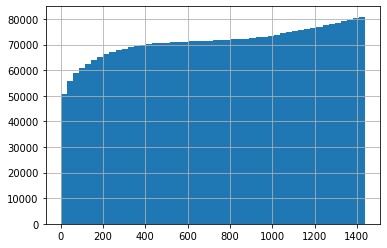

In [98]:
g = gaps.dropna().astype('timedelta64[m]')
gg = (g / pd.Timedelta(minutes = 1))
ggg = gg[((gg < 1440) & (gg > 0))]
ggg.describe()
ggg.hist(bins = 50, cumulative = True)

In [105]:
print(query.iloc[:, 4])

0                     NaT
1         0 days 00:00:08
2                     NaT
3                     NaT
4                     NaT
               ...       
26119    23 days 22:00:14
26120     0 days 00:00:27
26121     0 days 00:02:15
26122     0 days 00:00:03
26123     0 days 00:00:03
Name: gap, Length: 398501, dtype: object


In [ ]:
[]